In [217]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
#import time
import random

%matplotlib inline

для передачі картинки в нм нам необхідно оформити дескриптор, який витягуватиме фічі із зображення. скористаємось SIFT дескриптором з бібліотеки opencv

In [218]:
##################
def calc_SIFT(img):
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    sift = cv.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(img, None)
    
    return keypoints, descriptors

In [219]:
#витягнемо 6 класів зображень (5 людей та один рандомний), по 11-20 зображень в кожному
def prerare_data():
    x = []
    y = []
    for i in range(1, 7):
        tmp = []
        y_tmp = []
        for j in range(20):
            try:
                img = cv.imread(f'{i}/{j}.bmp')
                show_image(img)
                tmp.append(img)
                y_tmp.append(i)
            except: print(i, j)
        x.append(tmp)
        y.append(y_tmp)
    return x, y

In [220]:
def show_image(img):
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.show()

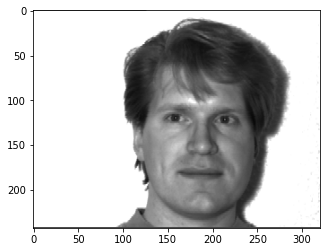

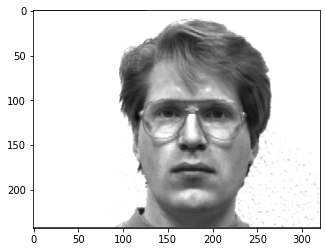

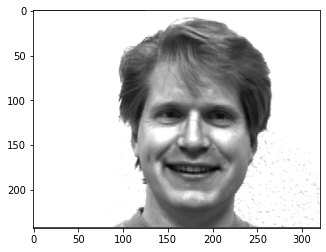

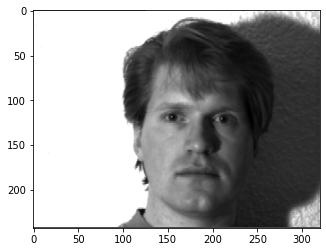

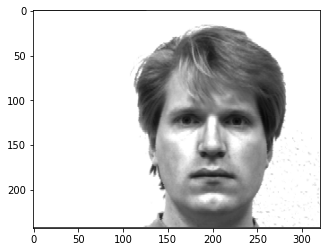

...

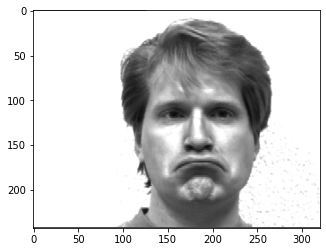

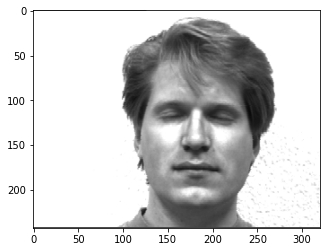

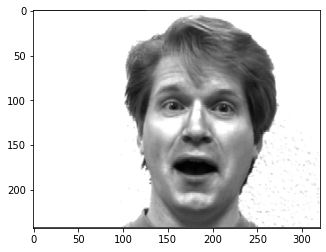

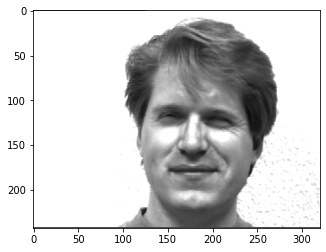

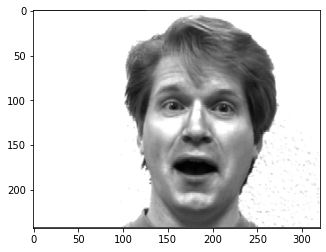

1 12
1 13
1 14
1 15
1 16
1 17
1 18
1 19


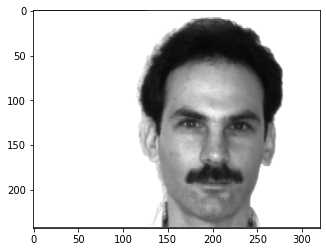

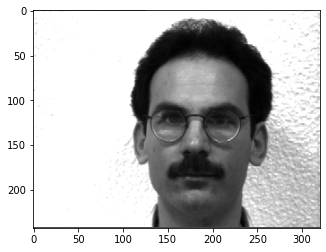

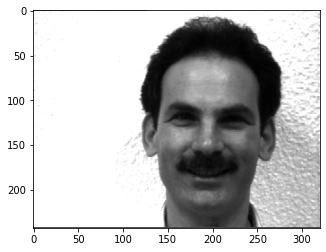

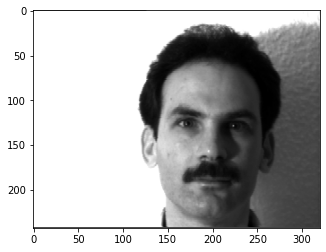

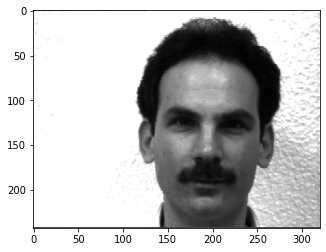

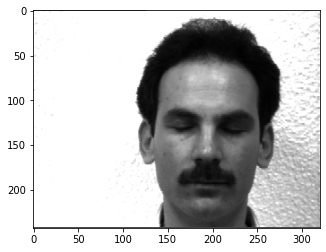

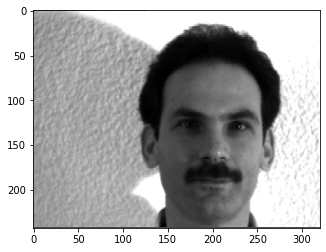

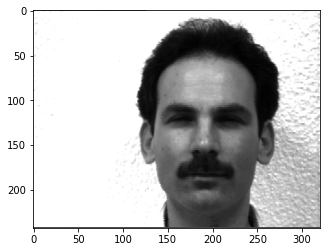

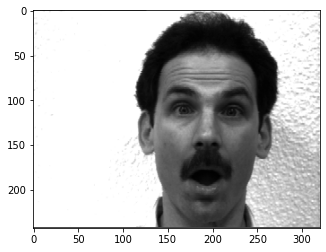

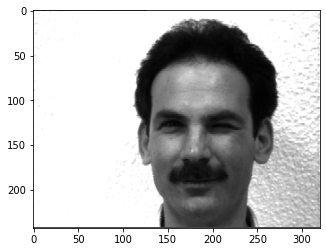

2 10
2 11
2 12
2 13
2 14
2 15
2 16
2 17
2 18
2 19


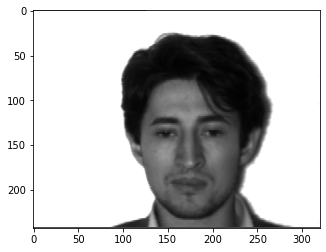

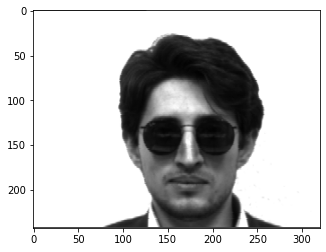

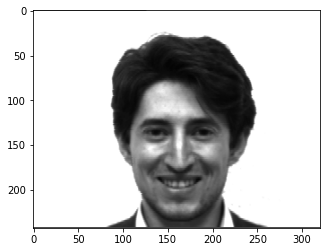

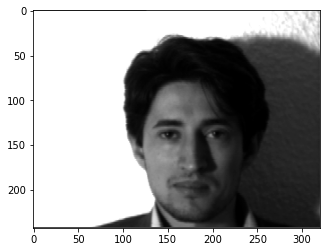

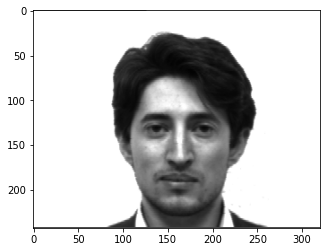

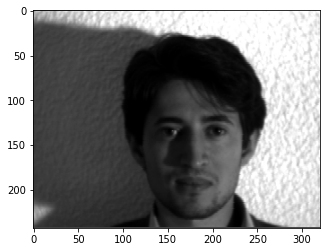

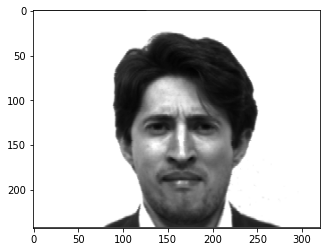

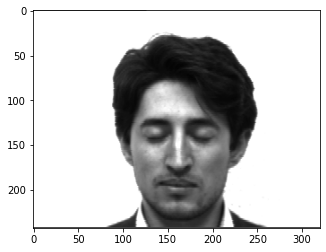

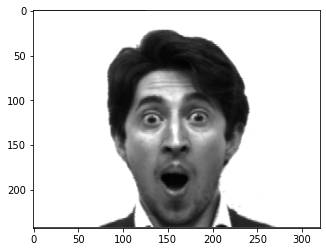

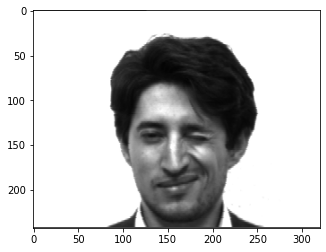

3 10
3 11
3 12
3 13
3 14
3 15
3 16
3 17
3 18
3 19


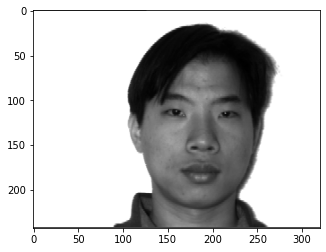

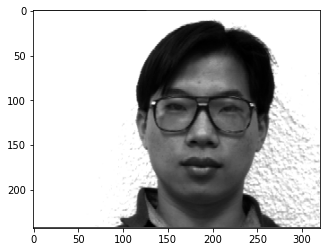

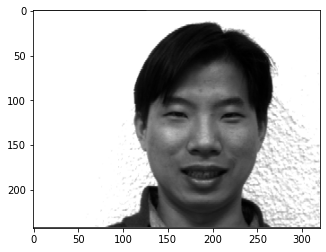

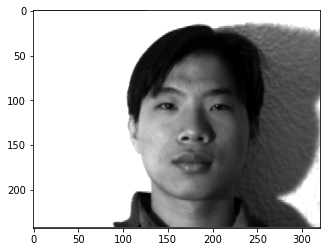

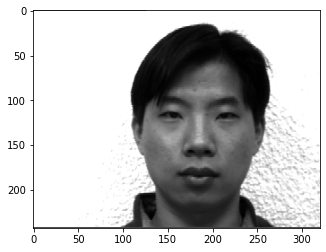

...

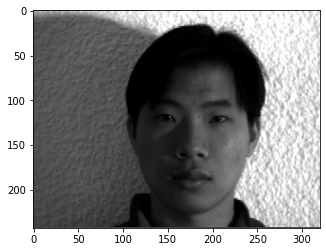

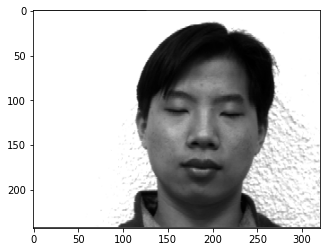

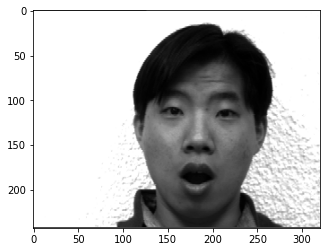

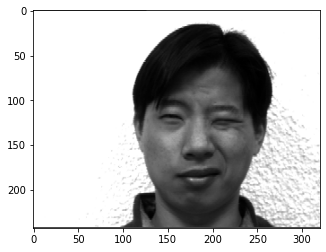

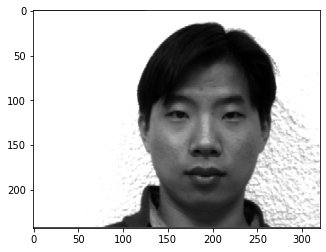

4 11
4 12
4 13
4 14
4 15
4 16
4 17
4 18
4 19


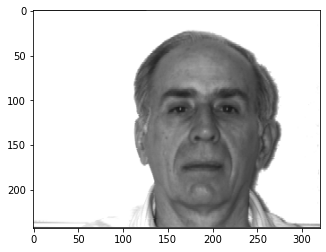

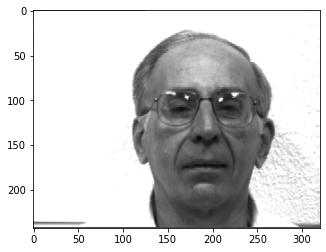

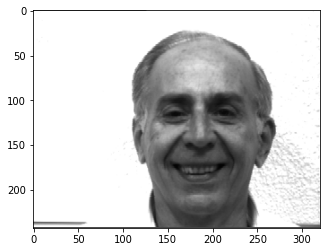

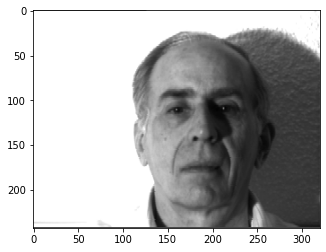

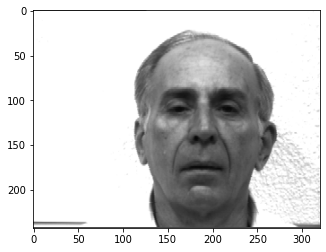

...

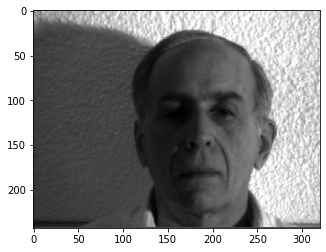

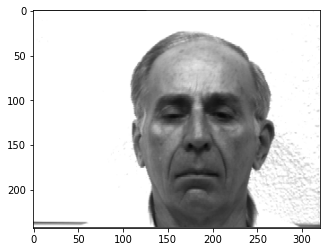

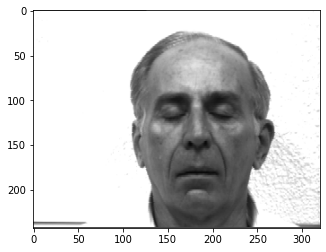

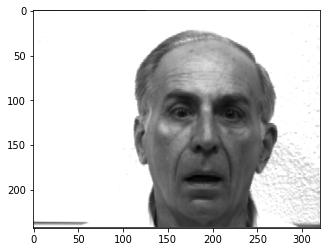

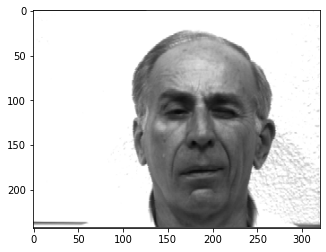

5 11
5 12
5 13
5 14
5 15
5 16
5 17
5 18
5 19


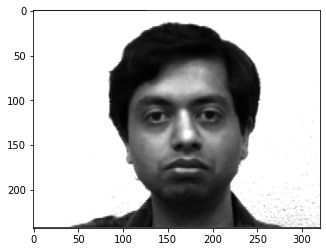

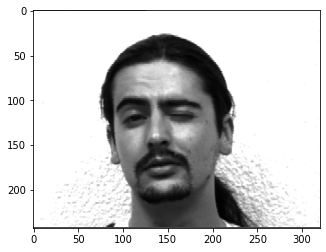

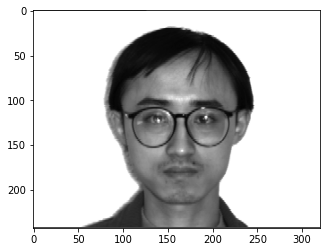

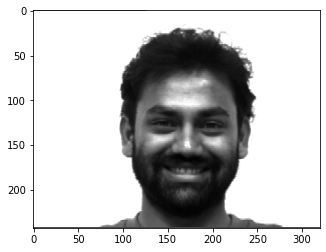

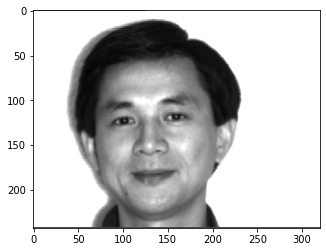

...

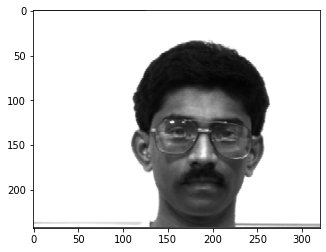

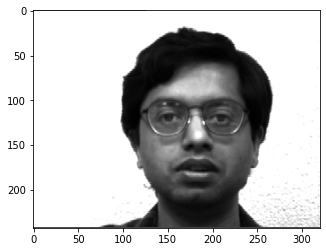

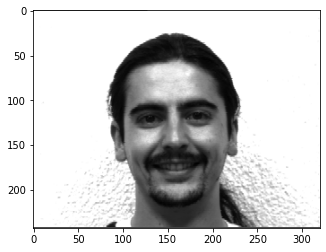

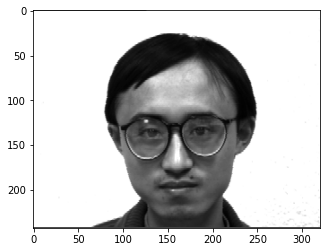

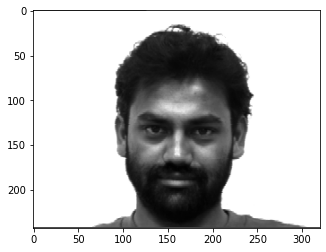

6 17
6 18
6 19


In [221]:
x, y = prerare_data()

Загальний датасет

In [222]:
#перемішаємо дані, та оформимо лейби для тренування
data = []
for i in x:
    data += i

y_data = []
for i in y:
    y_data += i
    
x_train, x_test, y_train, y_test = train_test_split(data, y_data, test_size=0.25, random_state=42)

In [223]:
#так як всі отримані дескриптори різної довжини, кластеризуємо їх методом Bag of Words
def fit_bag_of_words(data, callable_descriptor):
    all_descriptors = []
    for idx, current_image in enumerate(data):
        keypoints, descriptors = callable_descriptor(current_image)
        all_descriptors.extend(descriptors)
    
    # count of clusters
    k = 50
    kmeans = KMeans(n_clusters=k, verbose=False).fit(all_descriptors)
    
    return kmeans

In [224]:
k_means_train_sift = fit_bag_of_words(x_train, calc_SIFT)

In [225]:
def picture_to_vector(picture, k_means_pretrained, callable_descriptor, k_cluster=50):
    keypoints, descriptors = callable_descriptor(picture)
    histogram = np.zeros(k_cluster)
    kp_count = len(keypoints)
    
    for d in descriptors:
        idx = k_means_pretrained.predict([d])
        histogram[idx] += 1.0 / kp_count
        
    return histogram
    

In [226]:
#отримуєм дані які можна згодувати нейронці
x_train_vec_sift = np.array([picture_to_vector(pic, k_means_train_sift, calc_SIFT) for pic in x_train])
x_test_vec_sift = np.array([picture_to_vector(pic, k_means_train_sift, calc_SIFT) for pic in x_test])

In [227]:
#############################################################

In [228]:
#Переходимо до побудови персептрона

In [229]:
#абстрактний клас для шару нейронки
class Layer:
   
    def __init__(self):
        pass
    
    def forward(self, input):
        return input
    
    def backward(self, input, grad_output):
        num_units = input.shape[1]
        
        d_layer_d_input = np.eye(num_units)
        
        return np.dot(grad_output, d_layer_d_input) # chain rule

In [230]:
#нелінійний шар активації
class ReLU(Layer):
    def __init__(self):
        pass
    
    def forward(self, input):
        return (np.maximum(0, input))
    
    def backward(self, input, grad_output):
        relu_grad = input > 0
        return grad_output*relu_grad        

In [231]:
#лінійний шар
class Dense(Layer):
    def __init__(self, input_units, output_units, learning_rate=1):
        """
        f(x) = <W*x> + b
        """
        self.learning_rate = learning_rate
        
        self.weights = np.random.randn(input_units, output_units)*0.1
        self.biases = np.zeros(output_units)
        
    def forward(self,input):
        return np.dot(input, self.weights ) + self.biases #<your code here>
    
    def backward(self,input,grad_output):
        
        grad_input = np.dot(grad_output, self.weights.T)
        grad_weights = np.dot(input.T, grad_output)
        grad_biases = np.dot(np.ones(len(input[:, 0])), grad_output) 
        
        assert grad_weights.shape == self.weights.shape and grad_biases.shape == self.biases.shape
       
        old = self.weights
        self.weights = self.weights - self.learning_rate * grad_weights
        #print(old - self.weights)
        self.biases = self.biases - self.learning_rate * grad_biases
        
        return grad_input

In [232]:
#вираховуємо помилку передбаченого результату відносно лейби
def softmax_crossentropy_with_logits(logits,reference_answers):
    logits_for_answers = logits[np.arange(len(logits)),reference_answers]
    xentropy = - logits_for_answers + np.log(np.sum(np.exp(logits),axis=-1))
    return xentropy

def grad_softmax_crossentropy_with_logits(logits,reference_answers):
    ones_for_answers = np.zeros_like(logits)
    ones_for_answers[np.arange(len(logits)),reference_answers] = 1
    
    softmax = np.exp(logits) / np.exp(logits).sum(axis=-1,keepdims=True)
    
    return (- ones_for_answers + softmax) / logits.shape[0]

In [240]:
#власне двошаровий персептрон
network = []
network.append(Dense(x_test_vec_sift.shape[1],50))
network.append(ReLU())
network.append(Dense(50,7))

In [241]:
network[0].weights

array([[ 0.02875465,  0.10681509,  0.04352681, ...,  0.17364588,
        -0.15735139,  0.07224382],
       [-0.14963907,  0.1613002 ,  0.22042638, ..., -0.07320303,
         0.06080973,  0.02810464],
       [ 0.00941954,  0.21574406, -0.11982341, ..., -0.09662287,
        -0.12845226, -0.01977514],
       ...,
       [ 0.03570721,  0.00876523, -0.00922664, ..., -0.14329904,
        -0.05273873, -0.08873365],
       [ 0.05520255,  0.0458919 ,  0.01425928, ...,  0.05567108,
        -0.11138427, -0.02347632],
       [-0.16391906,  0.09656716,  0.33602313, ...,  0.05704256,
         0.21505232,  0.12035753]])

Теперь напишем функцию, которая делает предсказания на тестовой выборке, и считает accuracy, false-positive,
false-negative и время обработки тестового датасета.

In [242]:
#повертає список всіх output
def forward(network, X):
    activations = []
    input = X
    for nt in network:
        input = nt.forward(input)
        activations.append(input)
        
    assert len(activations) == len(network)
    return activations
#повертає останній output - передбачення
def predict(network,X):
    logits = forward(network,X)[-1]
    return logits.argmax(axis=-1)

#тренування- backpropagation
def train(network,X,y):
    layer_activations = forward(network,X)
    layer_inputs = [X]+layer_activations 
    logits = layer_activations[-1]
    
    loss = softmax_crossentropy_with_logits(logits,y)
    loss_grad = grad_softmax_crossentropy_with_logits(logits,y)
    
    for i in reversed(range(len(network))):
        loss_grad = network[i].backward(layer_inputs[i], loss_grad)
        
    return np.mean(loss)

In [243]:
#from IPython.display import clear_output
train_log = []
val_log = []

Epoch 0
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


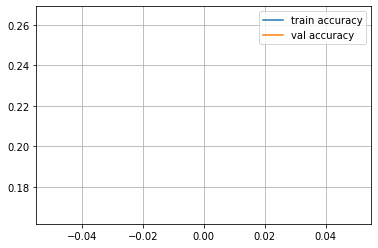

Epoch 1
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


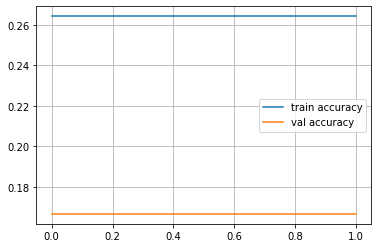

Epoch 2
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


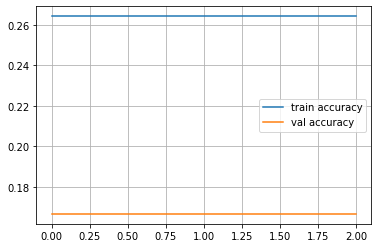

Epoch 3
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


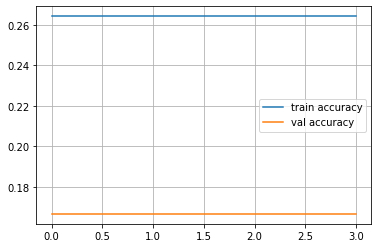

Epoch 4
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


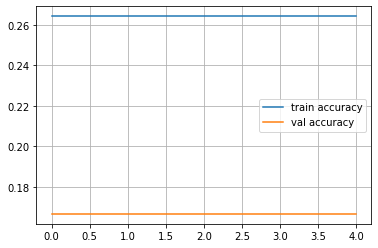

Epoch 5
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


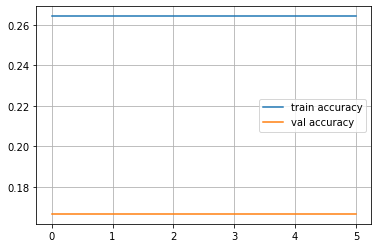

Epoch 6
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


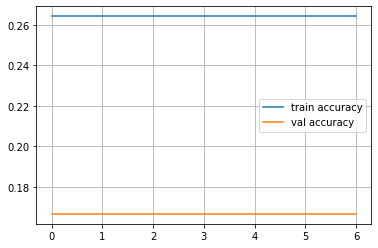

Epoch 7
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


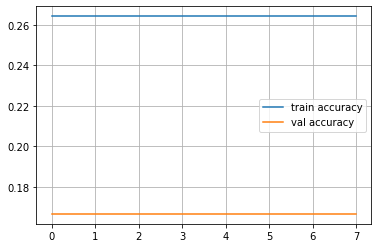

Epoch 8
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


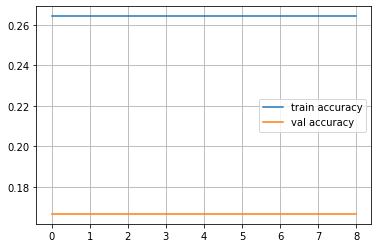

Epoch 9
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


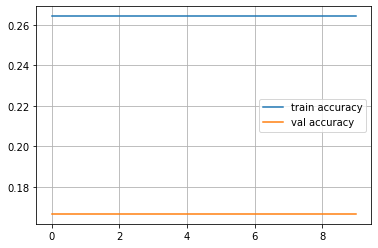

Epoch 10
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


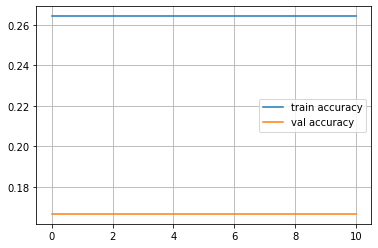

Epoch 11
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


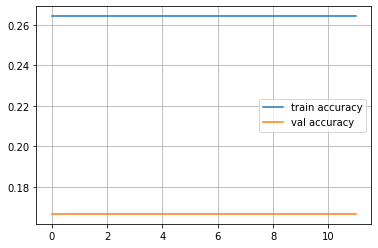

Epoch 12
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


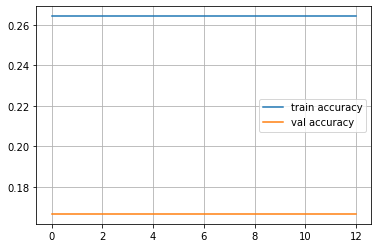

Epoch 13
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


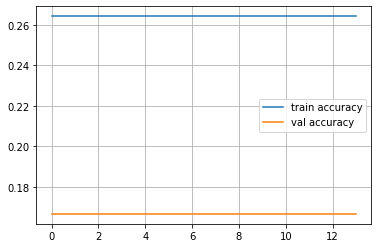

Epoch 14
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


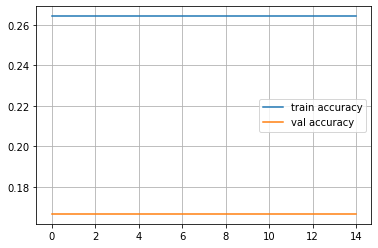

Epoch 15
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


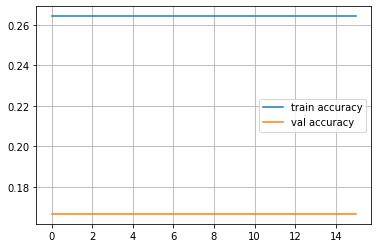

Epoch 16
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


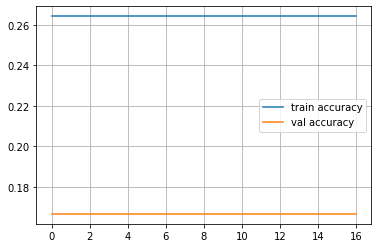

Epoch 17
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


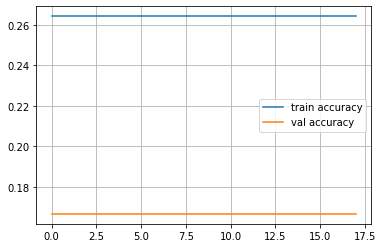

Epoch 18
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


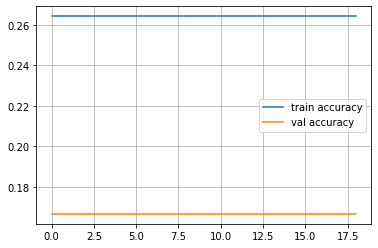

Epoch 19
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


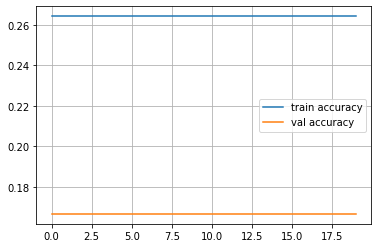

Epoch 20
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


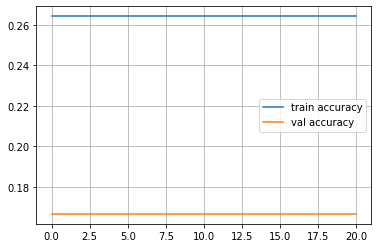

Epoch 21
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


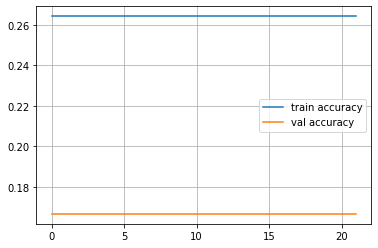

Epoch 22
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


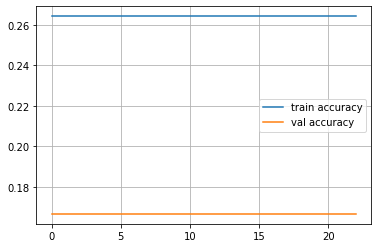

Epoch 23
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


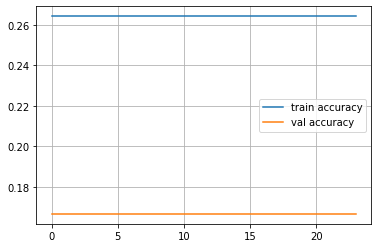

Epoch 24
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


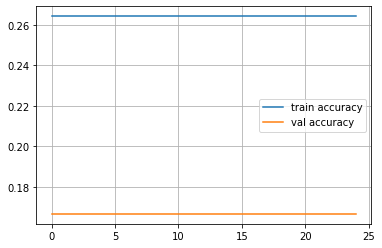

Epoch 25
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


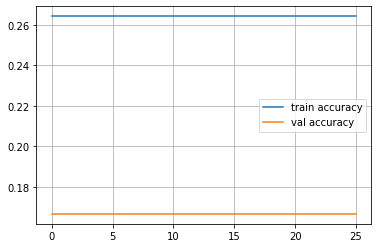

Epoch 26
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


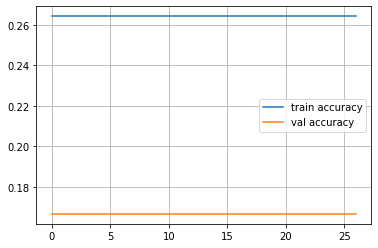

Epoch 27
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


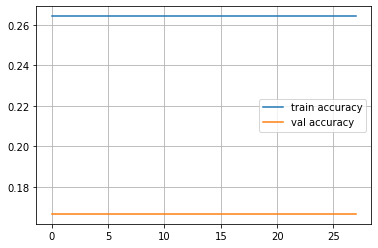

Epoch 28
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


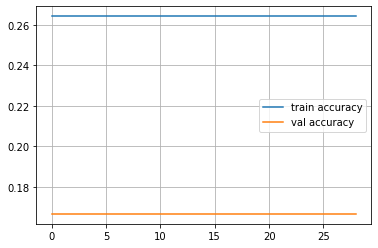

Epoch 29
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


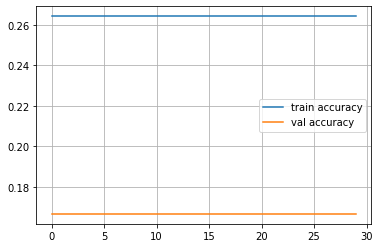

Epoch 30
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


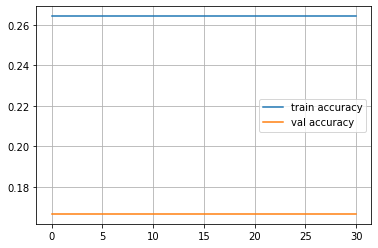

Epoch 31
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


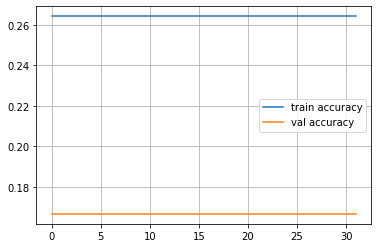

Epoch 32
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


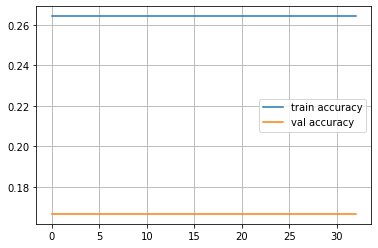

Epoch 33
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


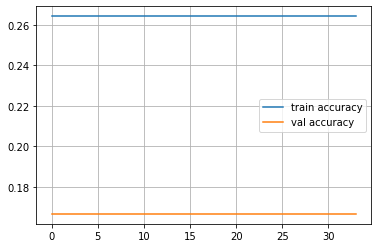

Epoch 34
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


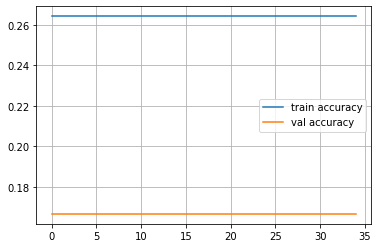

Epoch 35
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


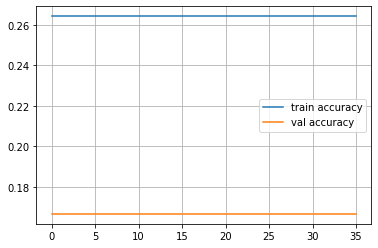

Epoch 36
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


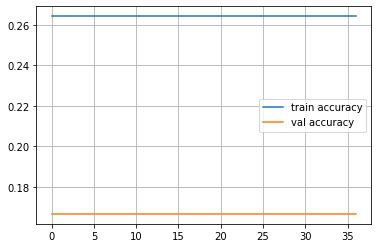

Epoch 37
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


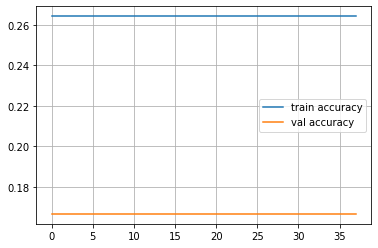

Epoch 38
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


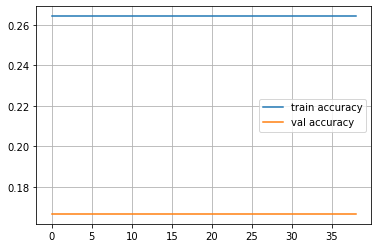

Epoch 39
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


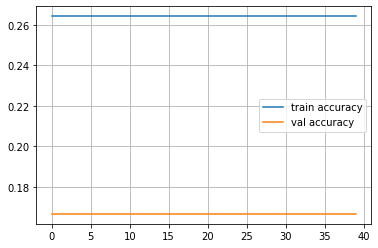

Epoch 40
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


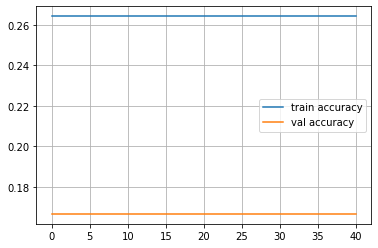

Epoch 41
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


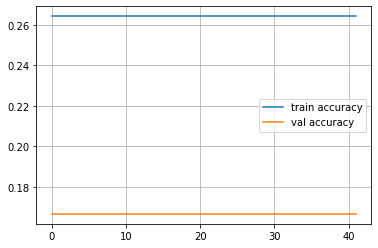

Epoch 42
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


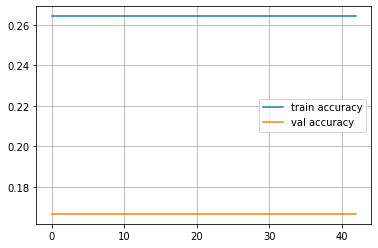

Epoch 43
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


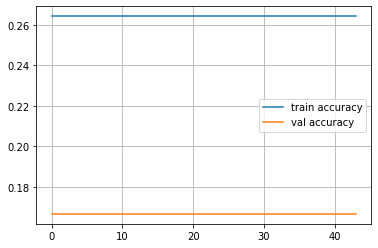

Epoch 44
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


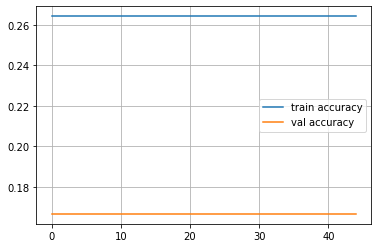

Epoch 45
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


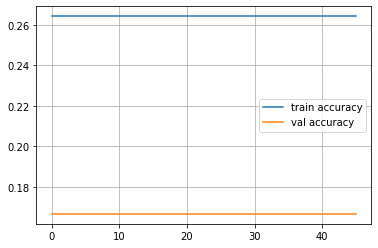

Epoch 46
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


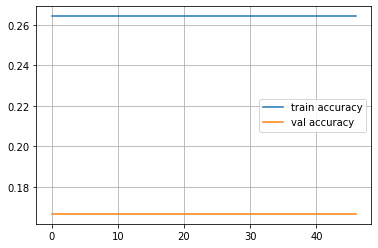

Epoch 47
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


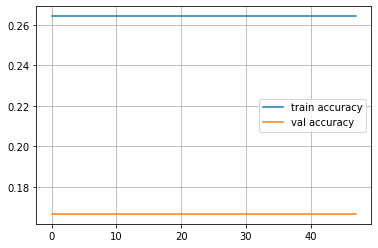

Epoch 48
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


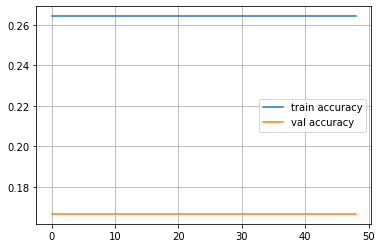

Epoch 49
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


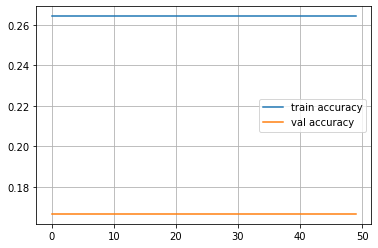

Epoch 50
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


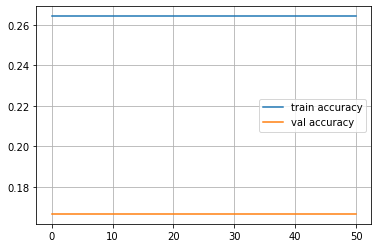

Epoch 51
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


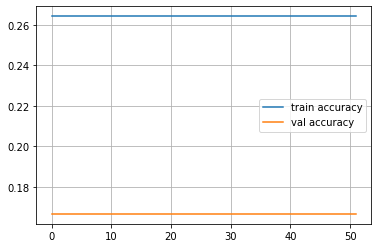

Epoch 52
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


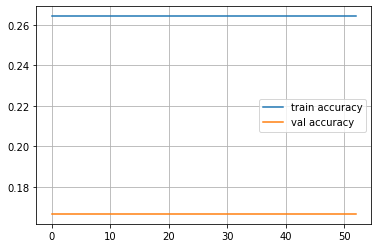

Epoch 53
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


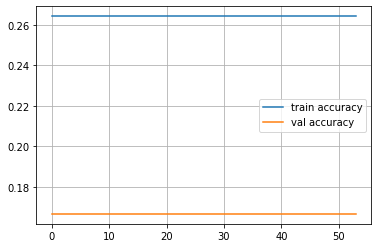

Epoch 54
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


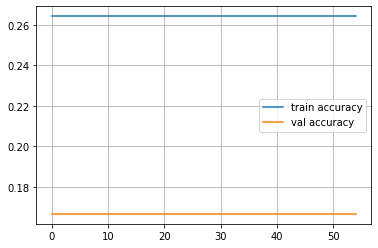

Epoch 55
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


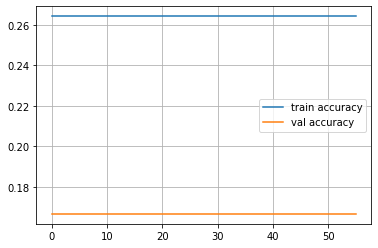

Epoch 56
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


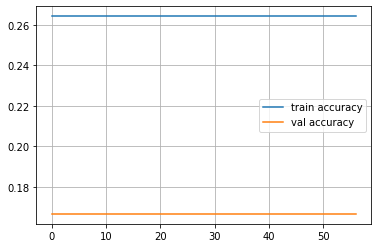

Epoch 57
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


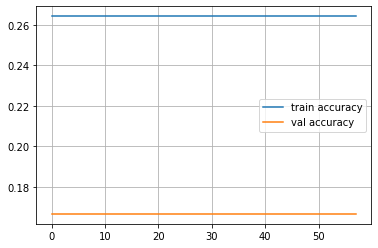

Epoch 58
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


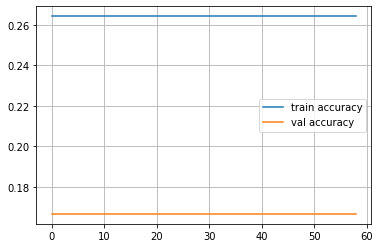

Epoch 59
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


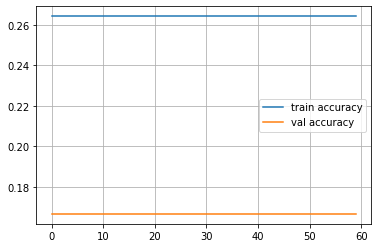

Epoch 60
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


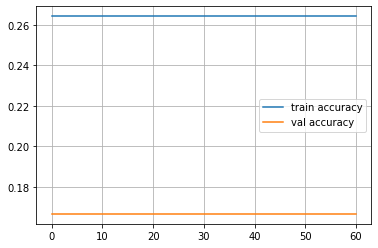

Epoch 61
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


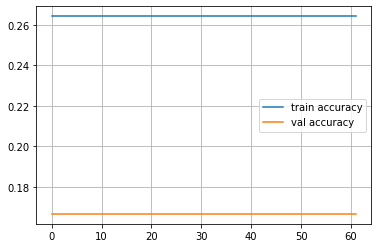

Epoch 62
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


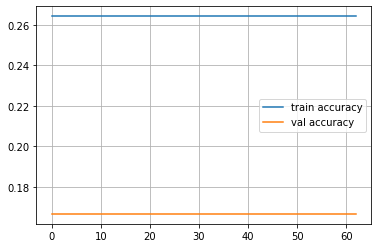

Epoch 63
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


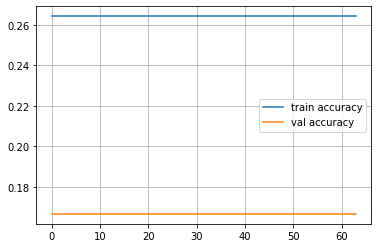

Epoch 64
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


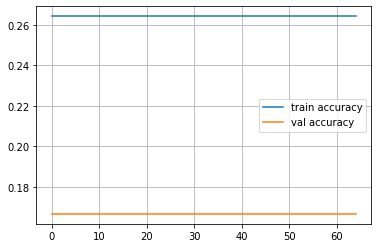

Epoch 65
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


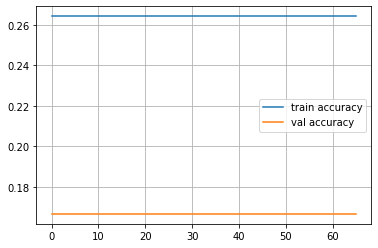

Epoch 66
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


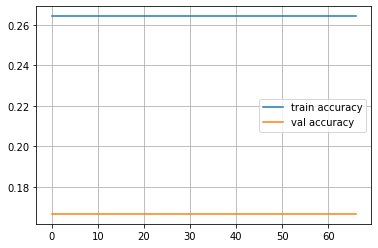

Epoch 67
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


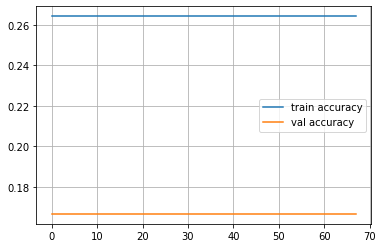

Epoch 68
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


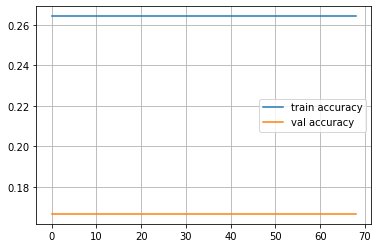

Epoch 69
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


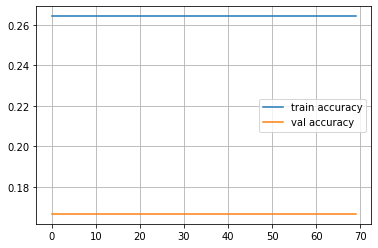

Epoch 70
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


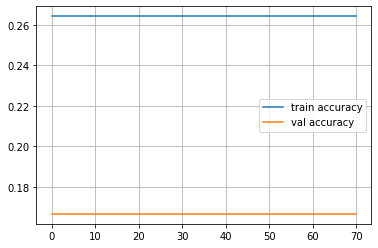

Epoch 71
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


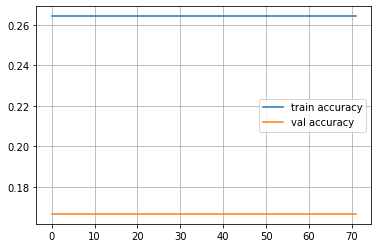

Epoch 72
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


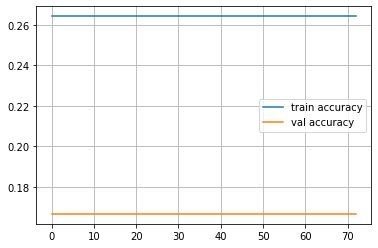

Epoch 73
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


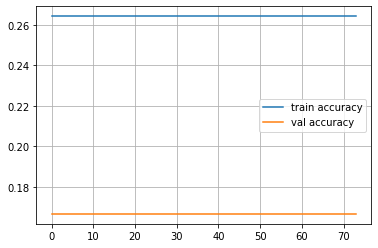

Epoch 74
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


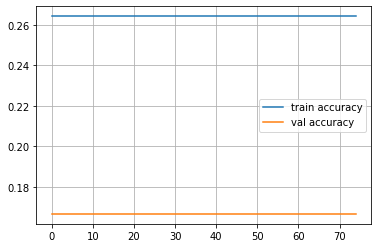

Epoch 75
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


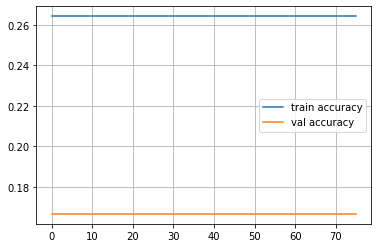

Epoch 76
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


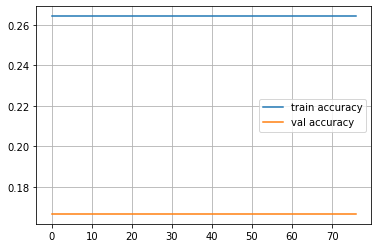

Epoch 77
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


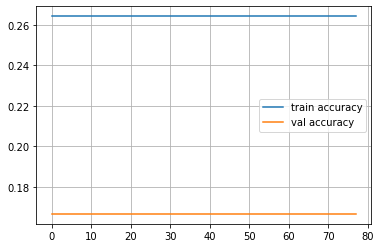

Epoch 78
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


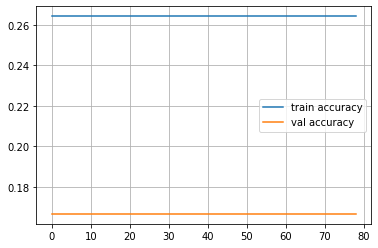

Epoch 79
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


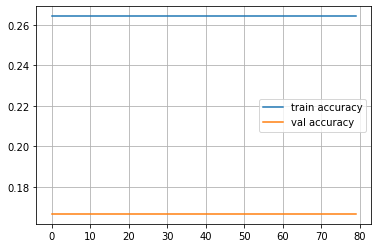

Epoch 80
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


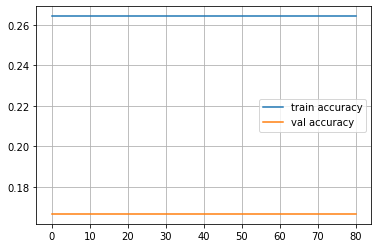

Epoch 81
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


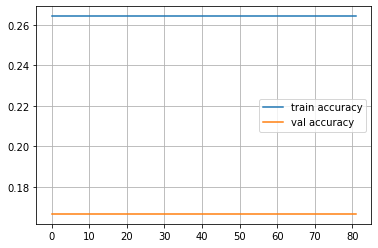

Epoch 82
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


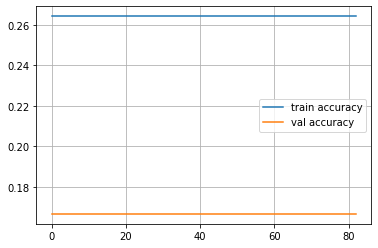

Epoch 83
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


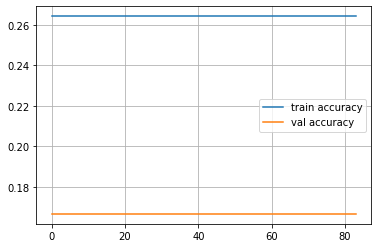

Epoch 84
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


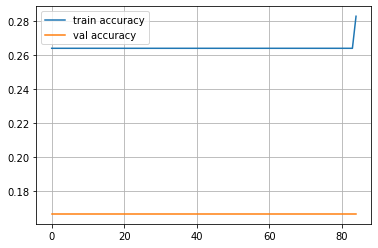

Epoch 85
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


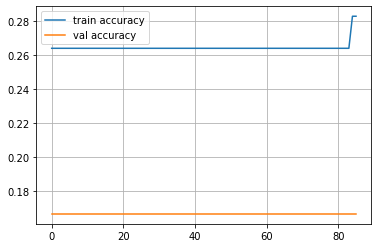

Epoch 86
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


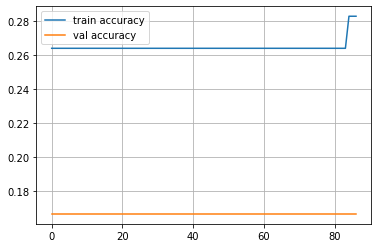

Epoch 87
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


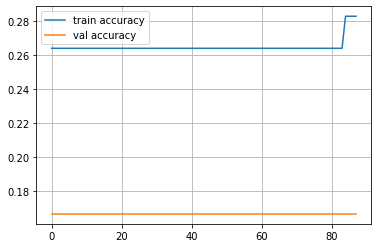

Epoch 88
Train accuracy: 0.2830188679245283
Val accuracy: 0.1111111111111111


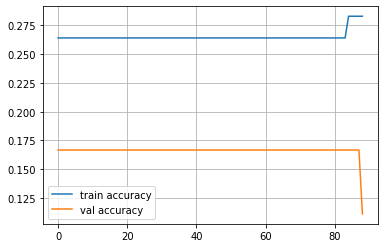

Epoch 89
Train accuracy: 0.2830188679245283
Val accuracy: 0.1111111111111111


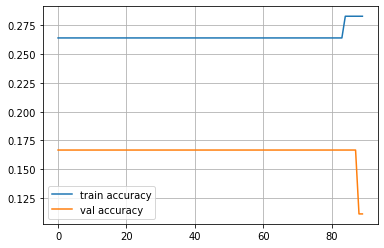

Epoch 90
Train accuracy: 0.2830188679245283
Val accuracy: 0.1111111111111111


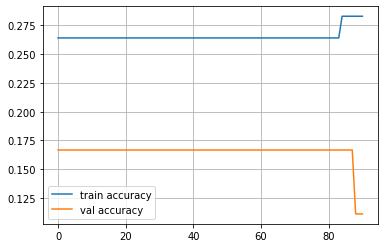

Epoch 91
Train accuracy: 0.2830188679245283
Val accuracy: 0.1111111111111111


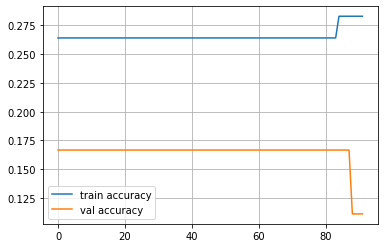

Epoch 92
Train accuracy: 0.3018867924528302
Val accuracy: 0.1111111111111111


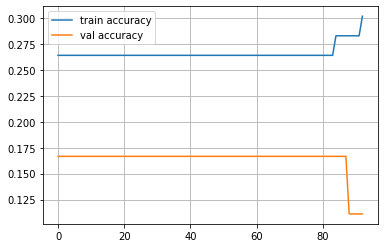

Epoch 93
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


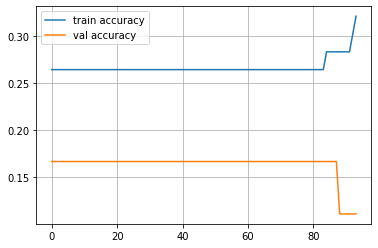

Epoch 94
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


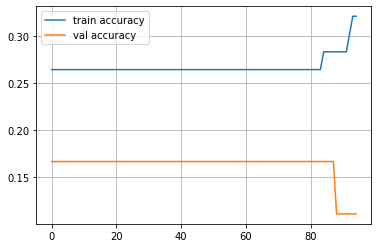

Epoch 95
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


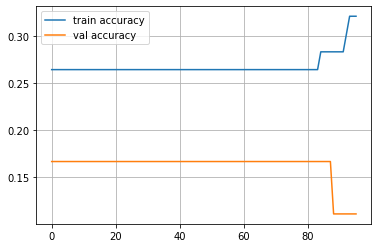

Epoch 96
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


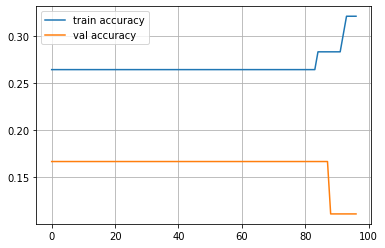

Epoch 97
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


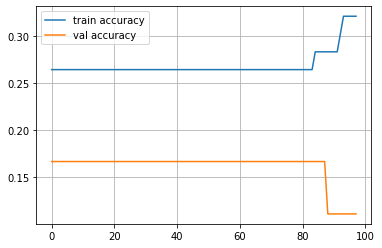

Epoch 98
Train accuracy: 0.33962264150943394
Val accuracy: 0.1111111111111111


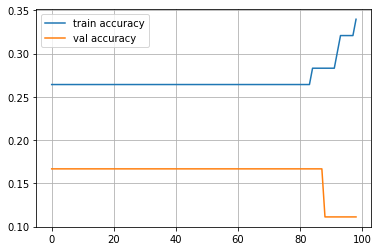

Epoch 99
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


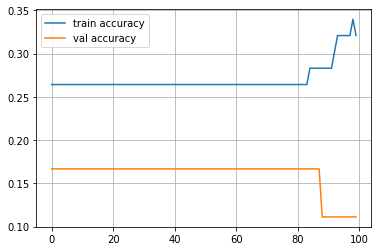

Epoch 100
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


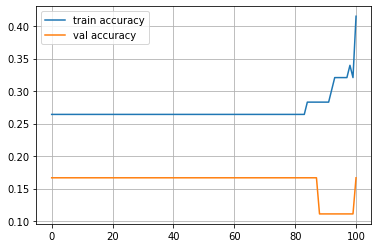

Epoch 101
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


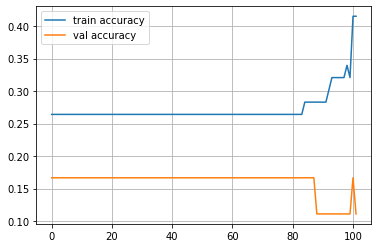

Epoch 102
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


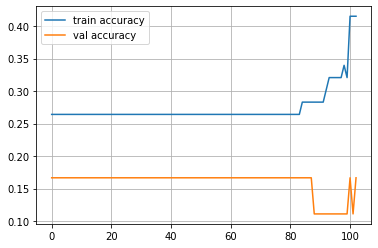

Epoch 103
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


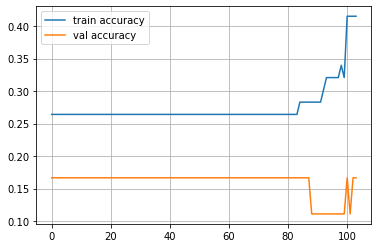

Epoch 104
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


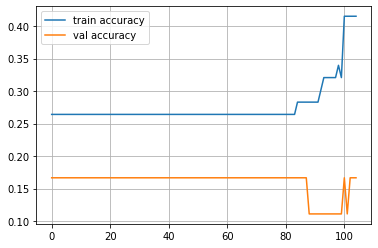

Epoch 105
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


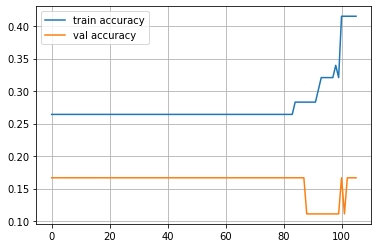

Epoch 106
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


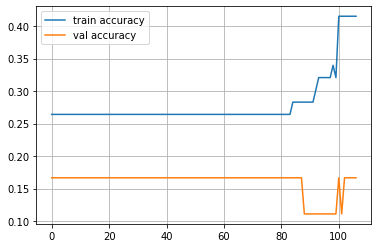

Epoch 107
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


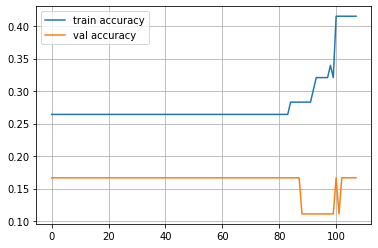

Epoch 108
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


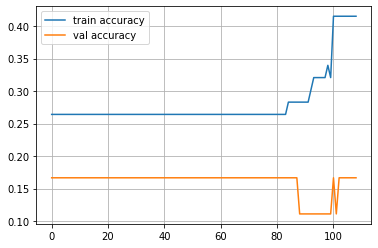

Epoch 109
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


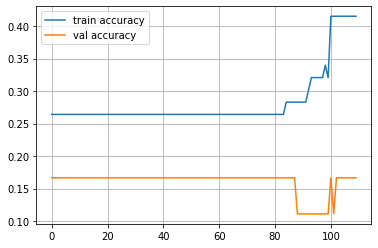

Epoch 110
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


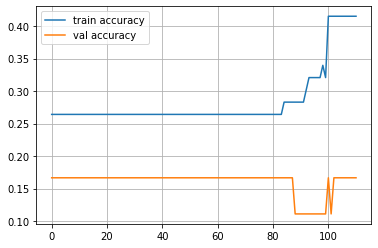

Epoch 111
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


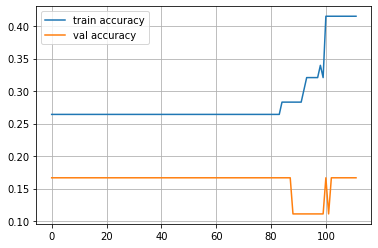

Epoch 112
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


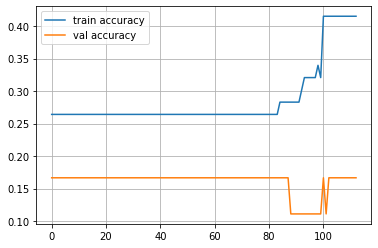

Epoch 113
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


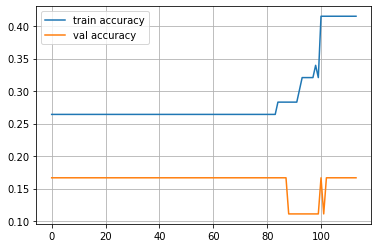

Epoch 114
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


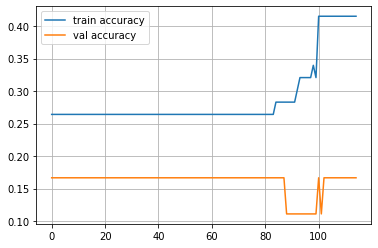

Epoch 115
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


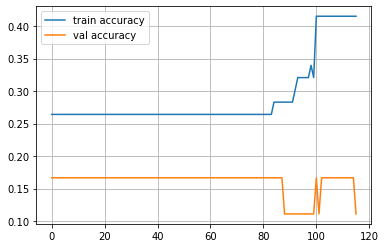

Epoch 116
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


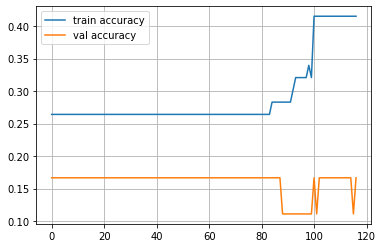

Epoch 117
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


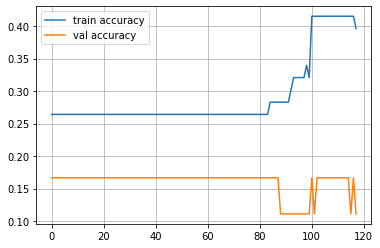

Epoch 118
Train accuracy: 0.32075471698113206
Val accuracy: 0.1111111111111111


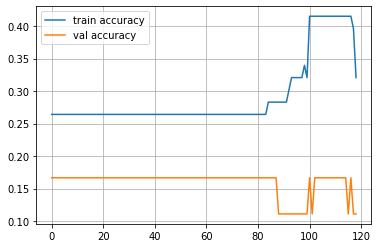

Epoch 119
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


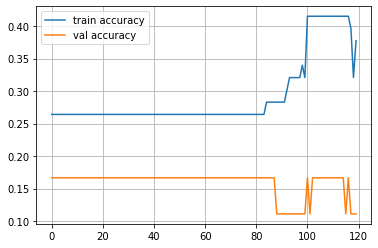

Epoch 120
Train accuracy: 0.2830188679245283
Val accuracy: 0.1111111111111111


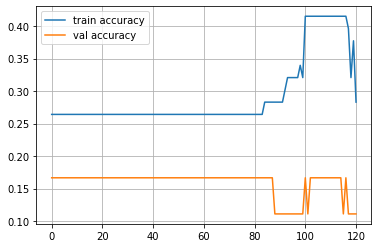

Epoch 121
Train accuracy: 0.33962264150943394
Val accuracy: 0.1111111111111111


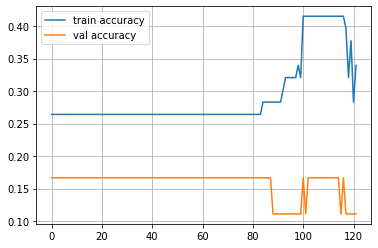

Epoch 122
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


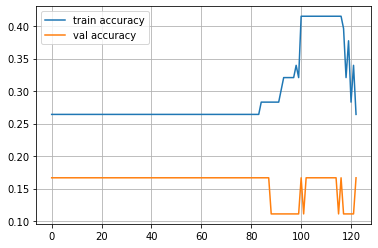

Epoch 123
Train accuracy: 0.2641509433962264
Val accuracy: 0.1111111111111111


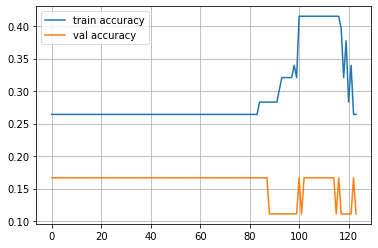

Epoch 124
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


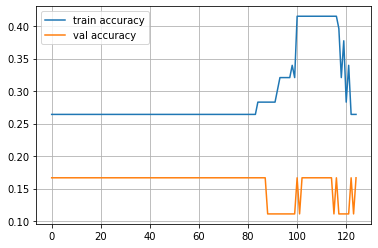

Epoch 125
Train accuracy: 0.18867924528301888
Val accuracy: 0.1111111111111111


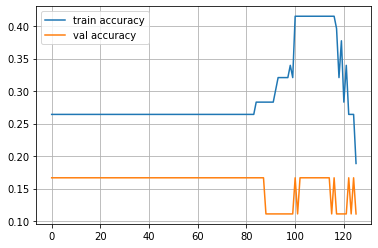

Epoch 126
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


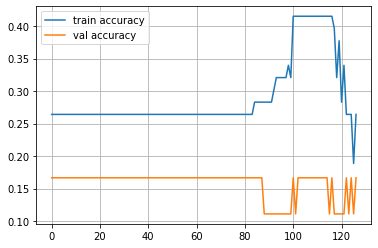

Epoch 127
Train accuracy: 0.22641509433962265
Val accuracy: 0.16666666666666666


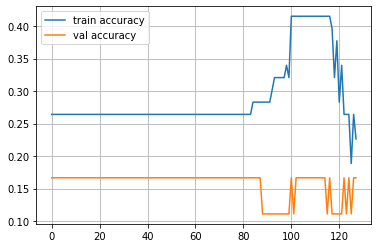

Epoch 128
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


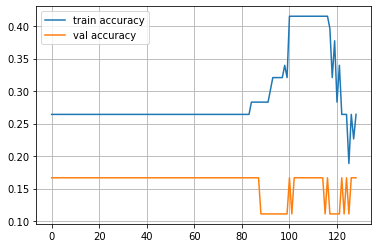

Epoch 129
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


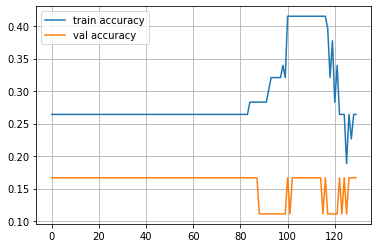

Epoch 130
Train accuracy: 0.2641509433962264
Val accuracy: 0.16666666666666666


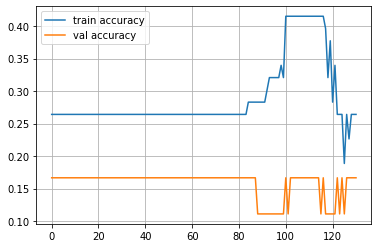

Epoch 131
Train accuracy: 0.32075471698113206
Val accuracy: 0.2222222222222222


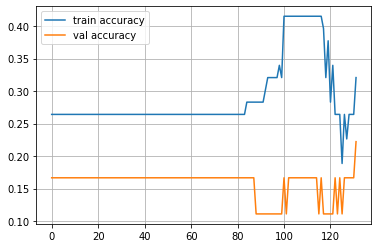

Epoch 132
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


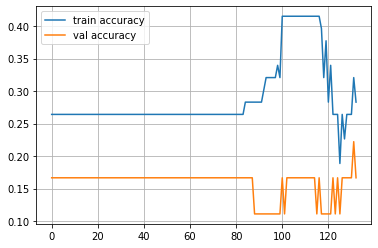

Epoch 133
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


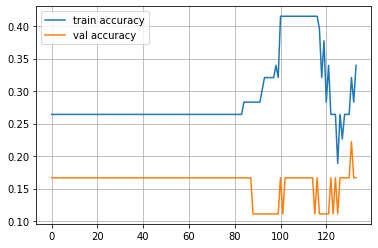

Epoch 134
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


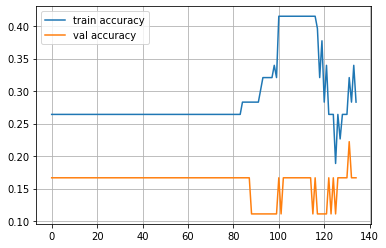

Epoch 135
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


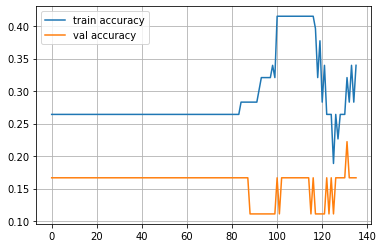

Epoch 136
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


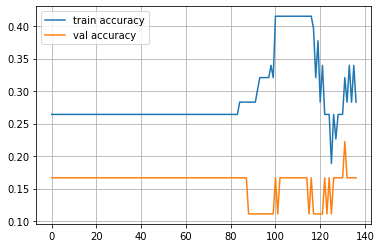

Epoch 137
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


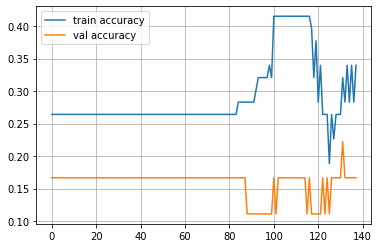

Epoch 138
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


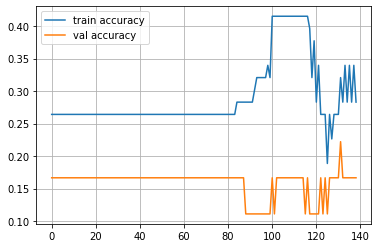

Epoch 139
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


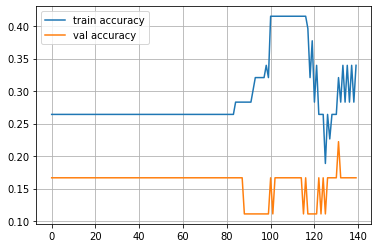

Epoch 140
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


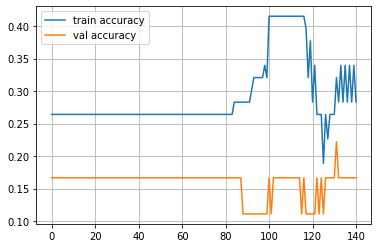

Epoch 141
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


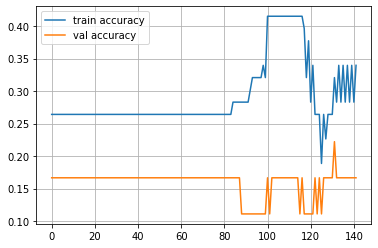

Epoch 142
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


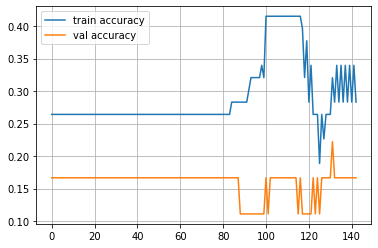

Epoch 143
Train accuracy: 0.33962264150943394
Val accuracy: 0.2222222222222222


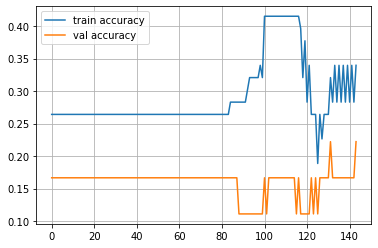

Epoch 144
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


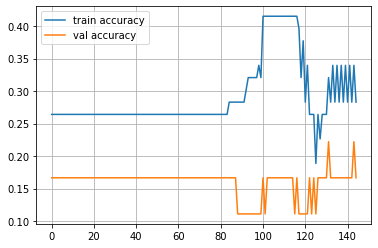

Epoch 145
Train accuracy: 0.32075471698113206
Val accuracy: 0.2222222222222222


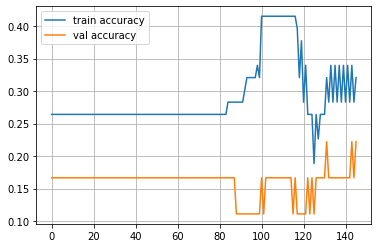

Epoch 146
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


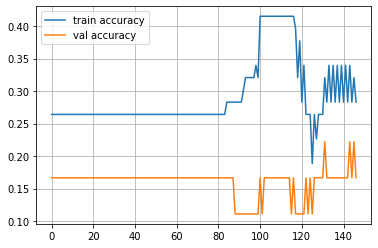

Epoch 147
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


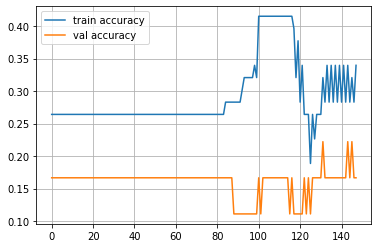

Epoch 148
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


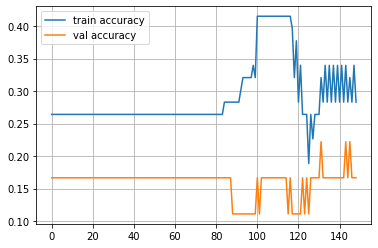

Epoch 149
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


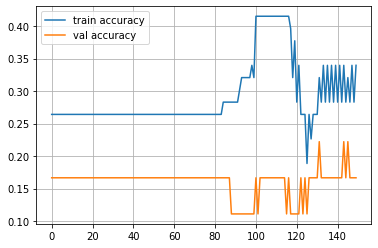

Epoch 150
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


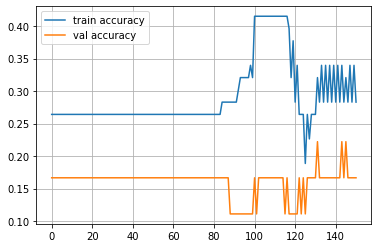

Epoch 151
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


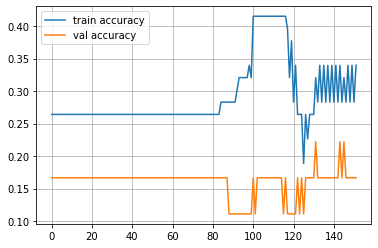

Epoch 152
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


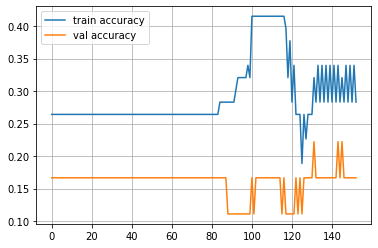

Epoch 153
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


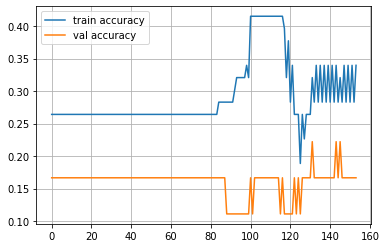

Epoch 154
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


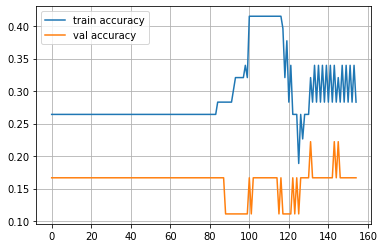

Epoch 155
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


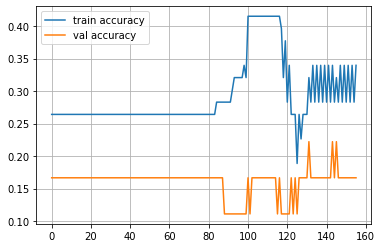

Epoch 156
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


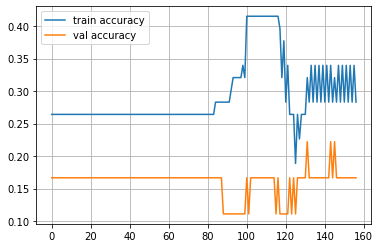

Epoch 157
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


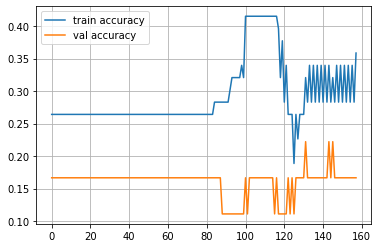

Epoch 158
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


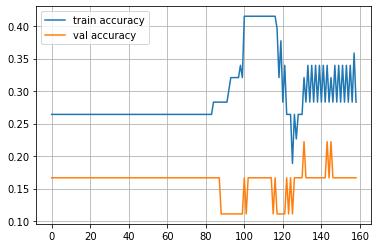

Epoch 159
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


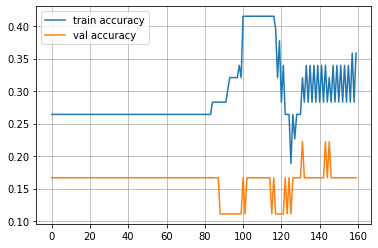

Epoch 160
Train accuracy: 0.2830188679245283
Val accuracy: 0.2222222222222222


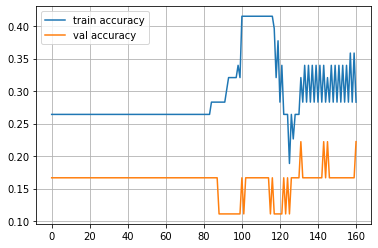

Epoch 161
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


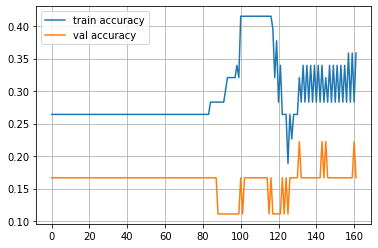

Epoch 162
Train accuracy: 0.2830188679245283
Val accuracy: 0.2222222222222222


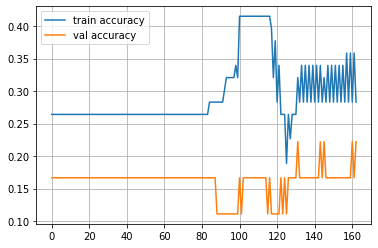

Epoch 163
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


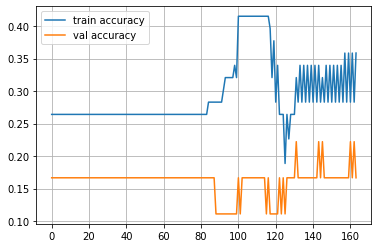

Epoch 164
Train accuracy: 0.2830188679245283
Val accuracy: 0.2222222222222222


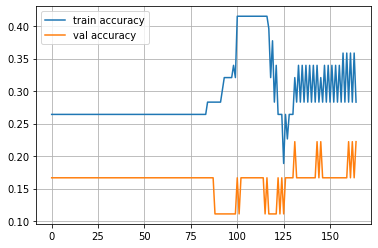

Epoch 165
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


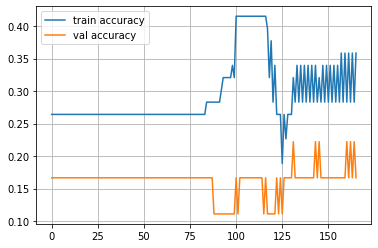

Epoch 166
Train accuracy: 0.2830188679245283
Val accuracy: 0.2222222222222222


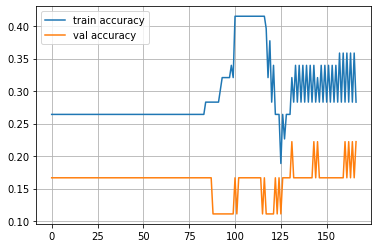

Epoch 167
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


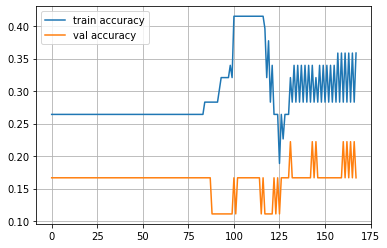

Epoch 168
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


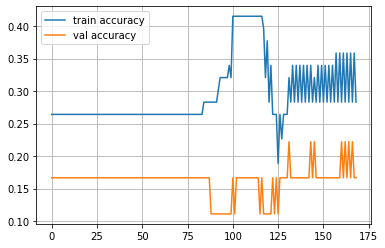

Epoch 169
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


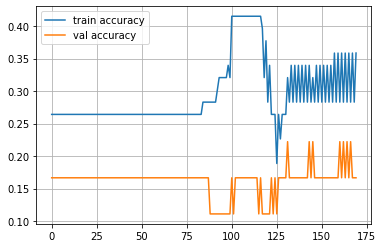

Epoch 170
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


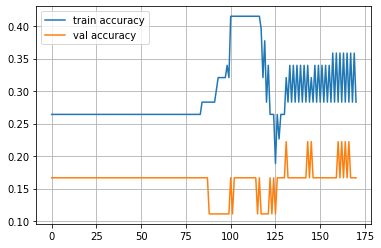

Epoch 171
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


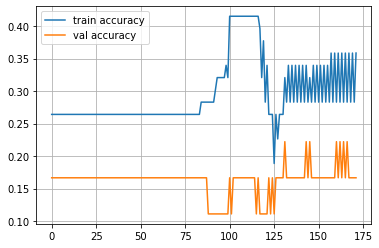

Epoch 172
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


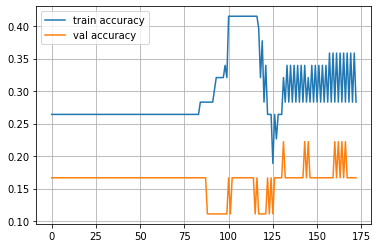

Epoch 173
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


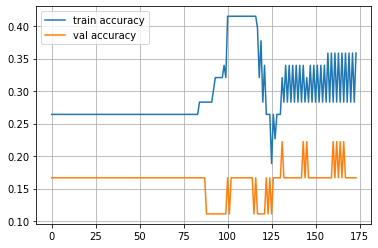

Epoch 174
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


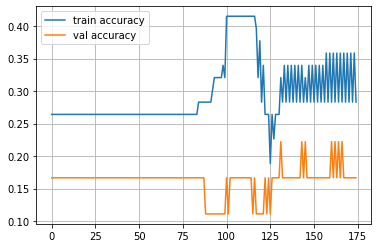

Epoch 175
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


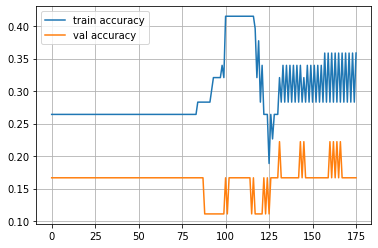

Epoch 176
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


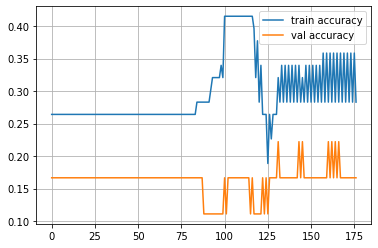

Epoch 177
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


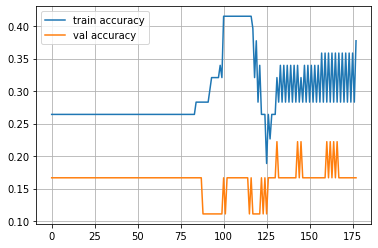

Epoch 178
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


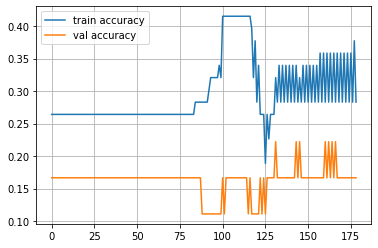

Epoch 179
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


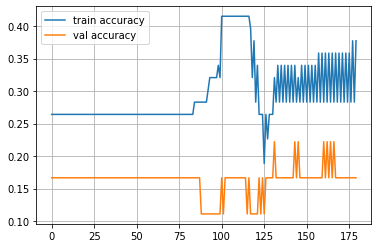

Epoch 180
Train accuracy: 0.2830188679245283
Val accuracy: 0.16666666666666666


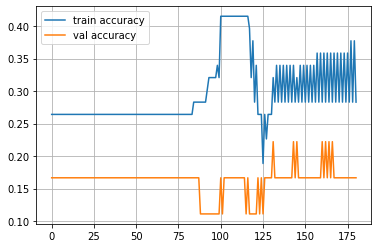

Epoch 181
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


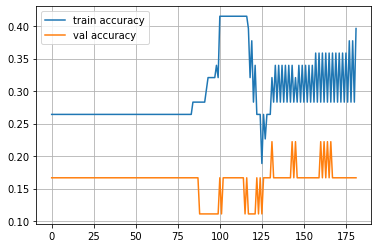

Epoch 182
Train accuracy: 0.3018867924528302
Val accuracy: 0.16666666666666666


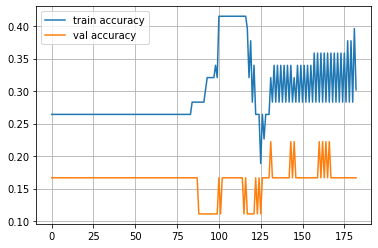

Epoch 183
Train accuracy: 0.4339622641509434
Val accuracy: 0.16666666666666666


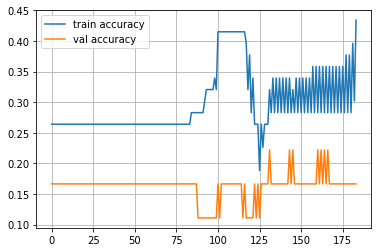

Epoch 184
Train accuracy: 0.3018867924528302
Val accuracy: 0.16666666666666666


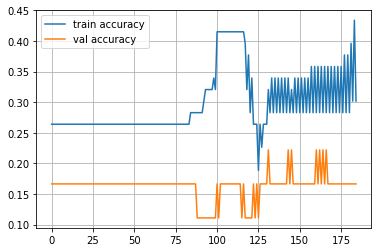

Epoch 185
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


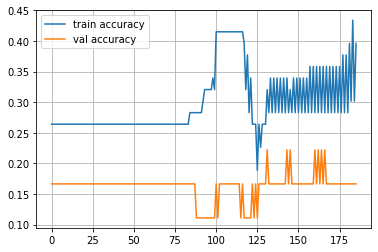

Epoch 186
Train accuracy: 0.32075471698113206
Val accuracy: 0.16666666666666666


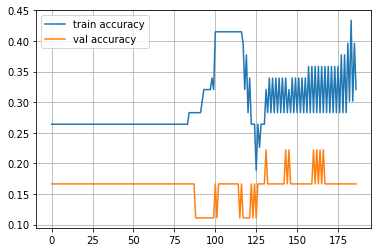

Epoch 187
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


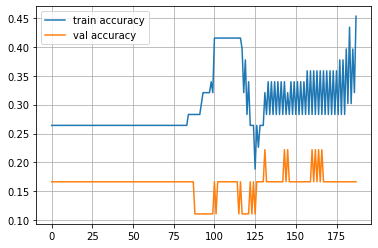

Epoch 188
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


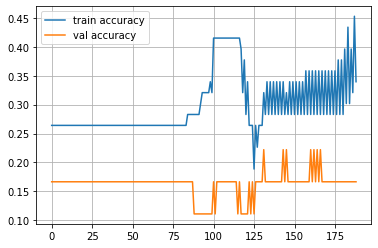

Epoch 189
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


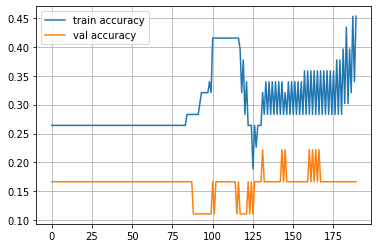

Epoch 190
Train accuracy: 0.33962264150943394
Val accuracy: 0.16666666666666666


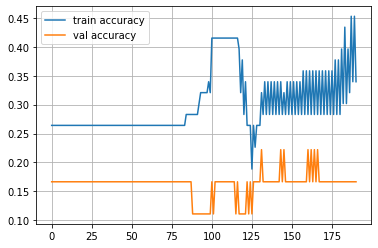

Epoch 191
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


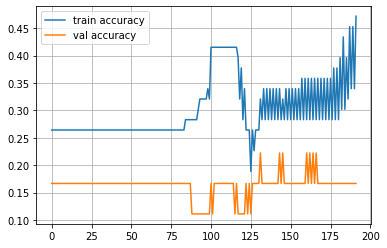

Epoch 192
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


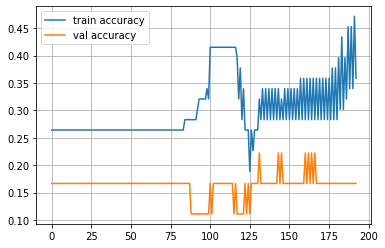

Epoch 193
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


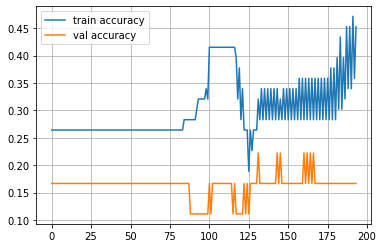

Epoch 194
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


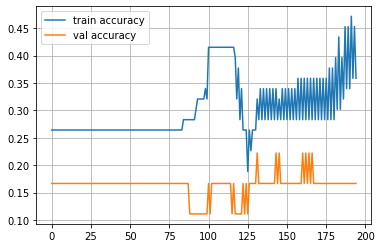

Epoch 195
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


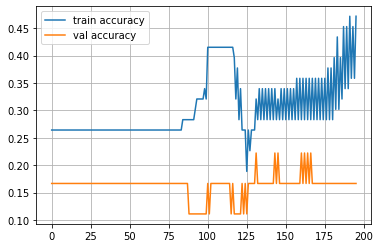

Epoch 196
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


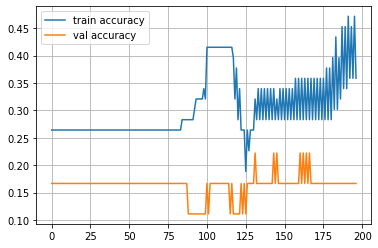

Epoch 197
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


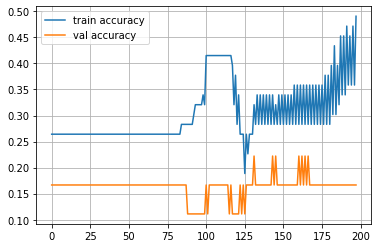

Epoch 198
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


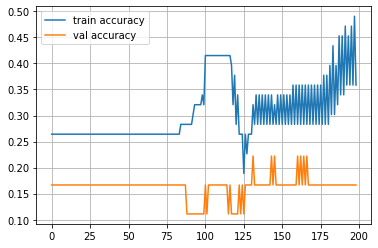

Epoch 199
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


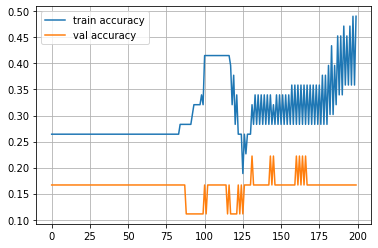

Epoch 200
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


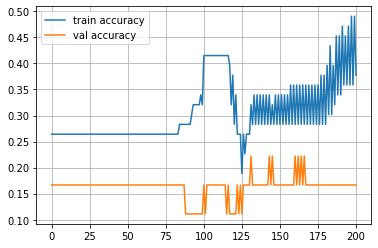

Epoch 201
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


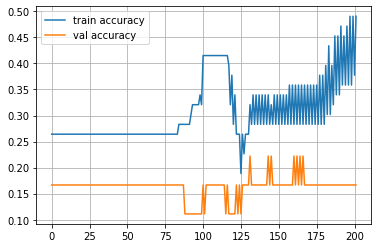

Epoch 202
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


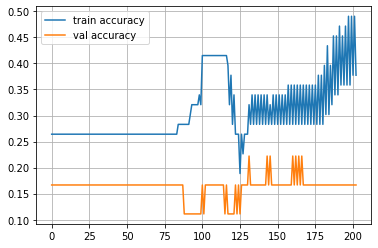

Epoch 203
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


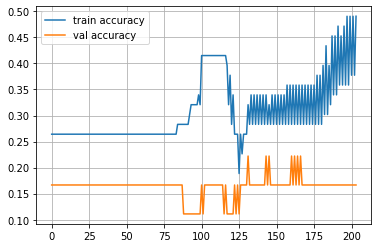

Epoch 204
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


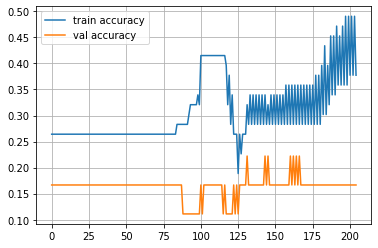

Epoch 205
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


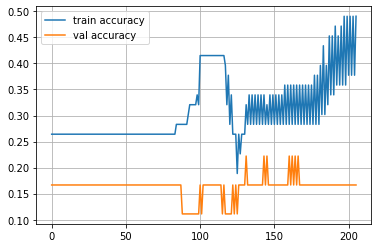

Epoch 206
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


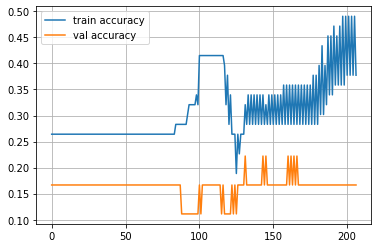

Epoch 207
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


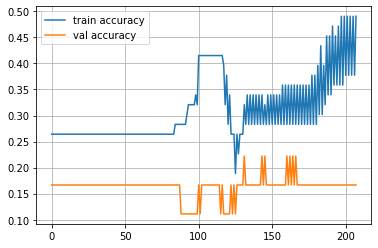

Epoch 208
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


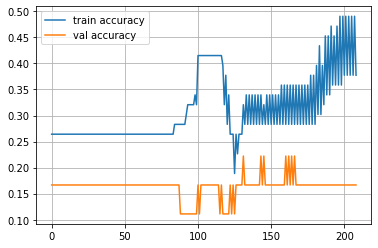

Epoch 209
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


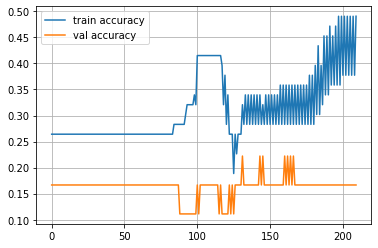

Epoch 210
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


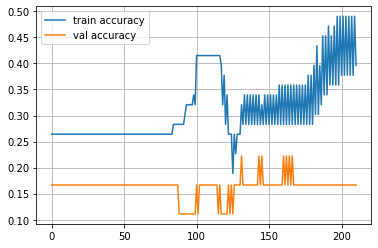

Epoch 211
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


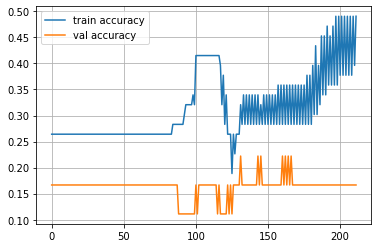

Epoch 212
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


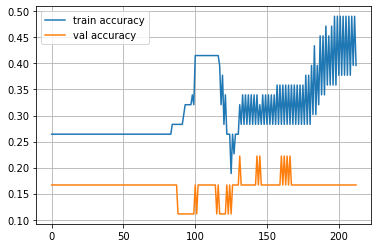

Epoch 213
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


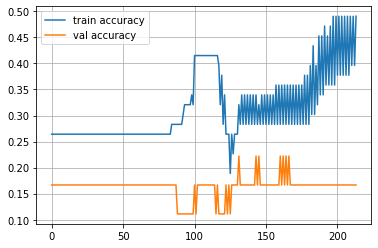

Epoch 214
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


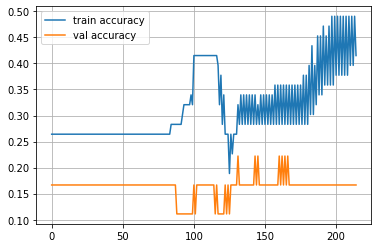

Epoch 215
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


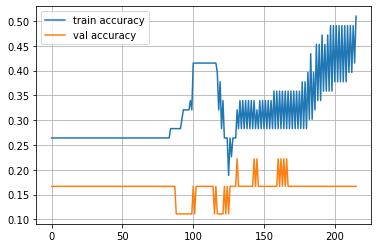

Epoch 216
Train accuracy: 0.4339622641509434
Val accuracy: 0.16666666666666666


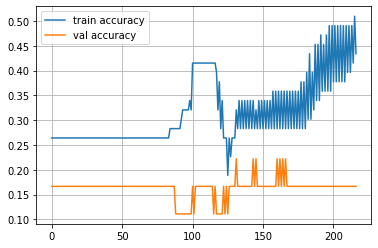

Epoch 217
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


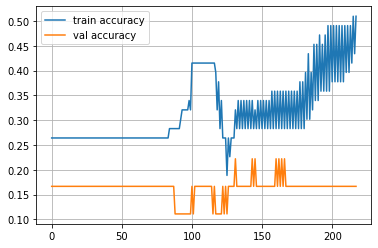

Epoch 218
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


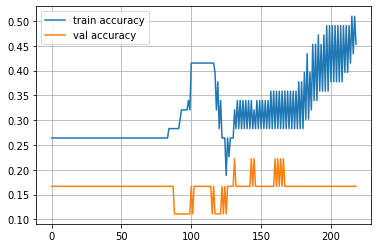

Epoch 219
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


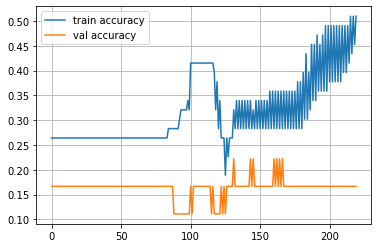

Epoch 220
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


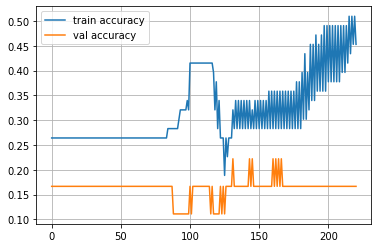

Epoch 221
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


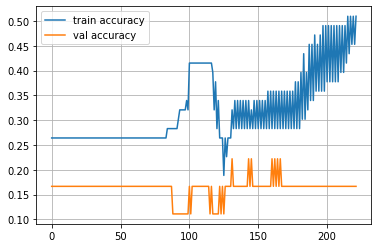

Epoch 222
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


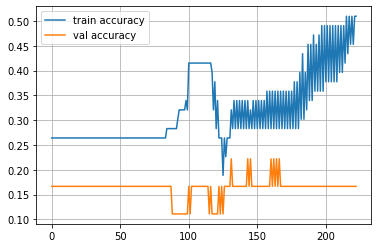

Epoch 223
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


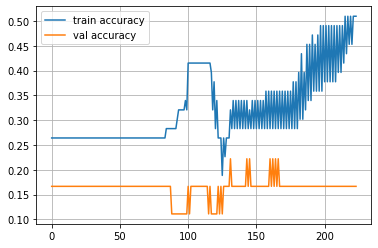

Epoch 224
Train accuracy: 0.4339622641509434
Val accuracy: 0.16666666666666666


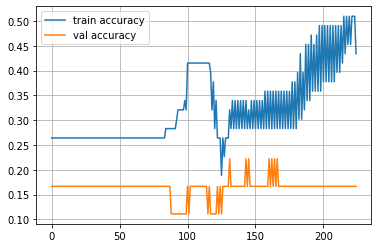

Epoch 225
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


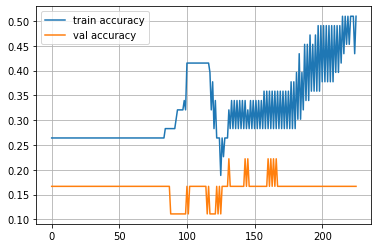

Epoch 226
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


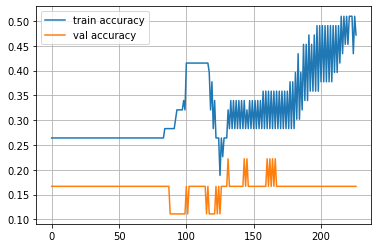

Epoch 227
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


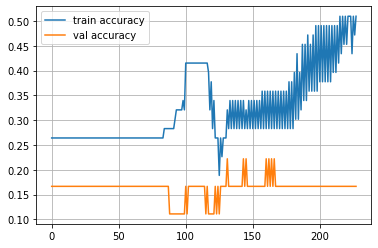

Epoch 228
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


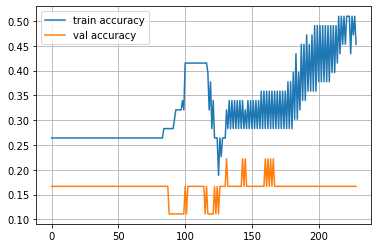

Epoch 229
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


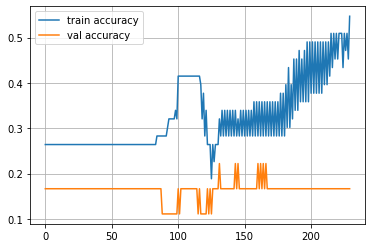

Epoch 230
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


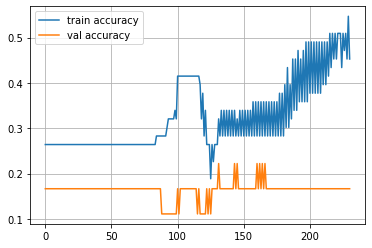

Epoch 231
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


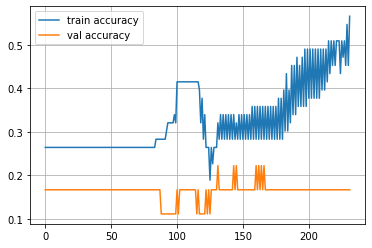

Epoch 232
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


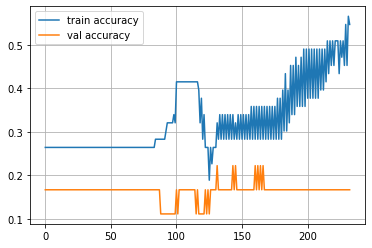

Epoch 233
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


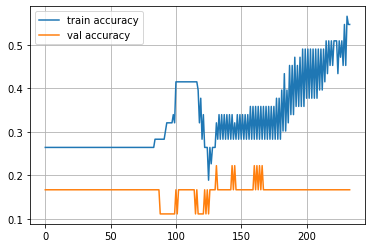

Epoch 234
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


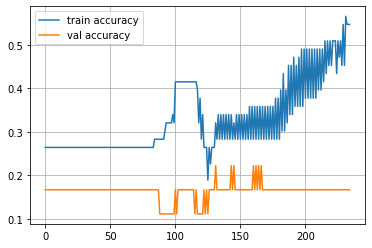

Epoch 235
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


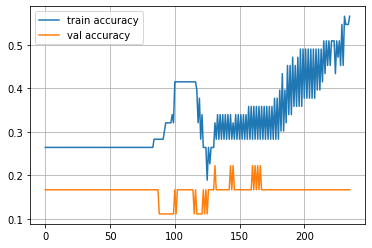

Epoch 236
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


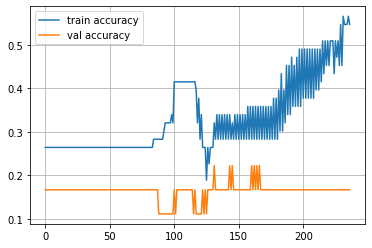

Epoch 237
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


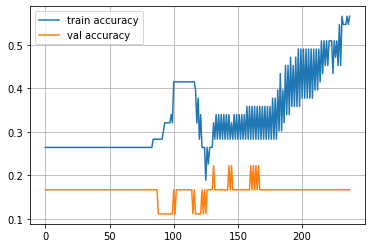

Epoch 238
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


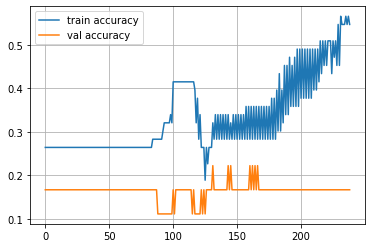

Epoch 239
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


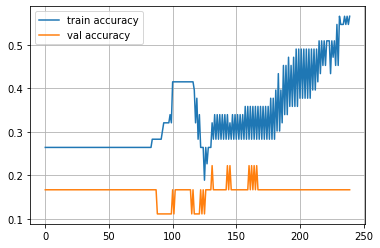

Epoch 240
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


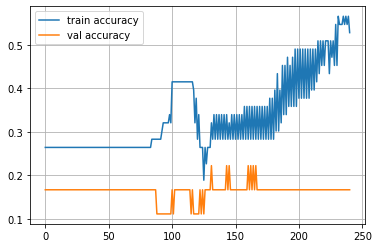

Epoch 241
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


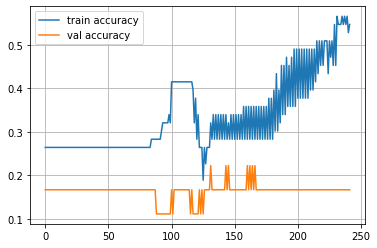

Epoch 242
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


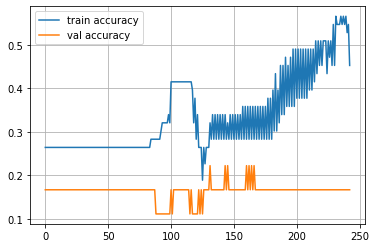

Epoch 243
Train accuracy: 0.49056603773584906
Val accuracy: 0.1111111111111111


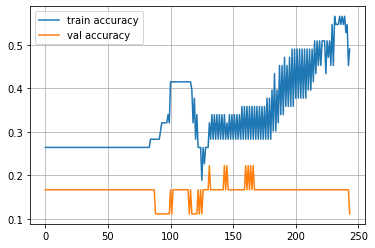

Epoch 244
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


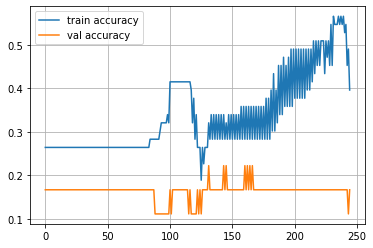

Epoch 245
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


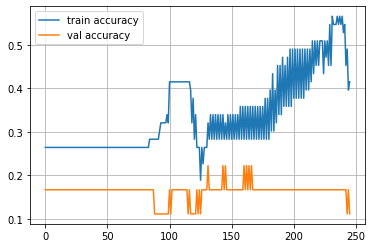

Epoch 246
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


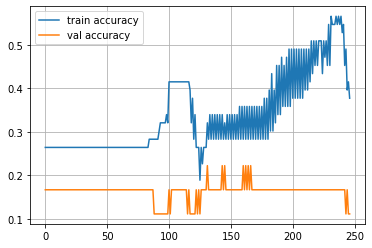

Epoch 247
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


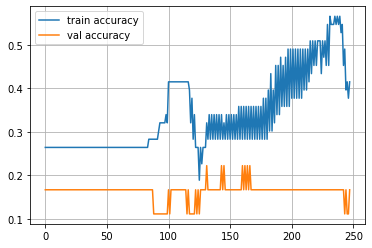

Epoch 248
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


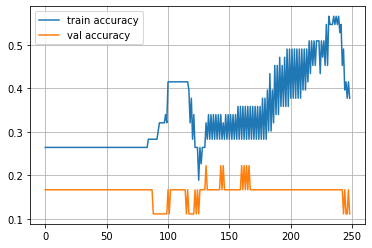

Epoch 249
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


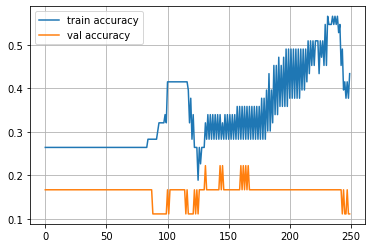

Epoch 250
Train accuracy: 0.37735849056603776
Val accuracy: 0.16666666666666666


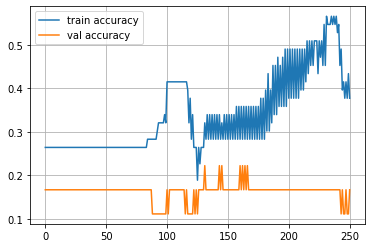

Epoch 251
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


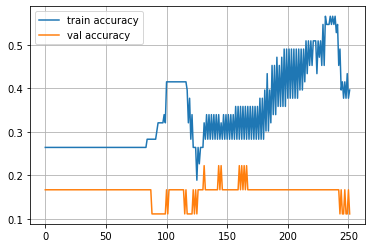

Epoch 252
Train accuracy: 0.39622641509433965
Val accuracy: 0.2222222222222222


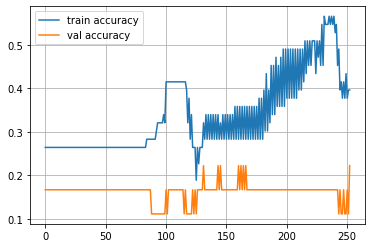

Epoch 253
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


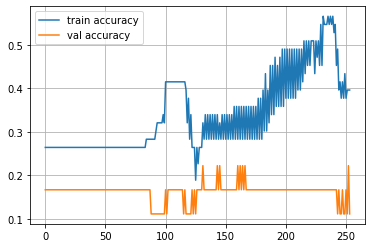

Epoch 254
Train accuracy: 0.4339622641509434
Val accuracy: 0.16666666666666666


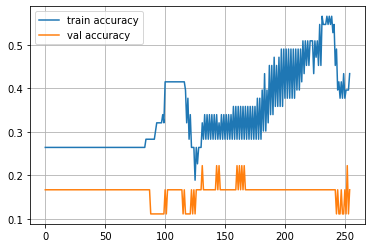

Epoch 255
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


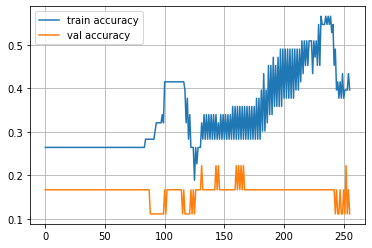

Epoch 256
Train accuracy: 0.49056603773584906
Val accuracy: 0.2222222222222222


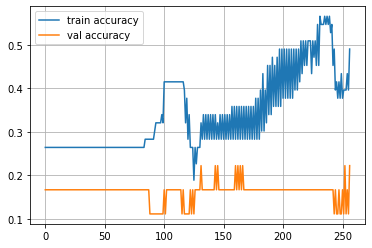

Epoch 257
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


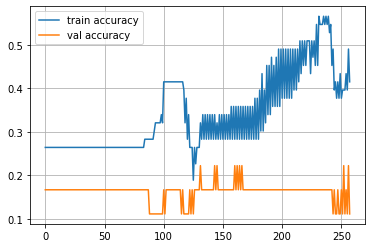

Epoch 258
Train accuracy: 0.49056603773584906
Val accuracy: 0.2222222222222222


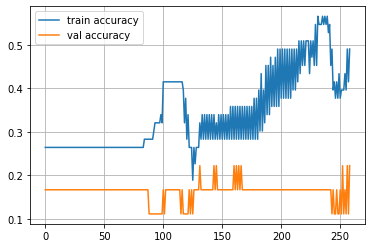

Epoch 259
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


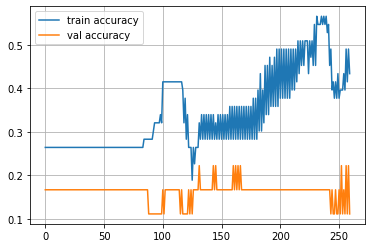

Epoch 260
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


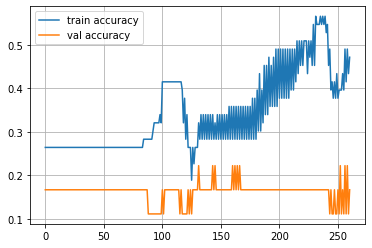

Epoch 261
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


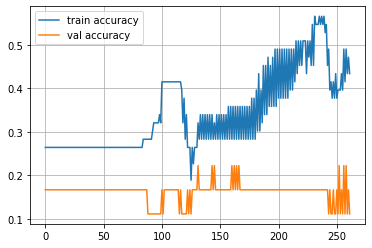

Epoch 262
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


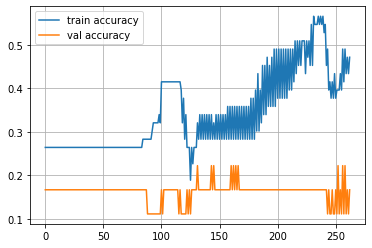

Epoch 263
Train accuracy: 0.4716981132075472
Val accuracy: 0.1111111111111111


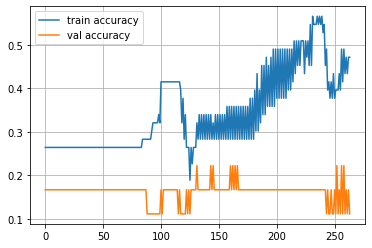

Epoch 264
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


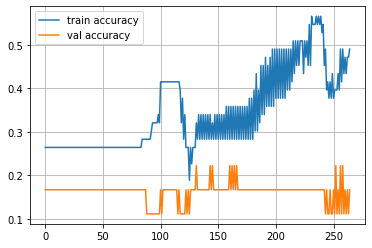

Epoch 265
Train accuracy: 0.4716981132075472
Val accuracy: 0.1111111111111111


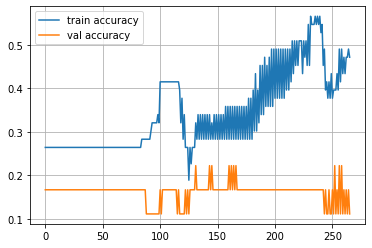

Epoch 266
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


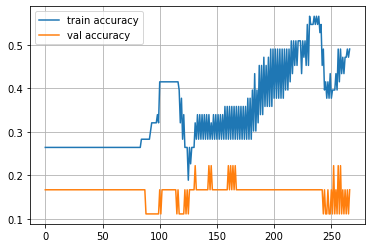

Epoch 267
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


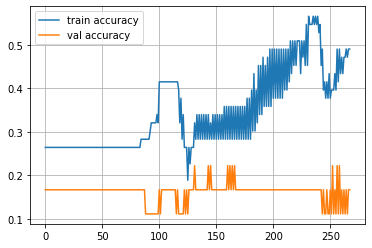

Epoch 268
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


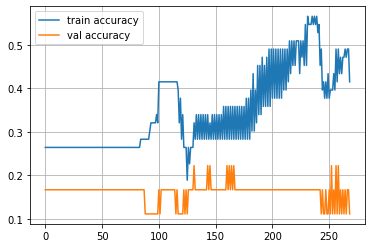

Epoch 269
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


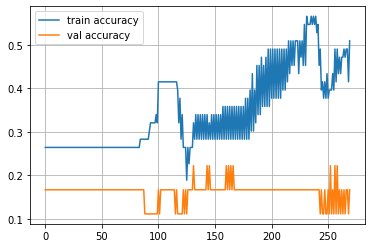

Epoch 270
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


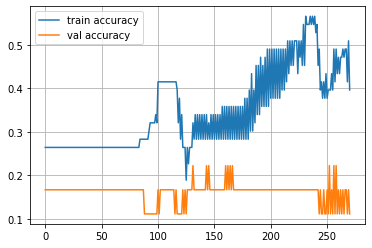

Epoch 271
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


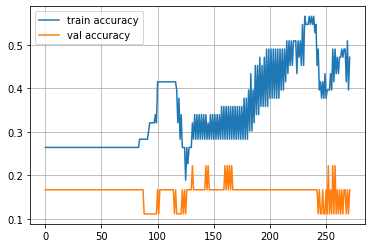

Epoch 272
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


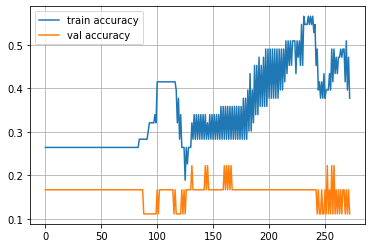

Epoch 273
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


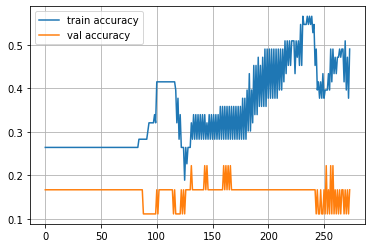

Epoch 274
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


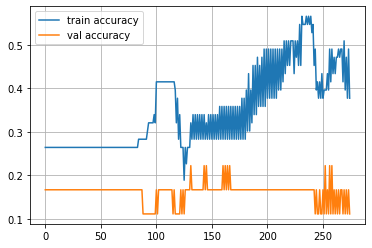

Epoch 275
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


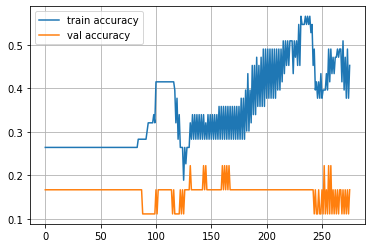

Epoch 276
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


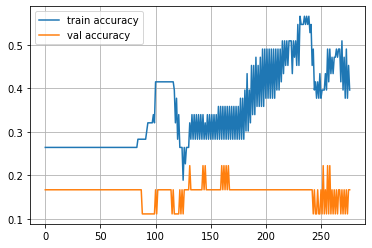

Epoch 277
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


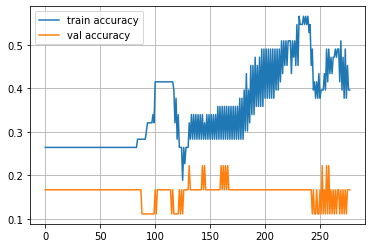

Epoch 278
Train accuracy: 0.39622641509433965
Val accuracy: 0.16666666666666666


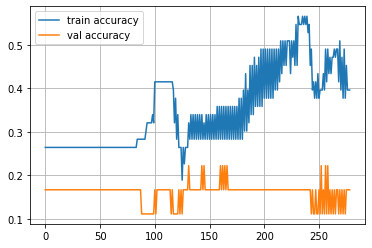

Epoch 279
Train accuracy: 0.4339622641509434
Val accuracy: 0.2222222222222222


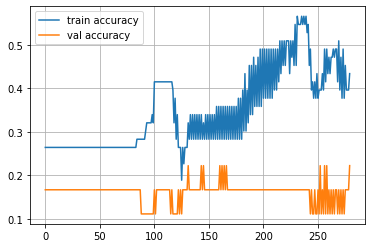

Epoch 280
Train accuracy: 0.3584905660377358
Val accuracy: 0.16666666666666666


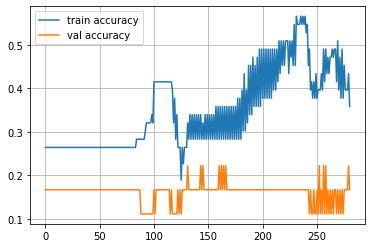

Epoch 281
Train accuracy: 0.4528301886792453
Val accuracy: 0.16666666666666666


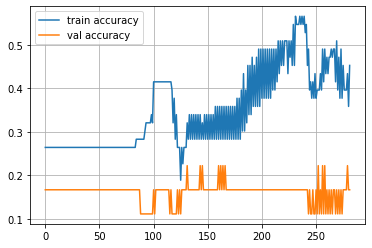

Epoch 282
Train accuracy: 0.3584905660377358
Val accuracy: 0.1111111111111111


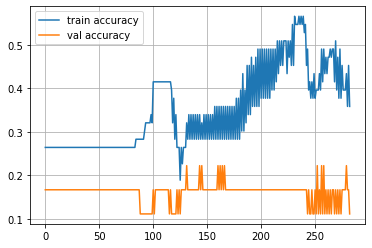

Epoch 283
Train accuracy: 0.5283018867924528
Val accuracy: 0.1111111111111111


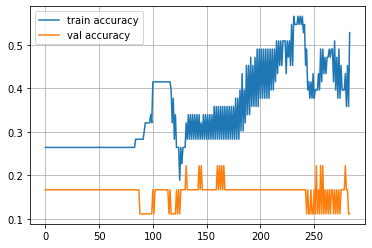

Epoch 284
Train accuracy: 0.33962264150943394
Val accuracy: 0.1111111111111111


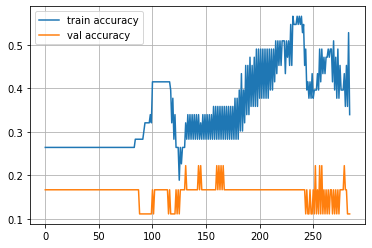

Epoch 285
Train accuracy: 0.5849056603773585
Val accuracy: 0.2777777777777778


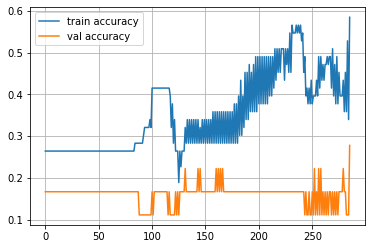

Epoch 286
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


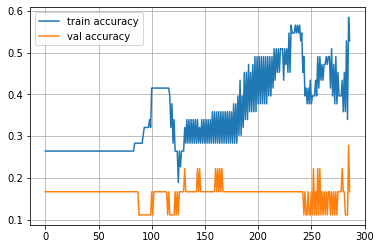

Epoch 287
Train accuracy: 0.5471698113207547
Val accuracy: 0.2222222222222222


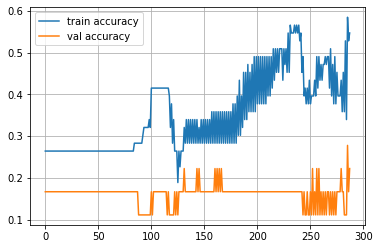

Epoch 288
Train accuracy: 0.5283018867924528
Val accuracy: 0.1111111111111111


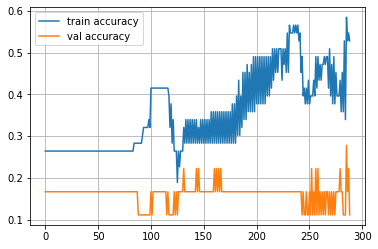

Epoch 289
Train accuracy: 0.6226415094339622
Val accuracy: 0.2222222222222222


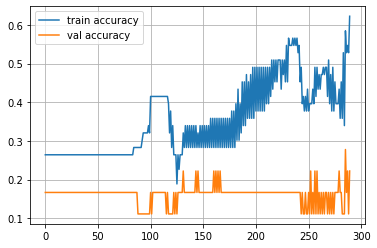

Epoch 290
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


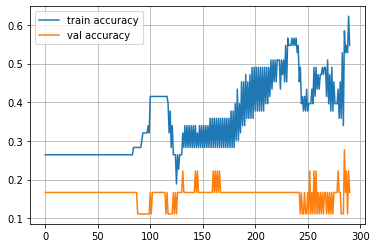

Epoch 291
Train accuracy: 0.6226415094339622
Val accuracy: 0.2222222222222222


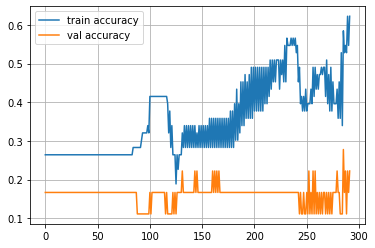

Epoch 292
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


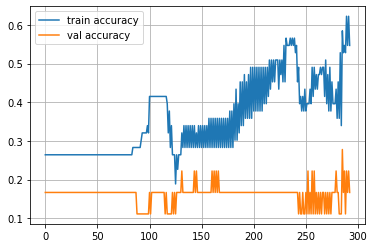

Epoch 293
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


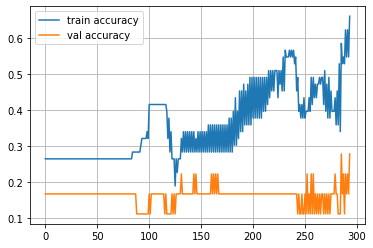

Epoch 294
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


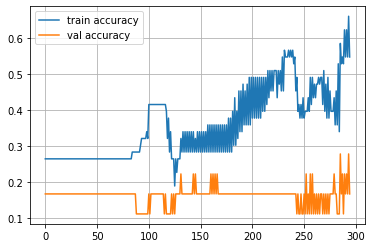

Epoch 295
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


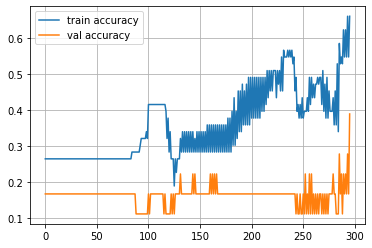

Epoch 296
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


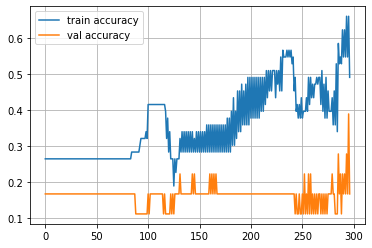

Epoch 297
Train accuracy: 0.6226415094339622
Val accuracy: 0.3888888888888889


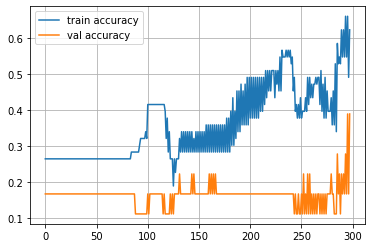

Epoch 298
Train accuracy: 0.49056603773584906
Val accuracy: 0.1111111111111111


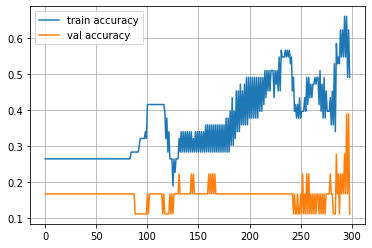

Epoch 299
Train accuracy: 0.4339622641509434
Val accuracy: 0.4444444444444444


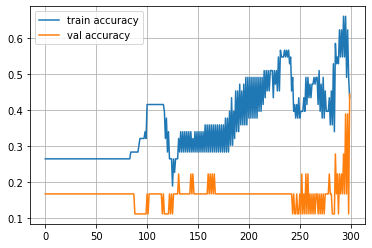

Epoch 300
Train accuracy: 0.49056603773584906
Val accuracy: 0.2222222222222222


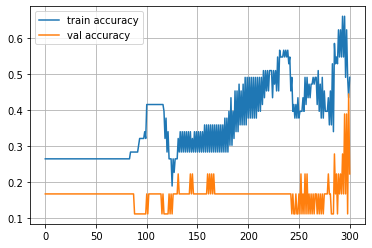

Epoch 301
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


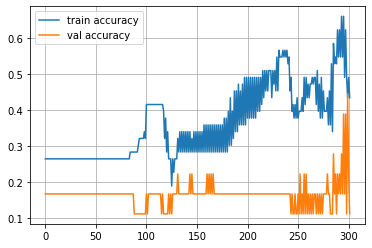

Epoch 302
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


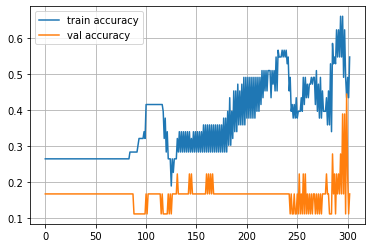

Epoch 303
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


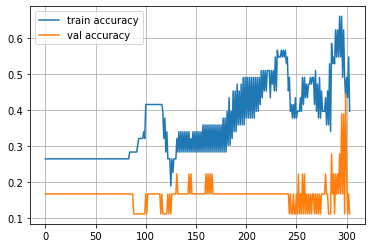

Epoch 304
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


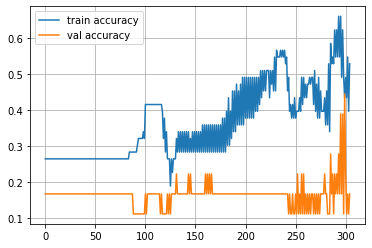

Epoch 305
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


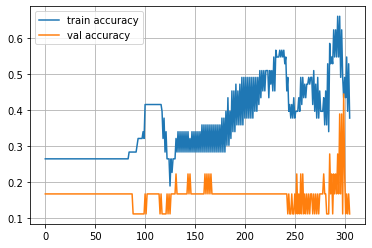

Epoch 306
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


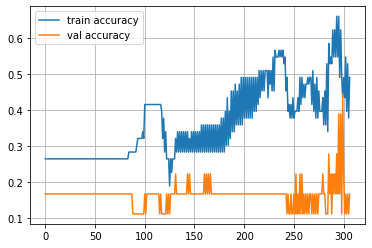

Epoch 307
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


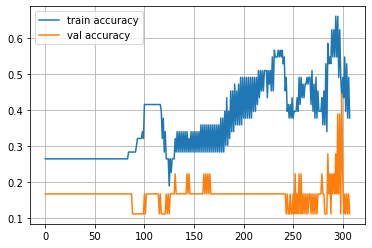

Epoch 308
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


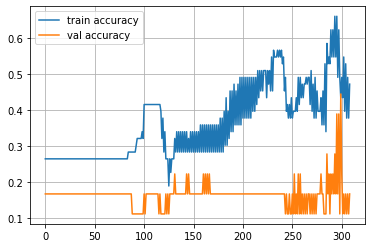

Epoch 309
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


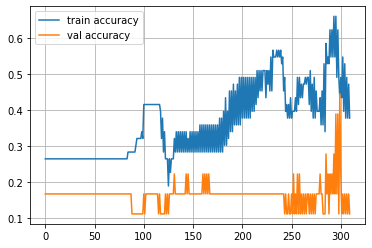

Epoch 310
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


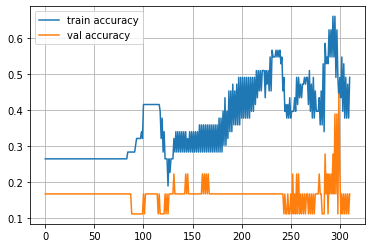

Epoch 311
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


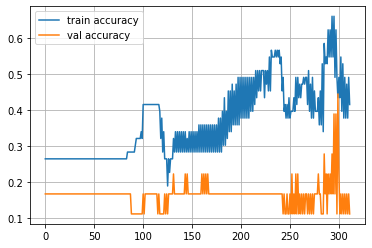

Epoch 312
Train accuracy: 0.5094339622641509
Val accuracy: 0.2222222222222222


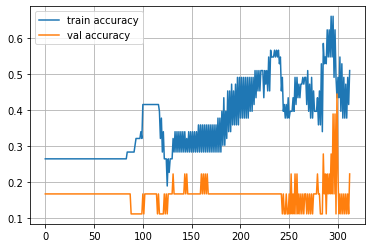

Epoch 313
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


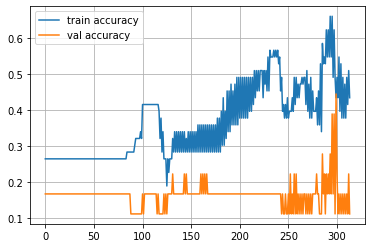

Epoch 314
Train accuracy: 0.5094339622641509
Val accuracy: 0.2222222222222222


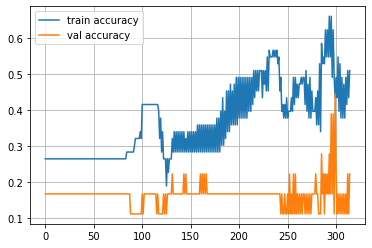

Epoch 315
Train accuracy: 0.4528301886792453
Val accuracy: 0.1111111111111111


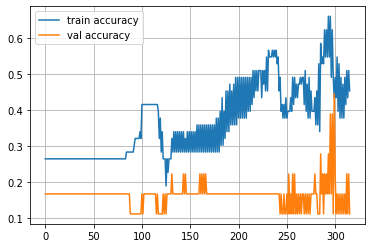

Epoch 316
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


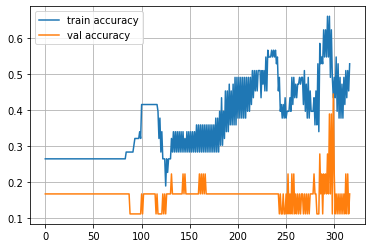

Epoch 317
Train accuracy: 0.5283018867924528
Val accuracy: 0.1111111111111111


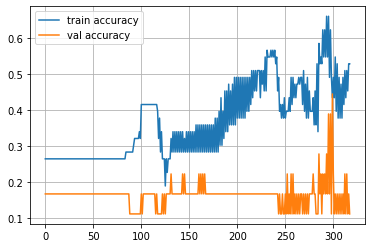

Epoch 318
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


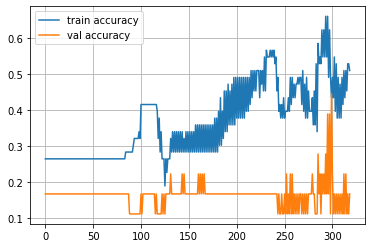

Epoch 319
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


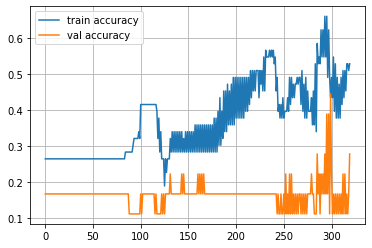

Epoch 320
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


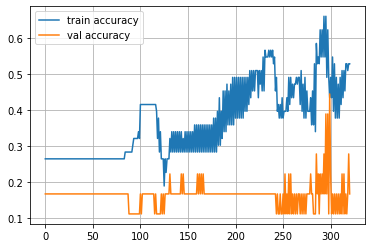

Epoch 321
Train accuracy: 0.5283018867924528
Val accuracy: 0.3888888888888889


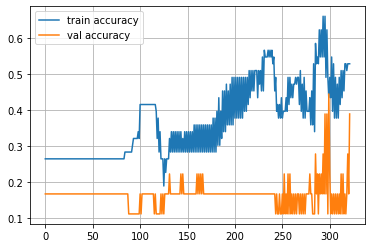

Epoch 322
Train accuracy: 0.4528301886792453
Val accuracy: 0.1111111111111111


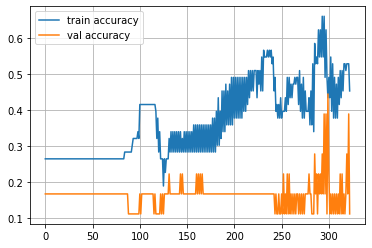

Epoch 323
Train accuracy: 0.49056603773584906
Val accuracy: 0.3888888888888889


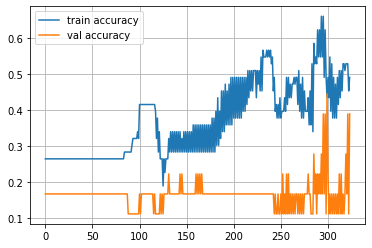

Epoch 324
Train accuracy: 0.4528301886792453
Val accuracy: 0.1111111111111111


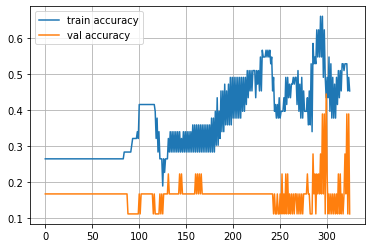

Epoch 325
Train accuracy: 0.5849056603773585
Val accuracy: 0.4444444444444444


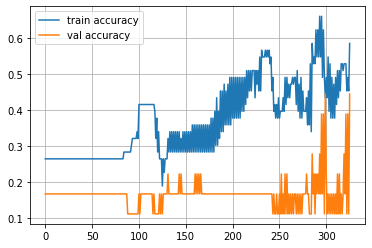

Epoch 326
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


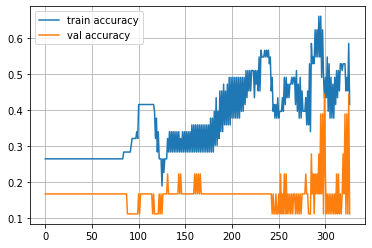

Epoch 327
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


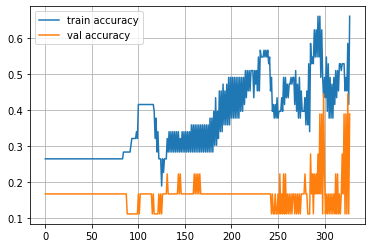

Epoch 328
Train accuracy: 0.5283018867924528
Val accuracy: 0.1111111111111111


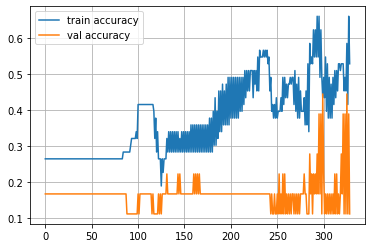

Epoch 329
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


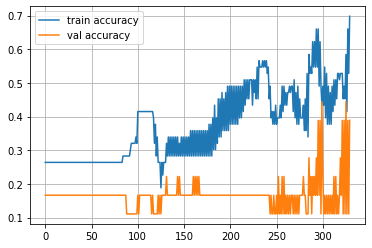

Epoch 330
Train accuracy: 0.6226415094339622
Val accuracy: 0.1111111111111111


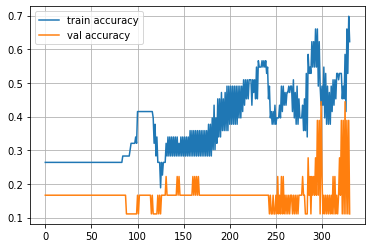

Epoch 331
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


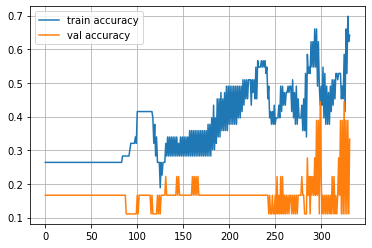

Epoch 332
Train accuracy: 0.6415094339622641
Val accuracy: 0.1111111111111111


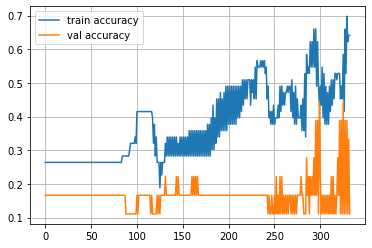

Epoch 333
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


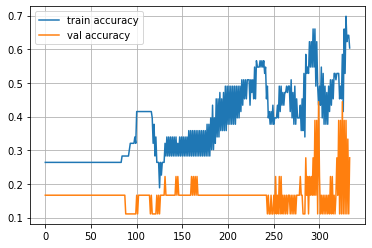

Epoch 334
Train accuracy: 0.6037735849056604
Val accuracy: 0.16666666666666666


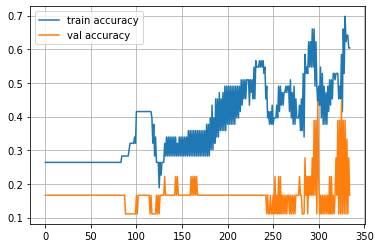

Epoch 335
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


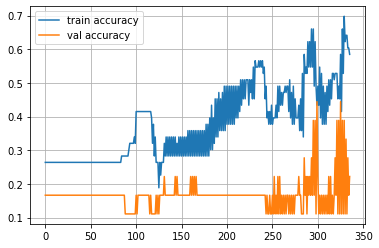

Epoch 336
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


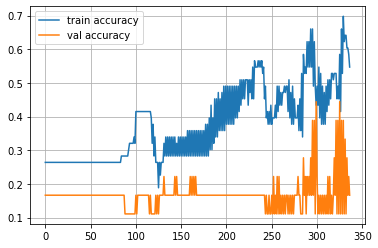

Epoch 337
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


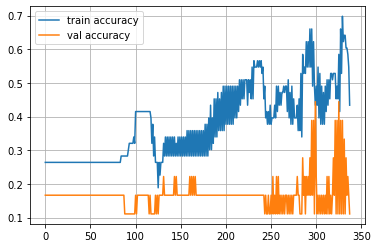

Epoch 338
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


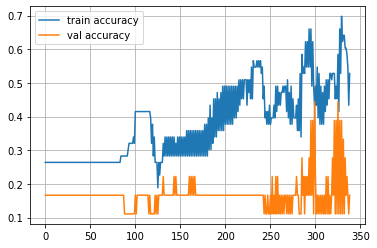

Epoch 339
Train accuracy: 0.37735849056603776
Val accuracy: 0.1111111111111111


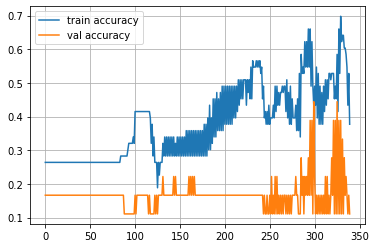

Epoch 340
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


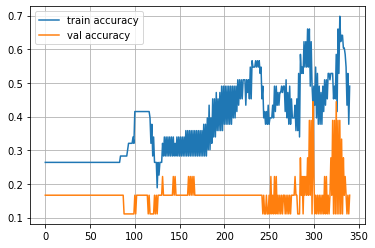

Epoch 341
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


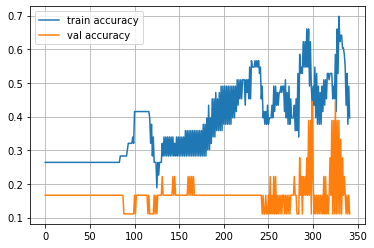

Epoch 342
Train accuracy: 0.5094339622641509
Val accuracy: 0.16666666666666666


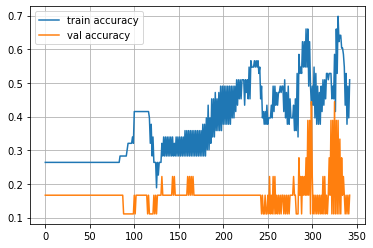

Epoch 343
Train accuracy: 0.4716981132075472
Val accuracy: 0.1111111111111111


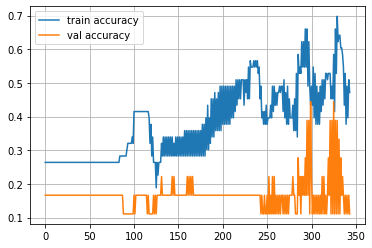

Epoch 344
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


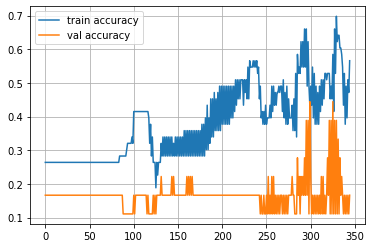

Epoch 345
Train accuracy: 0.49056603773584906
Val accuracy: 0.1111111111111111


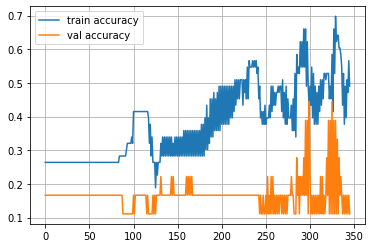

Epoch 346
Train accuracy: 0.6415094339622641
Val accuracy: 0.16666666666666666


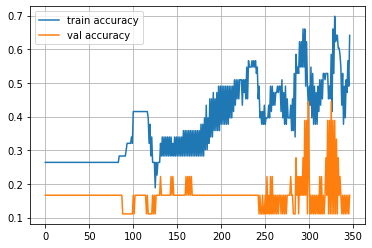

Epoch 347
Train accuracy: 0.5283018867924528
Val accuracy: 0.1111111111111111


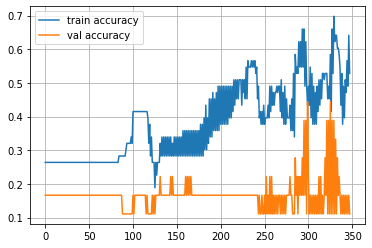

Epoch 348
Train accuracy: 0.6226415094339622
Val accuracy: 0.16666666666666666


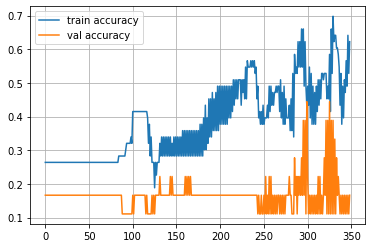

Epoch 349
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


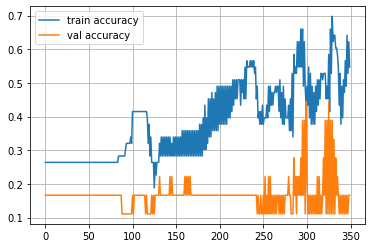

Epoch 350
Train accuracy: 0.6037735849056604
Val accuracy: 0.16666666666666666


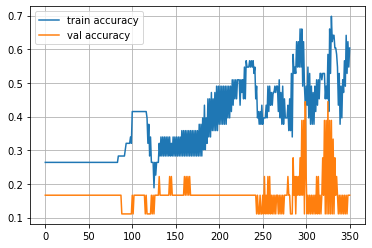

Epoch 351
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


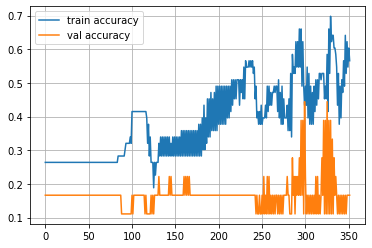

Epoch 352
Train accuracy: 0.6226415094339622
Val accuracy: 0.16666666666666666


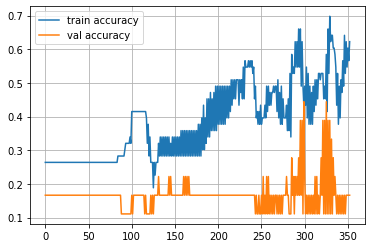

Epoch 353
Train accuracy: 0.5849056603773585
Val accuracy: 0.16666666666666666


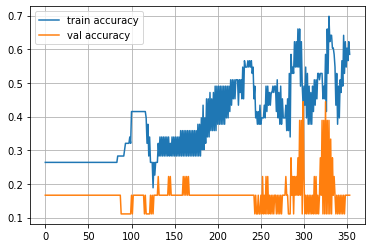

Epoch 354
Train accuracy: 0.6226415094339622
Val accuracy: 0.16666666666666666


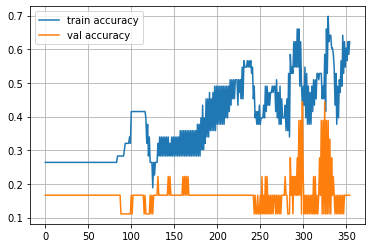

Epoch 355
Train accuracy: 0.6226415094339622
Val accuracy: 0.16666666666666666


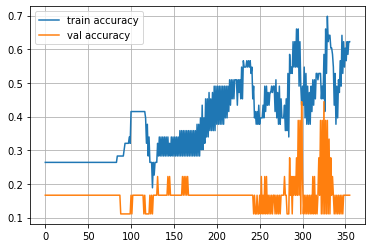

Epoch 356
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


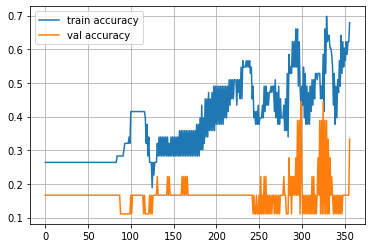

Epoch 357
Train accuracy: 0.6415094339622641
Val accuracy: 0.16666666666666666


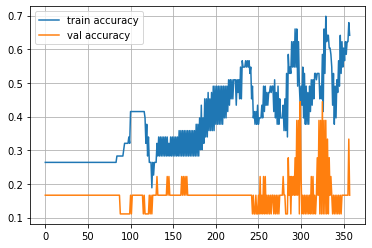

Epoch 358
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


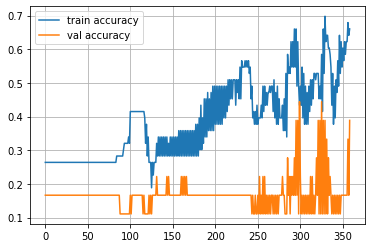

Epoch 359
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


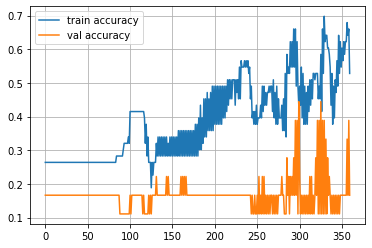

Epoch 360
Train accuracy: 0.4716981132075472
Val accuracy: 0.4444444444444444


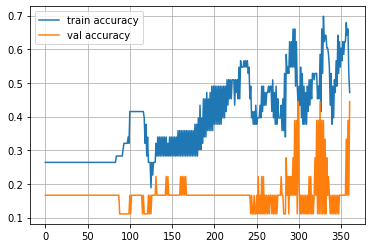

Epoch 361
Train accuracy: 0.4716981132075472
Val accuracy: 0.1111111111111111


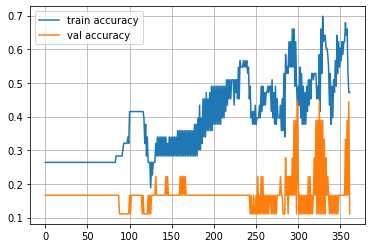

Epoch 362
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


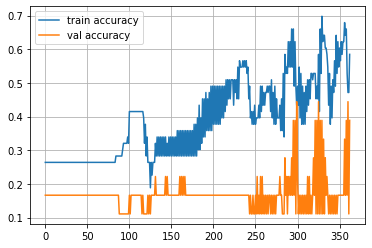

Epoch 363
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


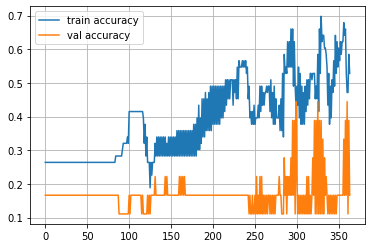

Epoch 364
Train accuracy: 0.5849056603773585
Val accuracy: 0.3333333333333333


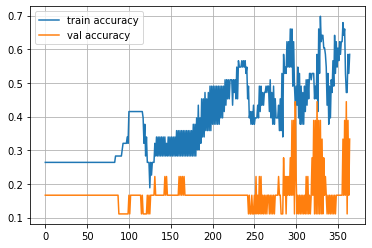

Epoch 365
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


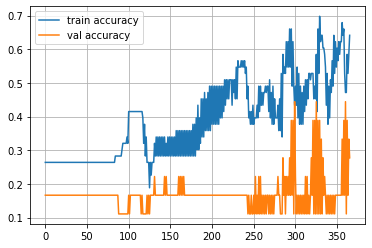

Epoch 366
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


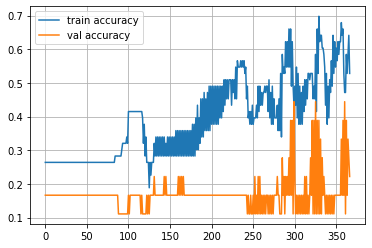

Epoch 367
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


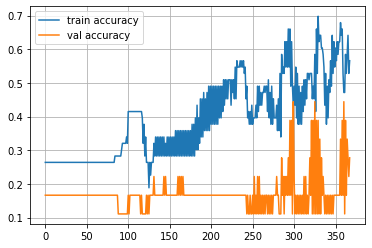

Epoch 368
Train accuracy: 0.4528301886792453
Val accuracy: 0.1111111111111111


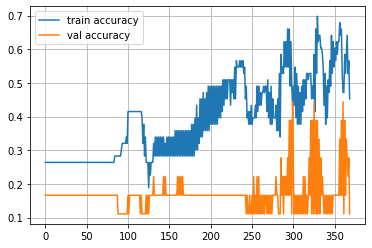

Epoch 369
Train accuracy: 0.5471698113207547
Val accuracy: 0.2777777777777778


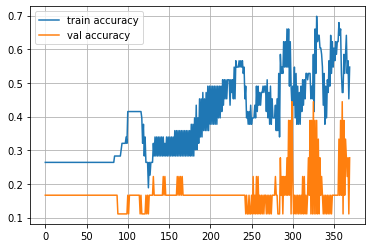

Epoch 370
Train accuracy: 0.41509433962264153
Val accuracy: 0.1111111111111111


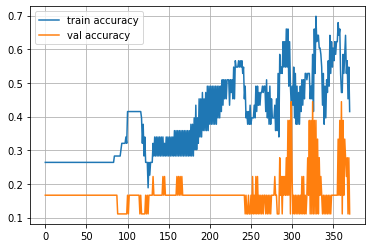

Epoch 371
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


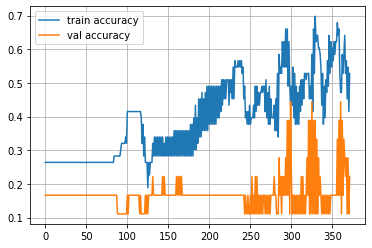

Epoch 372
Train accuracy: 0.5094339622641509
Val accuracy: 0.1111111111111111


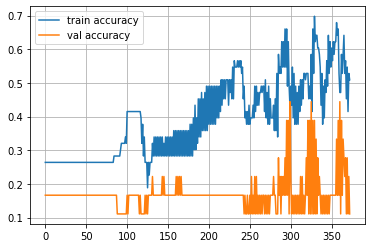

Epoch 373
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


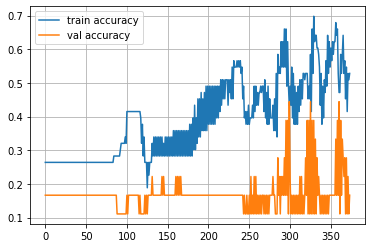

Epoch 374
Train accuracy: 0.5660377358490566
Val accuracy: 0.1111111111111111


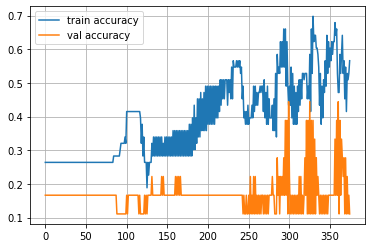

Epoch 375
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


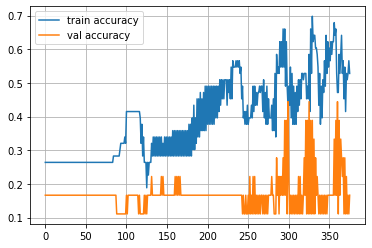

Epoch 376
Train accuracy: 0.6037735849056604
Val accuracy: 0.1111111111111111


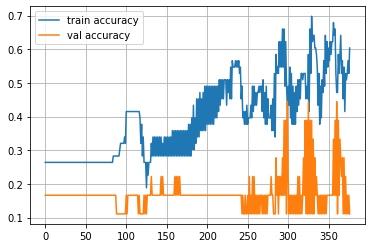

Epoch 377
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


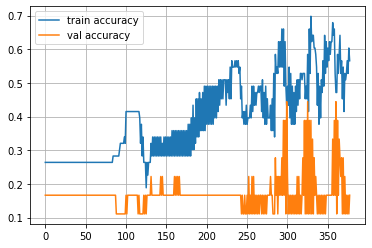

Epoch 378
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


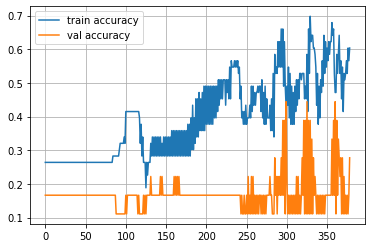

Epoch 379
Train accuracy: 0.6037735849056604
Val accuracy: 0.16666666666666666


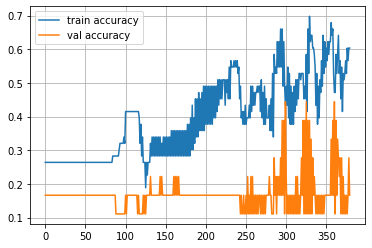

Epoch 380
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


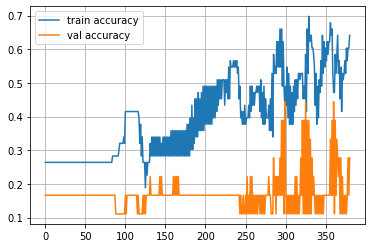

Epoch 381
Train accuracy: 0.6226415094339622
Val accuracy: 0.16666666666666666


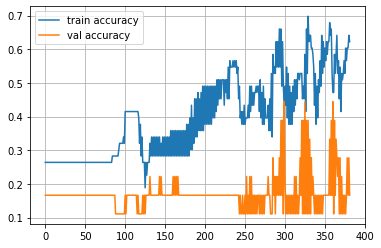

Epoch 382
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


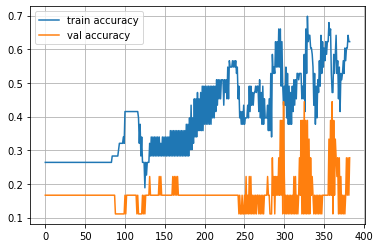

Epoch 383
Train accuracy: 0.660377358490566
Val accuracy: 0.16666666666666666


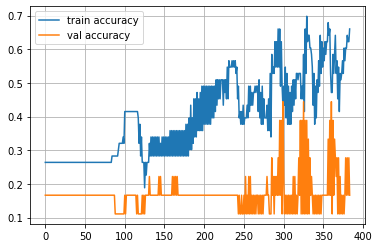

Epoch 384
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


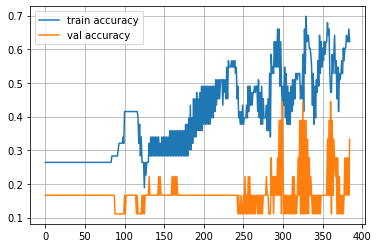

Epoch 385
Train accuracy: 0.660377358490566
Val accuracy: 0.16666666666666666


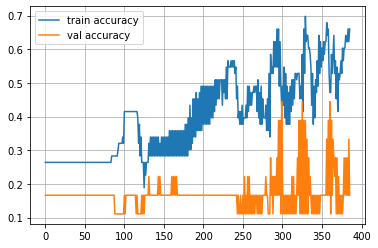

Epoch 386
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


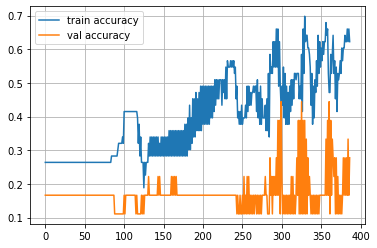

Epoch 387
Train accuracy: 0.660377358490566
Val accuracy: 0.2222222222222222


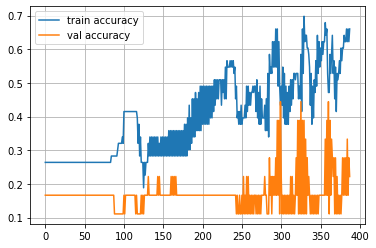

Epoch 388
Train accuracy: 0.5471698113207547
Val accuracy: 0.2222222222222222


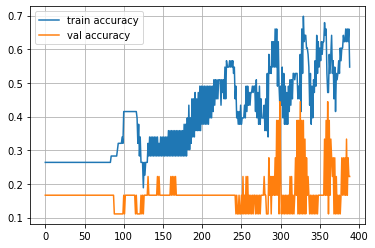

Epoch 389
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


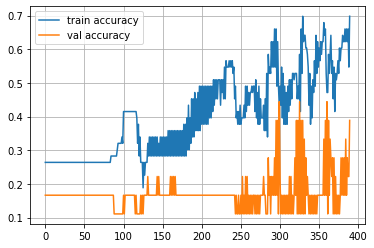

Epoch 390
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


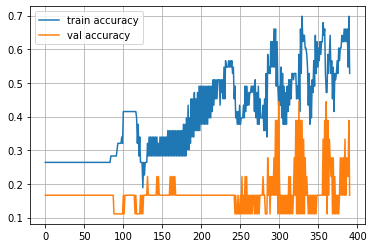

Epoch 391
Train accuracy: 0.5283018867924528
Val accuracy: 0.3333333333333333


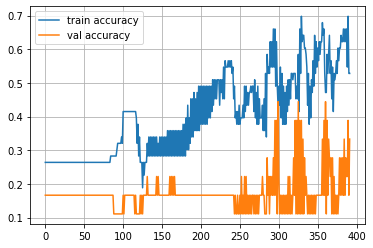

Epoch 392
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


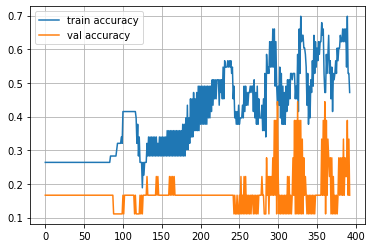

Epoch 393
Train accuracy: 0.5094339622641509
Val accuracy: 0.4444444444444444


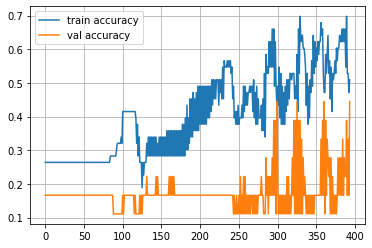

Epoch 394
Train accuracy: 0.4716981132075472
Val accuracy: 0.1111111111111111


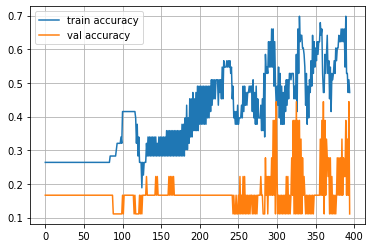

Epoch 395
Train accuracy: 0.6415094339622641
Val accuracy: 0.4444444444444444


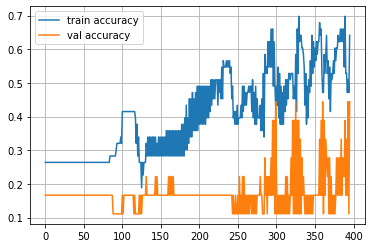

Epoch 396
Train accuracy: 0.4716981132075472
Val accuracy: 0.16666666666666666


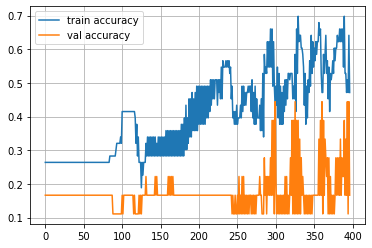

Epoch 397
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


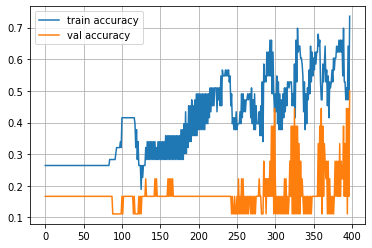

Epoch 398
Train accuracy: 0.5849056603773585
Val accuracy: 0.16666666666666666


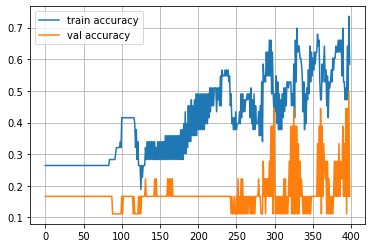

Epoch 399
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


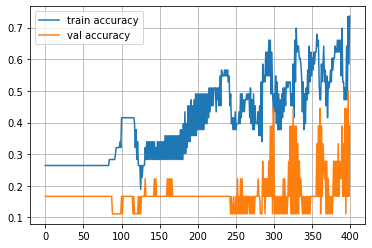

Epoch 400
Train accuracy: 0.5849056603773585
Val accuracy: 0.16666666666666666


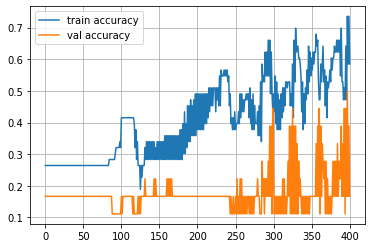

Epoch 401
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


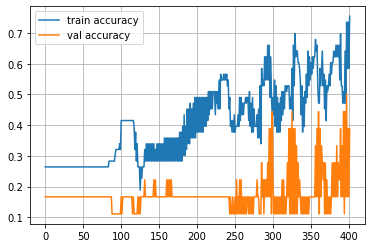

Epoch 402
Train accuracy: 0.6037735849056604
Val accuracy: 0.16666666666666666


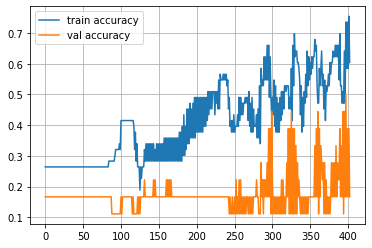

Epoch 403
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


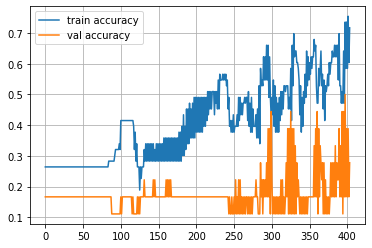

Epoch 404
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


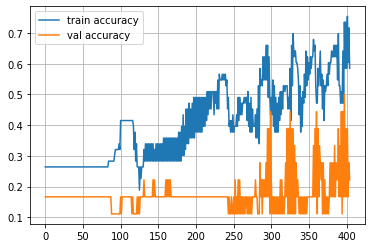

Epoch 405
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


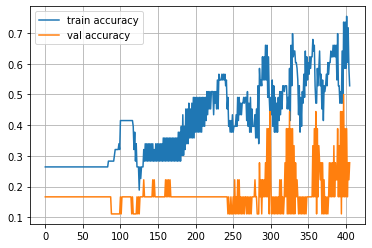

Epoch 406
Train accuracy: 0.41509433962264153
Val accuracy: 0.16666666666666666


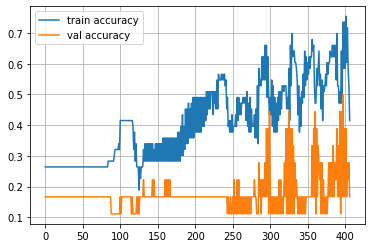

Epoch 407
Train accuracy: 0.41509433962264153
Val accuracy: 0.2777777777777778


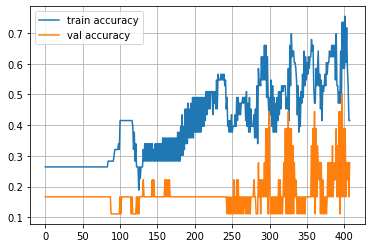

Epoch 408
Train accuracy: 0.39622641509433965
Val accuracy: 0.1111111111111111


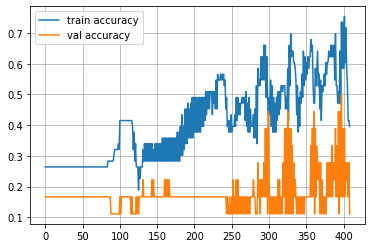

Epoch 409
Train accuracy: 0.4716981132075472
Val accuracy: 0.2777777777777778


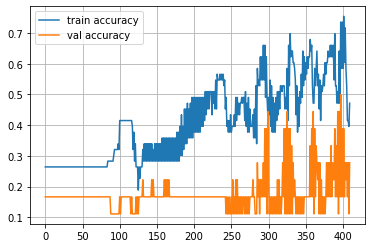

Epoch 410
Train accuracy: 0.5094339622641509
Val accuracy: 0.2777777777777778


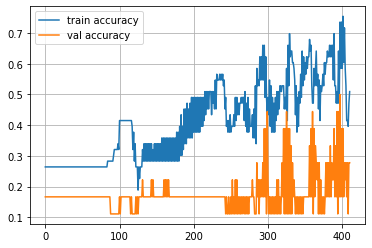

Epoch 411
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


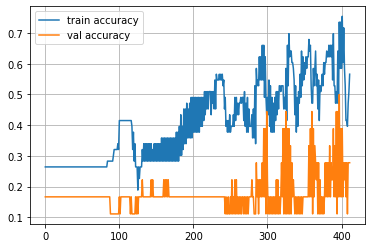

Epoch 412
Train accuracy: 0.5849056603773585
Val accuracy: 0.3333333333333333


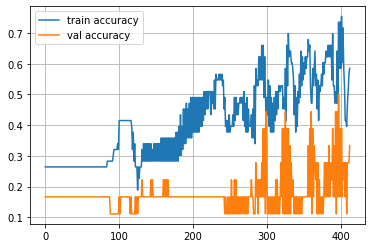

Epoch 413
Train accuracy: 0.5660377358490566
Val accuracy: 0.2222222222222222


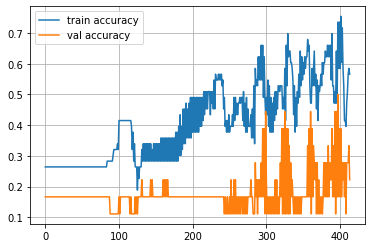

Epoch 414
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


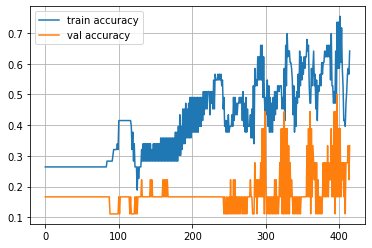

Epoch 415
Train accuracy: 0.6037735849056604
Val accuracy: 0.2222222222222222


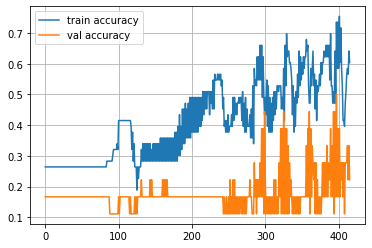

Epoch 416
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


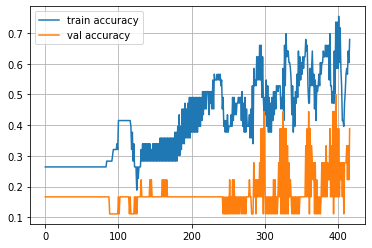

Epoch 417
Train accuracy: 0.6415094339622641
Val accuracy: 0.16666666666666666


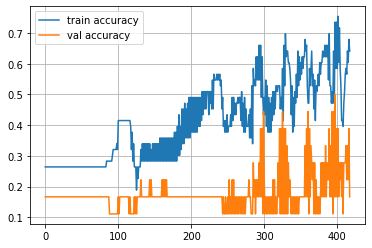

Epoch 418
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


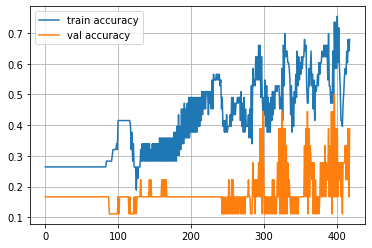

Epoch 419
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


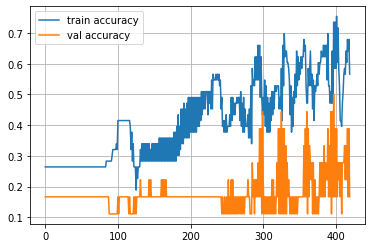

Epoch 420
Train accuracy: 0.6037735849056604
Val accuracy: 0.3333333333333333


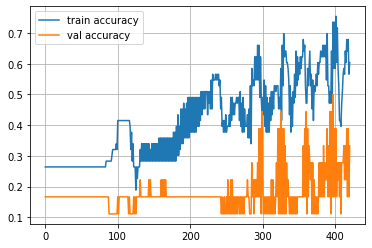

Epoch 421
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


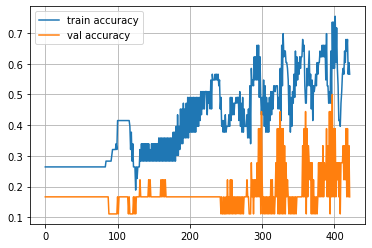

Epoch 422
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


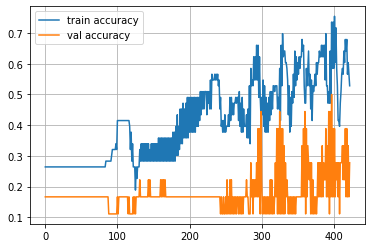

Epoch 423
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


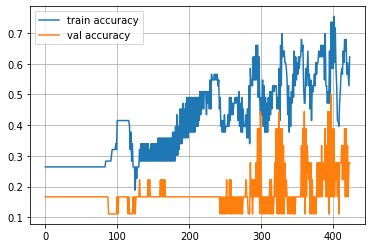

Epoch 424
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


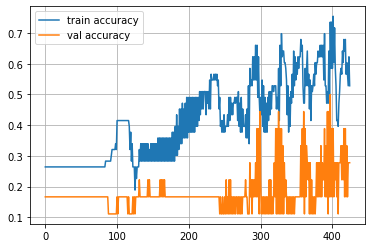

Epoch 425
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


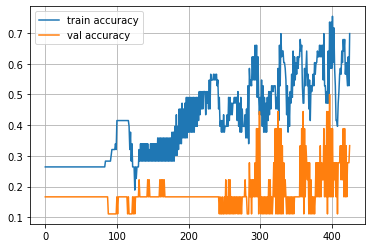

Epoch 426
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


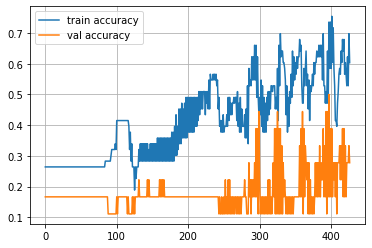

Epoch 427
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


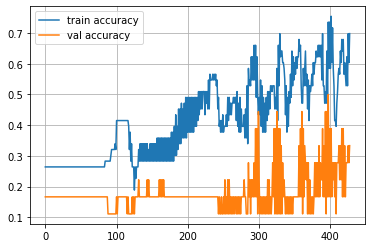

Epoch 428
Train accuracy: 0.6037735849056604
Val accuracy: 0.2222222222222222


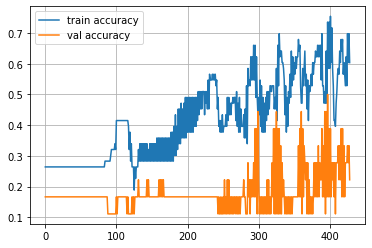

Epoch 429
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


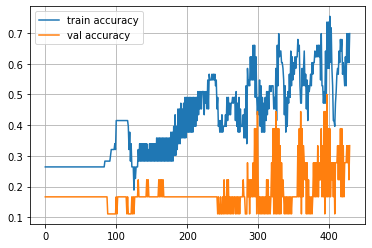

Epoch 430
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


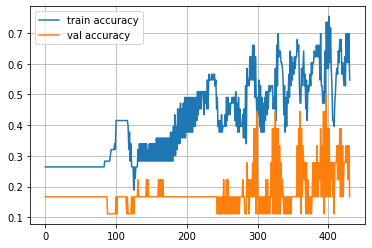

Epoch 431
Train accuracy: 0.6037735849056604
Val accuracy: 0.3333333333333333


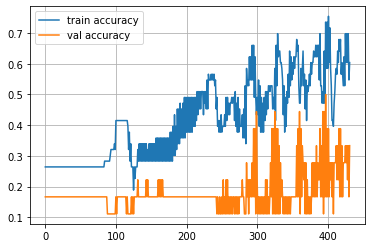

Epoch 432
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


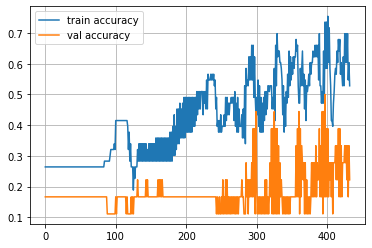

Epoch 433
Train accuracy: 0.5094339622641509
Val accuracy: 0.4444444444444444


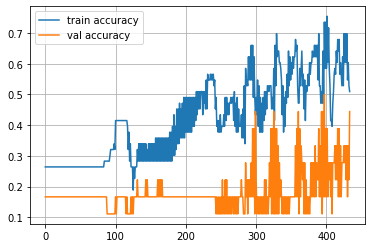

Epoch 434
Train accuracy: 0.5094339622641509
Val accuracy: 0.2222222222222222


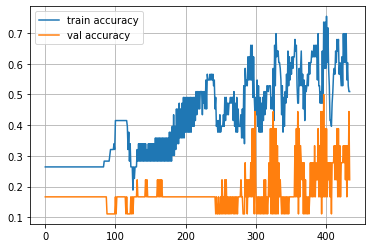

Epoch 435
Train accuracy: 0.6226415094339622
Val accuracy: 0.4444444444444444


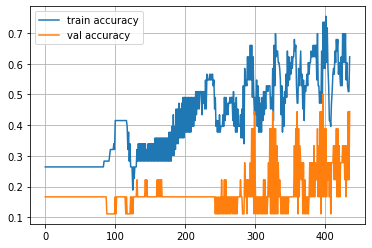

Epoch 436
Train accuracy: 0.5660377358490566
Val accuracy: 0.2222222222222222


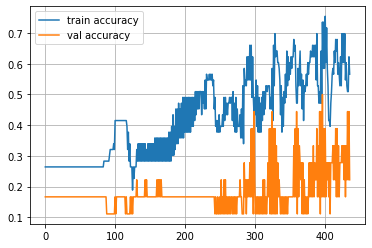

Epoch 437
Train accuracy: 0.5849056603773585
Val accuracy: 0.3333333333333333


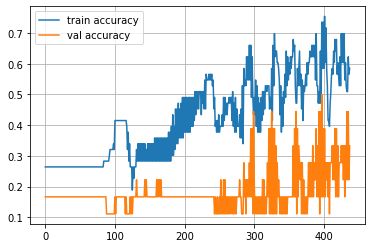

Epoch 438
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


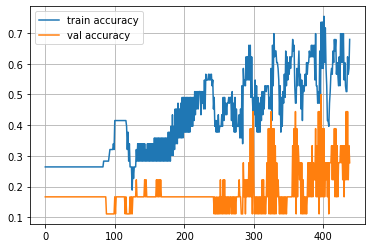

Epoch 439
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


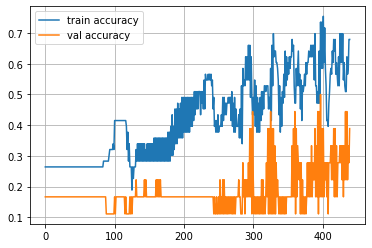

Epoch 440
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


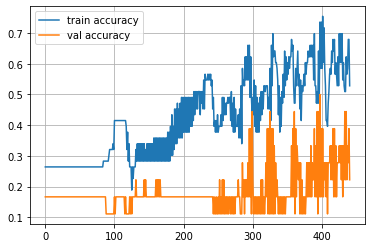

Epoch 441
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


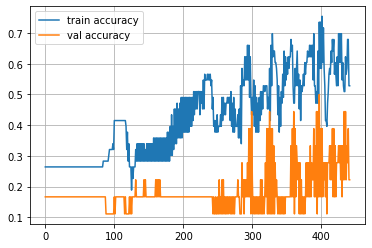

Epoch 442
Train accuracy: 0.4528301886792453
Val accuracy: 0.2777777777777778


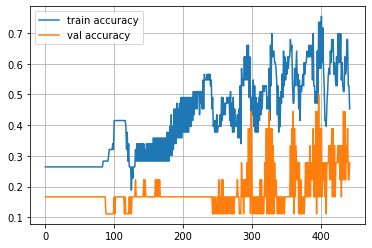

Epoch 443
Train accuracy: 0.5094339622641509
Val accuracy: 0.2777777777777778


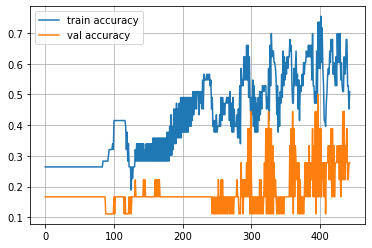

Epoch 444
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


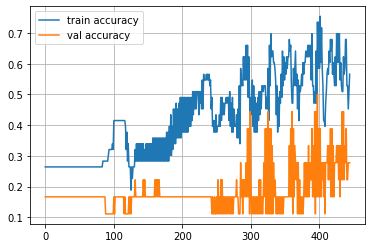

Epoch 445
Train accuracy: 0.5471698113207547
Val accuracy: 0.2222222222222222


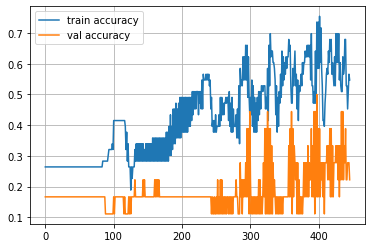

Epoch 446
Train accuracy: 0.5849056603773585
Val accuracy: 0.2777777777777778


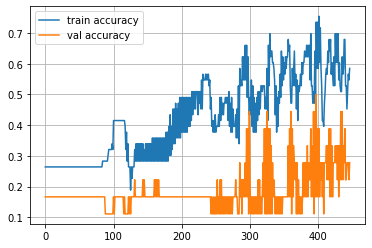

Epoch 447
Train accuracy: 0.5660377358490566
Val accuracy: 0.2222222222222222


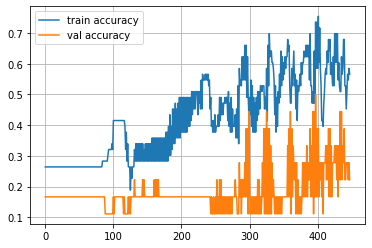

Epoch 448
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


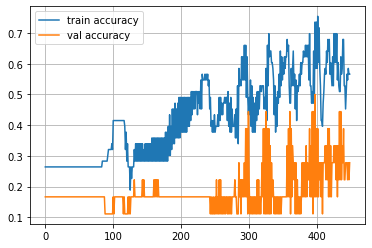

Epoch 449
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


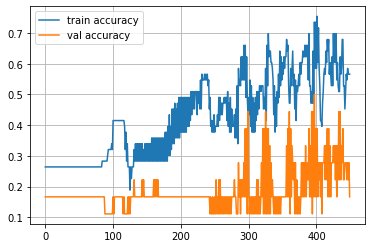

Epoch 450
Train accuracy: 0.6037735849056604
Val accuracy: 0.3888888888888889


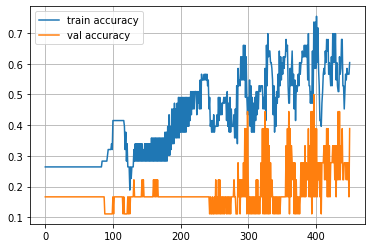

Epoch 451
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


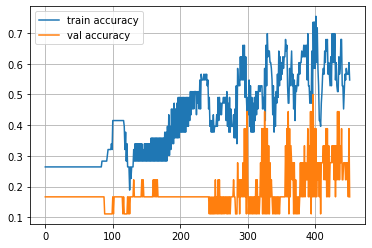

Epoch 452
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


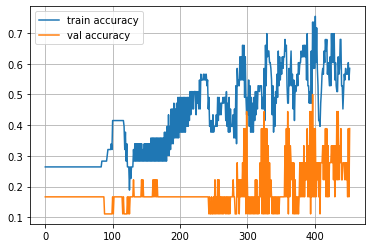

Epoch 453
Train accuracy: 0.4339622641509434
Val accuracy: 0.1111111111111111


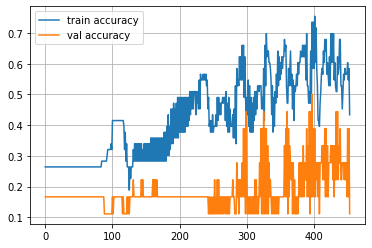

Epoch 454
Train accuracy: 0.6037735849056604
Val accuracy: 0.3333333333333333


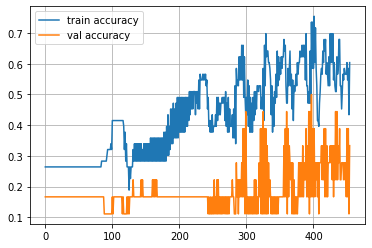

Epoch 455
Train accuracy: 0.4716981132075472
Val accuracy: 0.1111111111111111


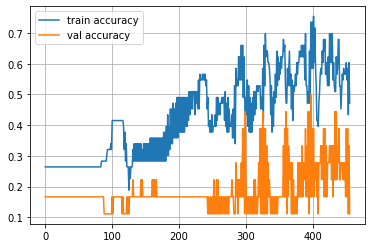

Epoch 456
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


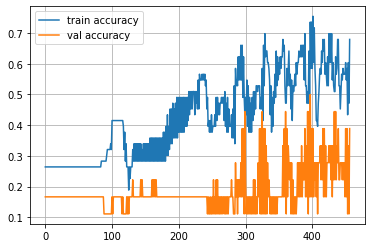

Epoch 457
Train accuracy: 0.6037735849056604
Val accuracy: 0.16666666666666666


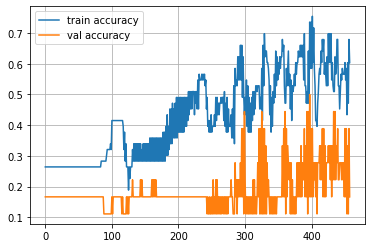

Epoch 458
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


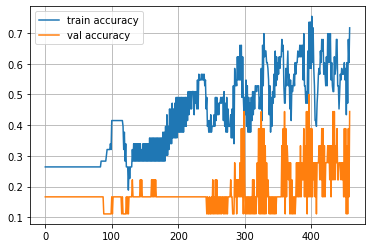

Epoch 459
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


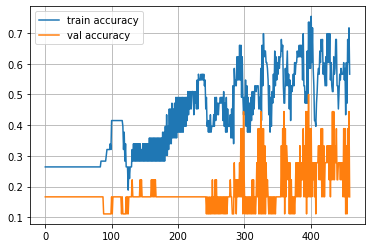

Epoch 460
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


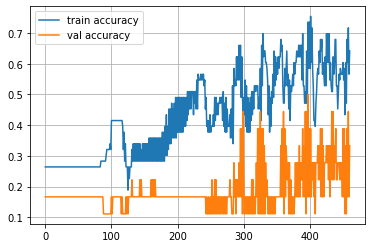

Epoch 461
Train accuracy: 0.49056603773584906
Val accuracy: 0.16666666666666666


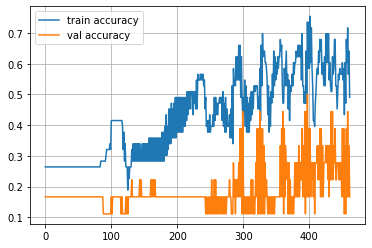

Epoch 462
Train accuracy: 0.5849056603773585
Val accuracy: 0.2777777777777778


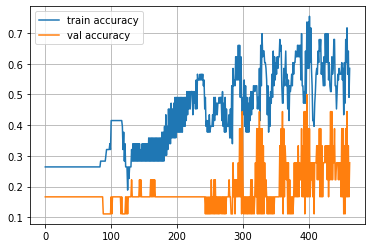

Epoch 463
Train accuracy: 0.5471698113207547
Val accuracy: 0.1111111111111111


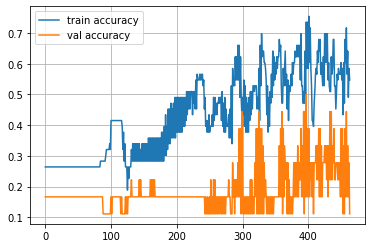

Epoch 464
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


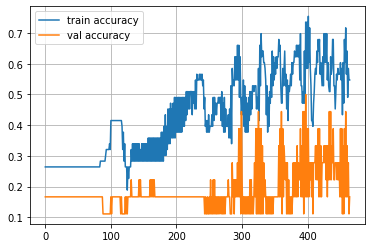

Epoch 465
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


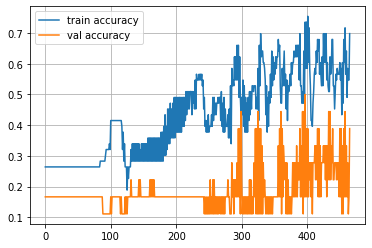

Epoch 466
Train accuracy: 0.49056603773584906
Val accuracy: 0.2222222222222222


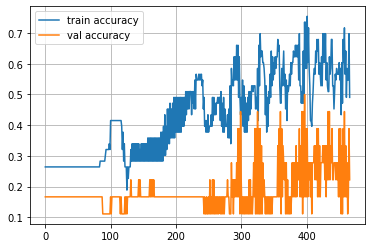

Epoch 467
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


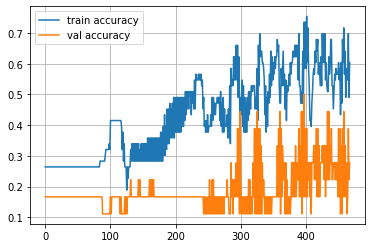

Epoch 468
Train accuracy: 0.5849056603773585
Val accuracy: 0.2777777777777778


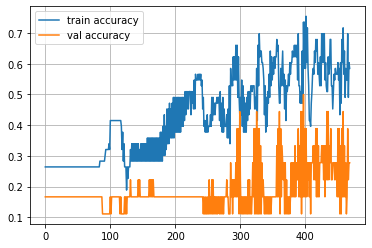

Epoch 469
Train accuracy: 0.5094339622641509
Val accuracy: 0.2222222222222222


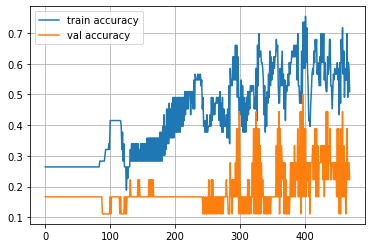

Epoch 470
Train accuracy: 0.6226415094339622
Val accuracy: 0.3888888888888889


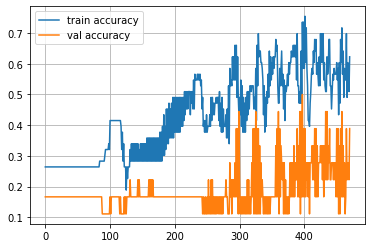

Epoch 471
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


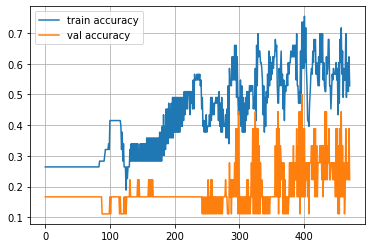

Epoch 472
Train accuracy: 0.5660377358490566
Val accuracy: 0.3888888888888889


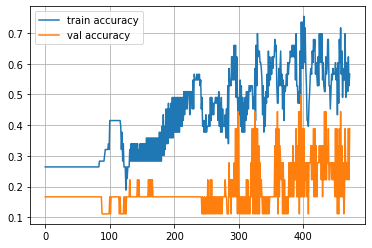

Epoch 473
Train accuracy: 0.6037735849056604
Val accuracy: 0.2222222222222222


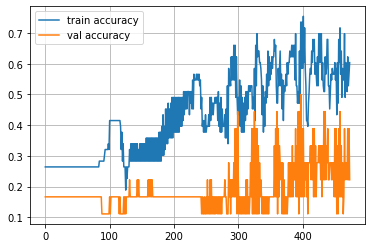

Epoch 474
Train accuracy: 0.660377358490566
Val accuracy: 0.5


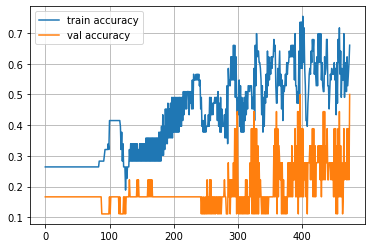

Epoch 475
Train accuracy: 0.6415094339622641
Val accuracy: 0.16666666666666666


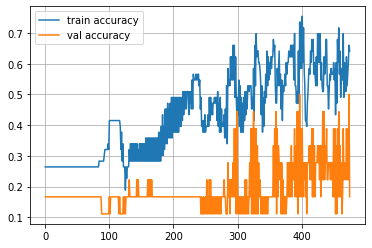

Epoch 476
Train accuracy: 0.660377358490566
Val accuracy: 0.5


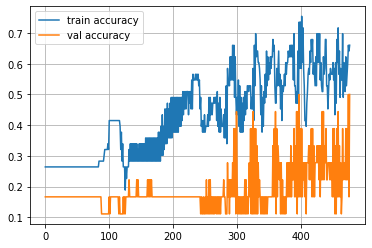

Epoch 477
Train accuracy: 0.6415094339622641
Val accuracy: 0.2222222222222222


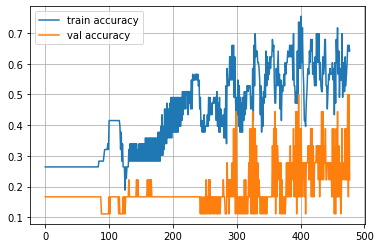

Epoch 478
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


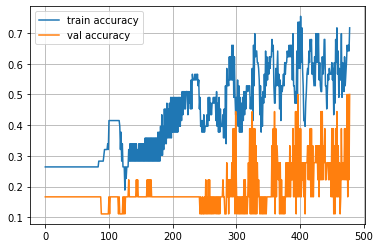

Epoch 479
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


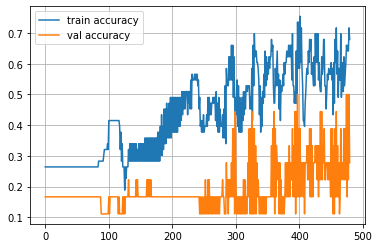

Epoch 480
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


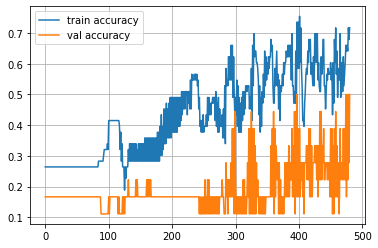

Epoch 481
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


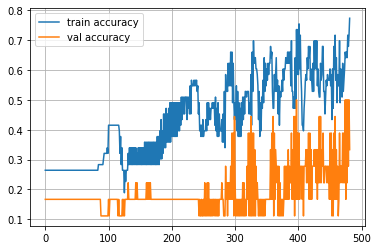

Epoch 482
Train accuracy: 0.6226415094339622
Val accuracy: 0.4444444444444444


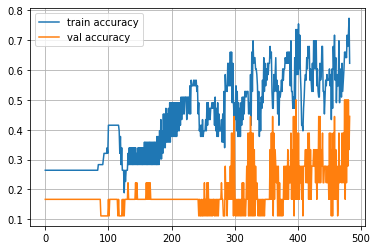

Epoch 483
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


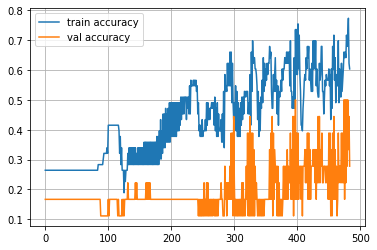

Epoch 484
Train accuracy: 0.660377358490566
Val accuracy: 0.5


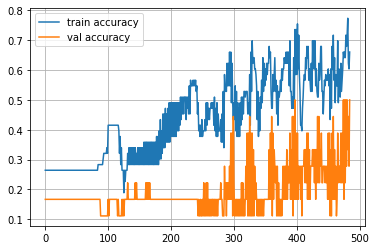

Epoch 485
Train accuracy: 0.6981132075471698
Val accuracy: 0.2222222222222222


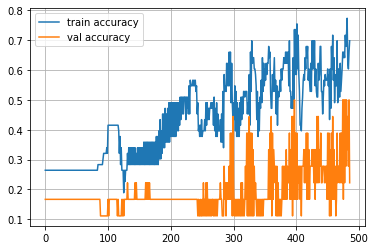

Epoch 486
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


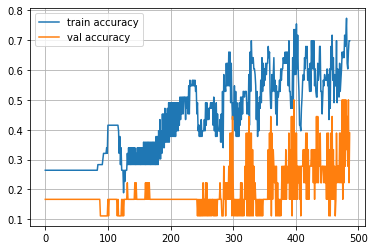

Epoch 487
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


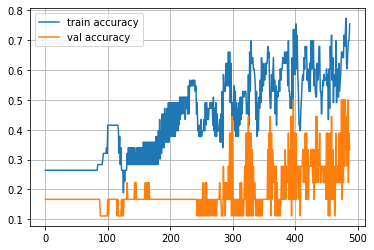

Epoch 488
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


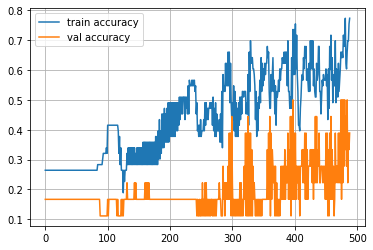

Epoch 489
Train accuracy: 0.6981132075471698
Val accuracy: 0.2222222222222222


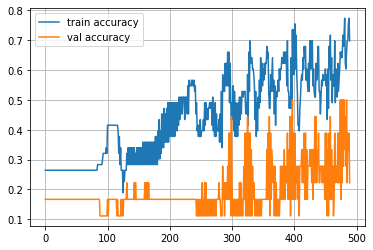

Epoch 490
Train accuracy: 0.7169811320754716
Val accuracy: 0.3888888888888889


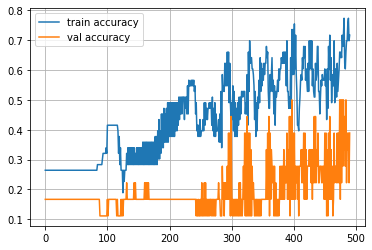

Epoch 491
Train accuracy: 0.6981132075471698
Val accuracy: 0.2222222222222222


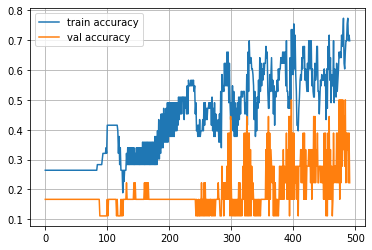

Epoch 492
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


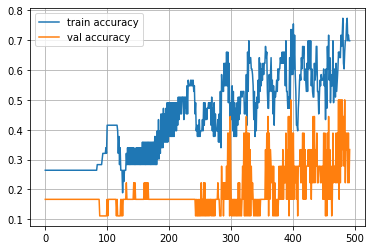

Epoch 493
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


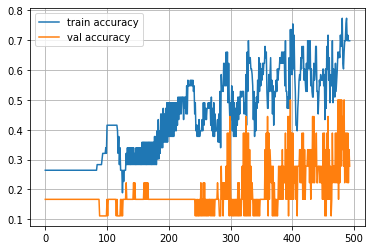

Epoch 494
Train accuracy: 0.5660377358490566
Val accuracy: 0.16666666666666666


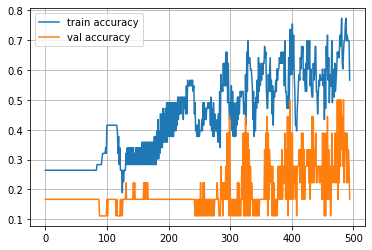

Epoch 495
Train accuracy: 0.5471698113207547
Val accuracy: 0.2777777777777778


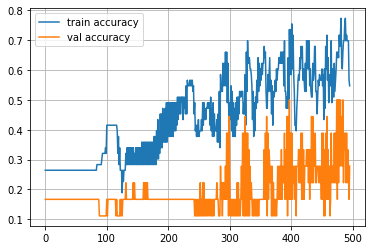

Epoch 496
Train accuracy: 0.5094339622641509
Val accuracy: 0.3333333333333333


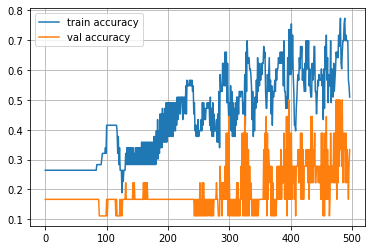

Epoch 497
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


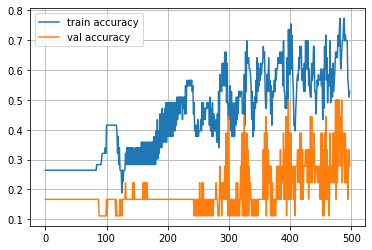

Epoch 498
Train accuracy: 0.5094339622641509
Val accuracy: 0.3333333333333333


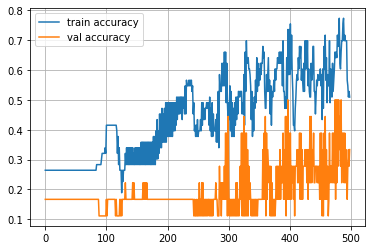

Epoch 499
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


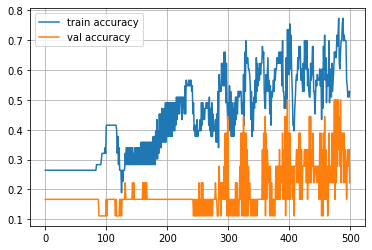

Epoch 500
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


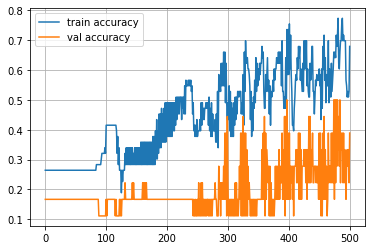

Epoch 501
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


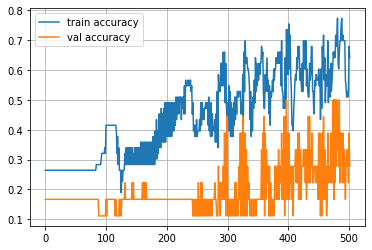

Epoch 502
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


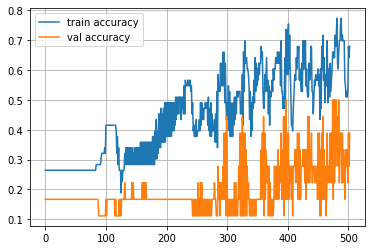

Epoch 503
Train accuracy: 0.5283018867924528
Val accuracy: 0.16666666666666666


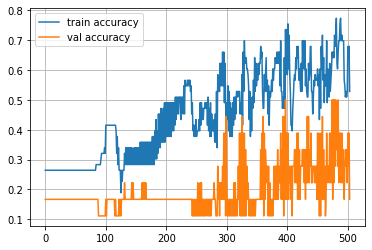

Epoch 504
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


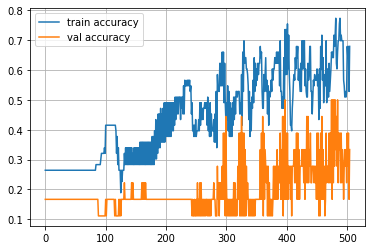

Epoch 505
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


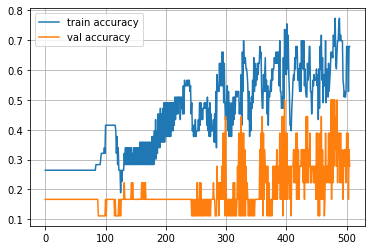

Epoch 506
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


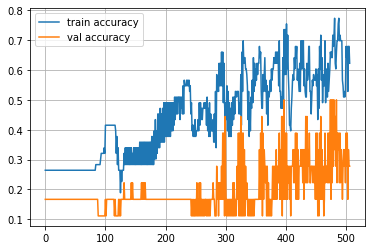

Epoch 507
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


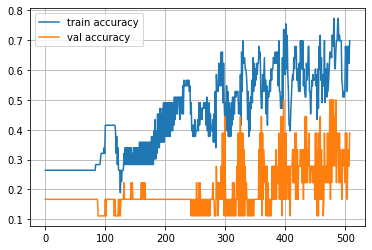

Epoch 508
Train accuracy: 0.660377358490566
Val accuracy: 0.16666666666666666


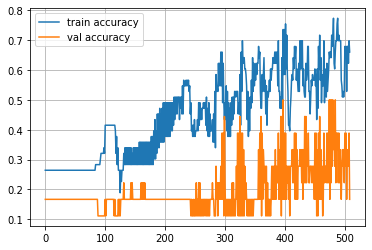

Epoch 509
Train accuracy: 0.5471698113207547
Val accuracy: 0.2777777777777778


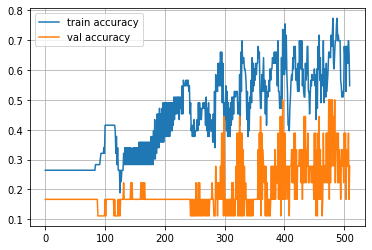

Epoch 510
Train accuracy: 0.6415094339622641
Val accuracy: 0.2222222222222222


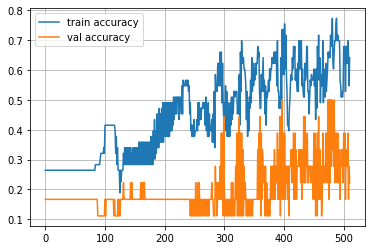

Epoch 511
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


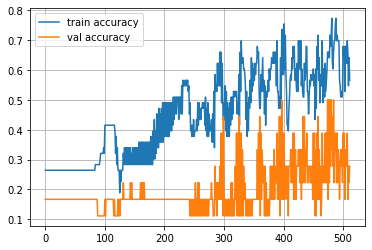

Epoch 512
Train accuracy: 0.5471698113207547
Val accuracy: 0.2777777777777778


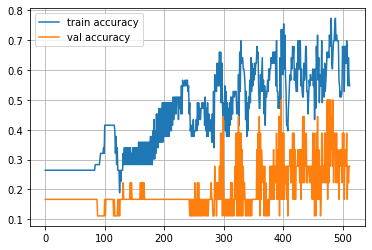

Epoch 513
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


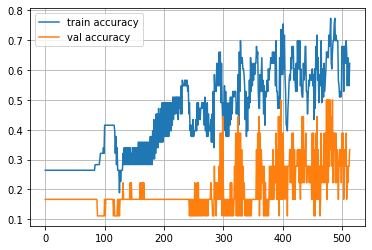

Epoch 514
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


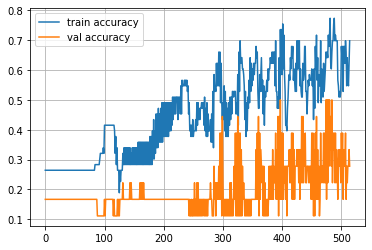

Epoch 515
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


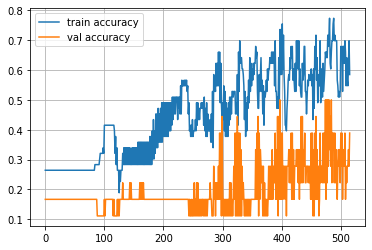

Epoch 516
Train accuracy: 0.5283018867924528
Val accuracy: 0.2222222222222222


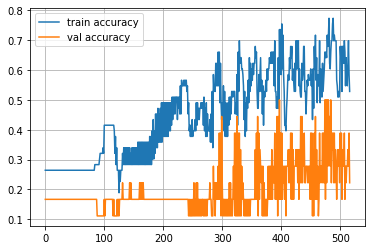

Epoch 517
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


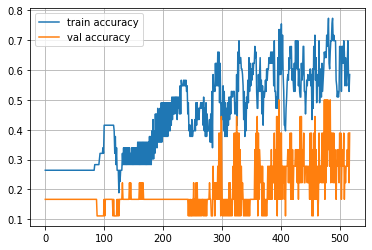

Epoch 518
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


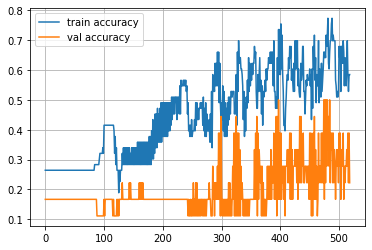

Epoch 519
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


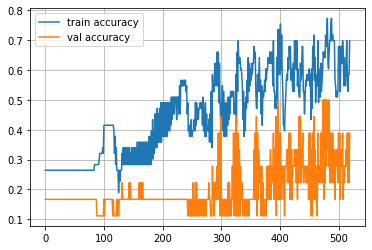

Epoch 520
Train accuracy: 0.5849056603773585
Val accuracy: 0.16666666666666666


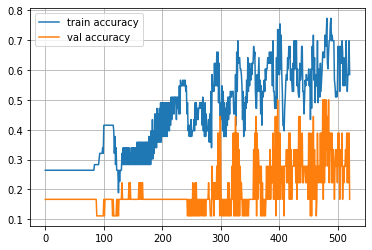

Epoch 521
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


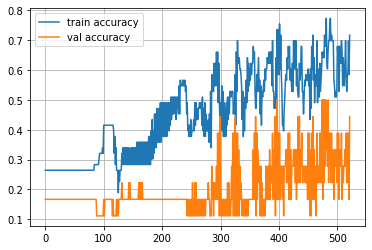

Epoch 522
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


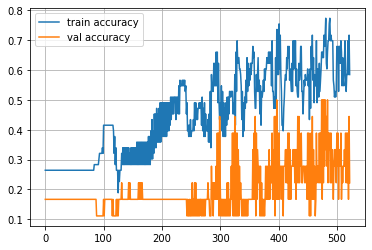

Epoch 523
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


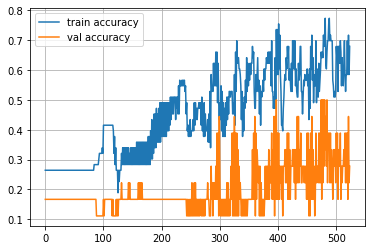

Epoch 524
Train accuracy: 0.5471698113207547
Val accuracy: 0.2222222222222222


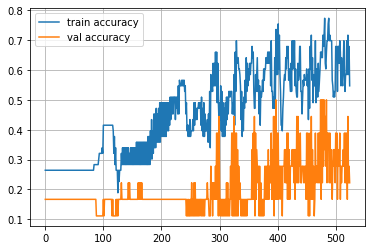

Epoch 525
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


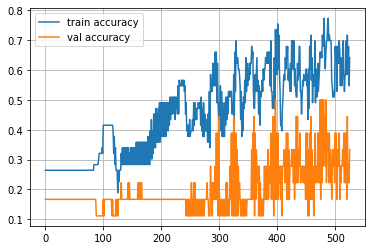

Epoch 526
Train accuracy: 0.49056603773584906
Val accuracy: 0.3333333333333333


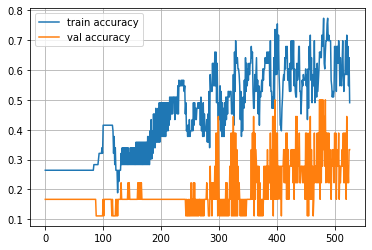

Epoch 527
Train accuracy: 0.4716981132075472
Val accuracy: 0.2777777777777778


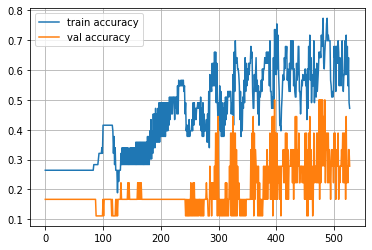

Epoch 528
Train accuracy: 0.5283018867924528
Val accuracy: 0.3888888888888889


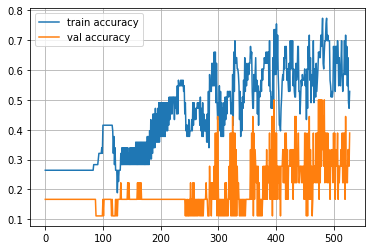

Epoch 529
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


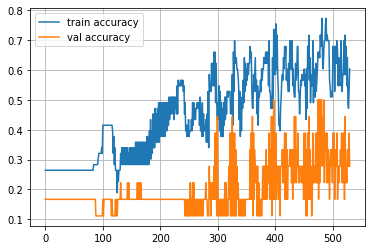

Epoch 530
Train accuracy: 0.7547169811320755
Val accuracy: 0.5555555555555556


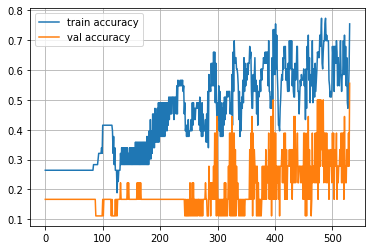

Epoch 531
Train accuracy: 0.6792452830188679
Val accuracy: 0.2222222222222222


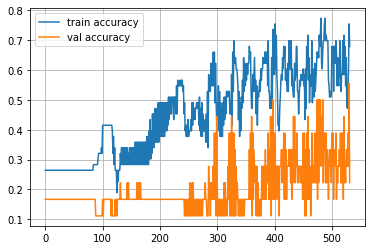

Epoch 532
Train accuracy: 0.660377358490566
Val accuracy: 0.5


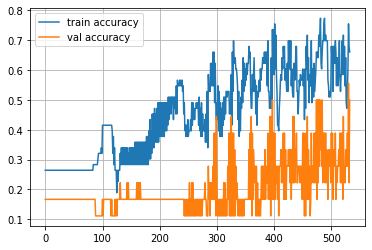

Epoch 533
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


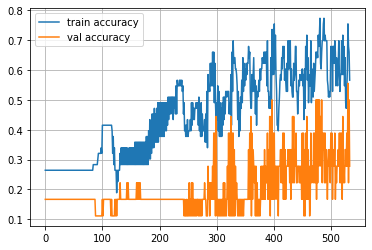

Epoch 534
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


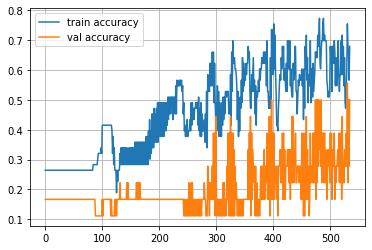

Epoch 535
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


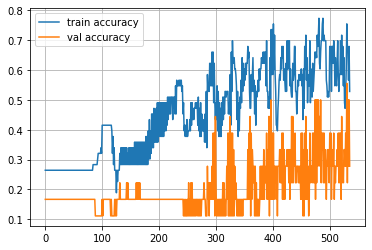

Epoch 536
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


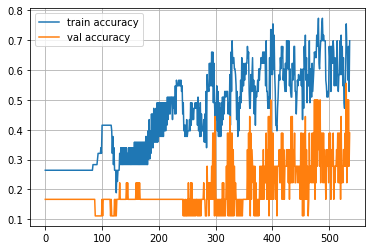

Epoch 537
Train accuracy: 0.6792452830188679
Val accuracy: 0.2222222222222222


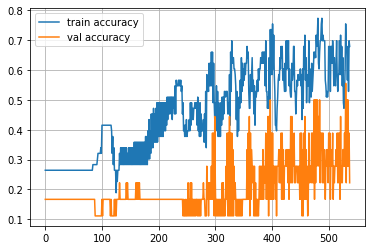

Epoch 538
Train accuracy: 0.660377358490566
Val accuracy: 0.2222222222222222


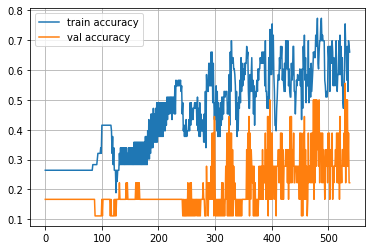

Epoch 539
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


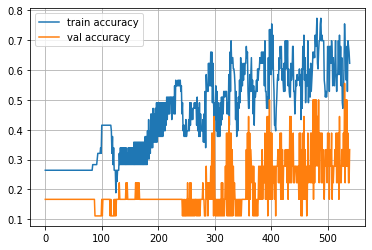

Epoch 540
Train accuracy: 0.6415094339622641
Val accuracy: 0.2222222222222222


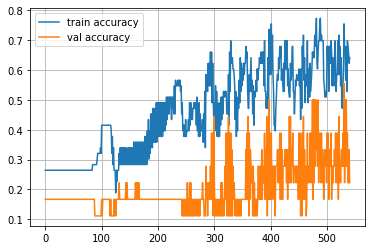

Epoch 541
Train accuracy: 0.5849056603773585
Val accuracy: 0.4444444444444444


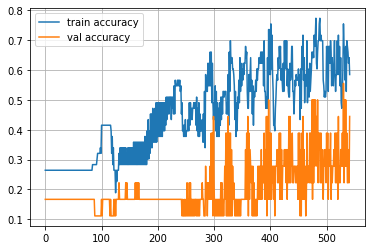

Epoch 542
Train accuracy: 0.660377358490566
Val accuracy: 0.2222222222222222


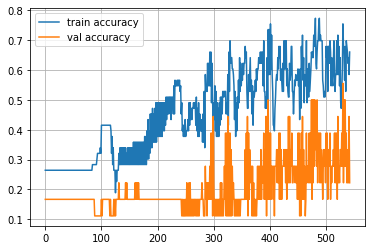

Epoch 543
Train accuracy: 0.5660377358490566
Val accuracy: 0.5555555555555556


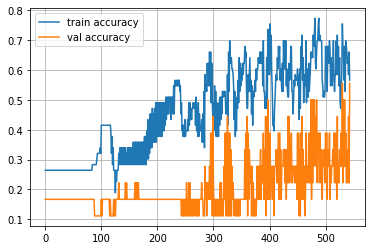

Epoch 544
Train accuracy: 0.6792452830188679
Val accuracy: 0.2222222222222222


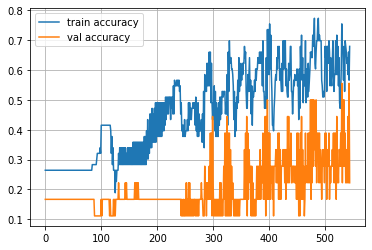

Epoch 545
Train accuracy: 0.7169811320754716
Val accuracy: 0.5555555555555556


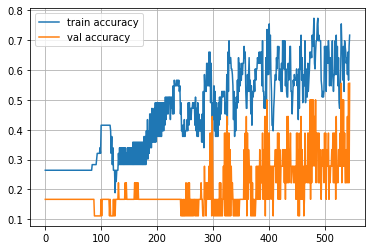

Epoch 546
Train accuracy: 0.6792452830188679
Val accuracy: 0.2222222222222222


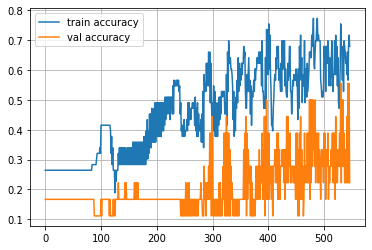

Epoch 547
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


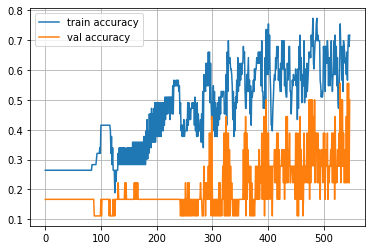

Epoch 548
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


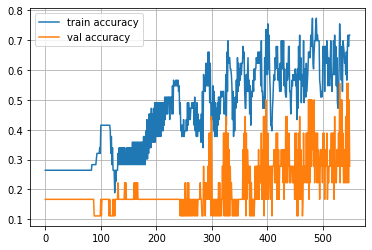

Epoch 549
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


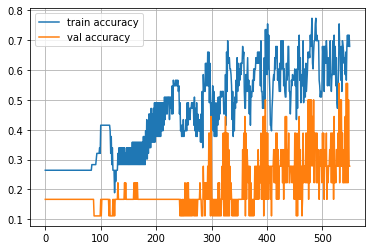

Epoch 550
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


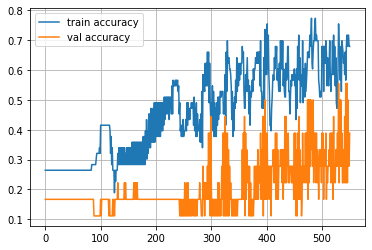

Epoch 551
Train accuracy: 0.6415094339622641
Val accuracy: 0.3888888888888889


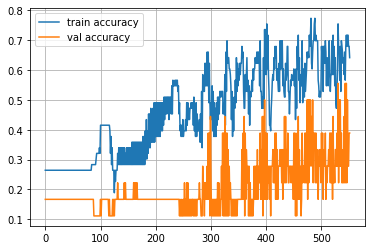

Epoch 552
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


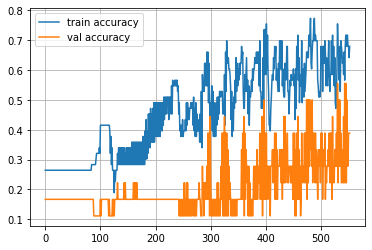

Epoch 553
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


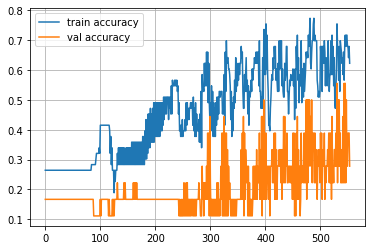

Epoch 554
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


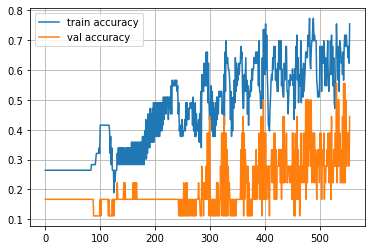

Epoch 555
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


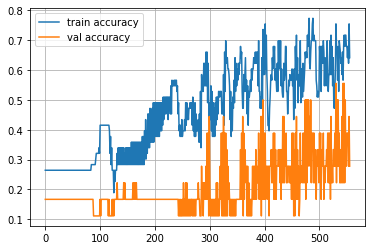

Epoch 556
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


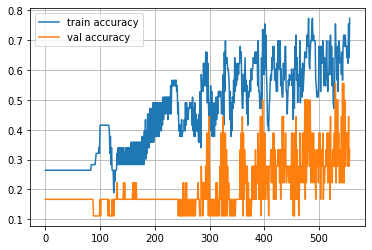

Epoch 557
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


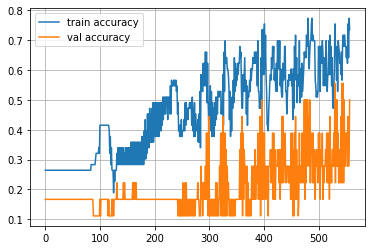

Epoch 558
Train accuracy: 0.6981132075471698
Val accuracy: 0.16666666666666666


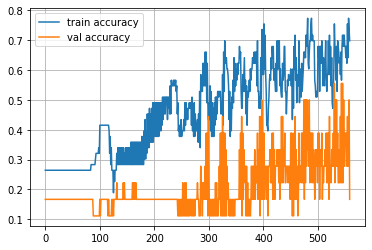

Epoch 559
Train accuracy: 0.660377358490566
Val accuracy: 0.5


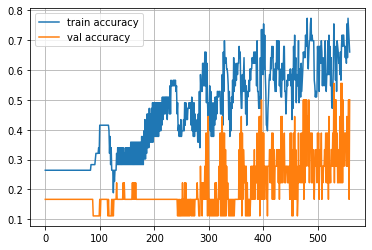

Epoch 560
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


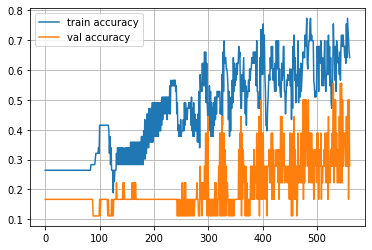

Epoch 561
Train accuracy: 0.6037735849056604
Val accuracy: 0.3888888888888889


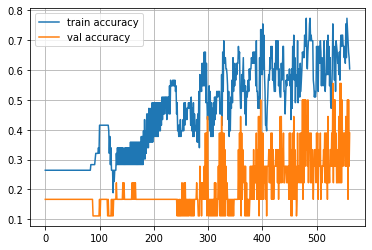

Epoch 562
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


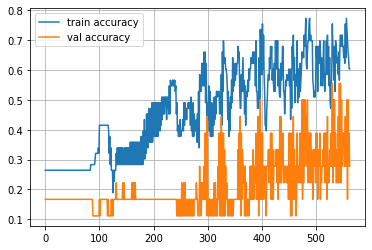

Epoch 563
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


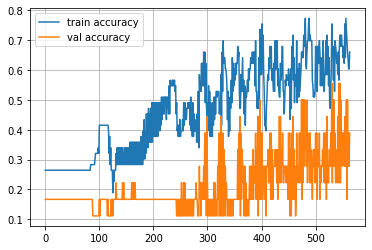

Epoch 564
Train accuracy: 0.7358490566037735
Val accuracy: 0.2777777777777778


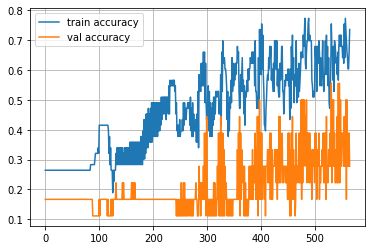

Epoch 565
Train accuracy: 0.7169811320754716
Val accuracy: 0.3888888888888889


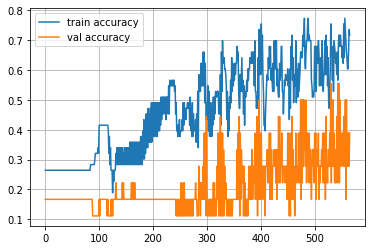

Epoch 566
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


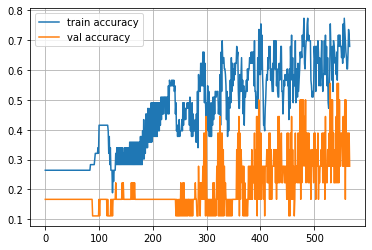

Epoch 567
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


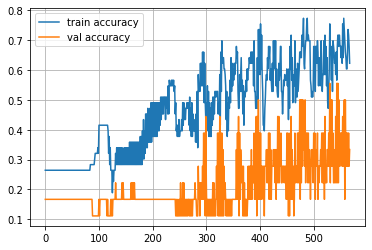

Epoch 568
Train accuracy: 0.5471698113207547
Val accuracy: 0.2222222222222222


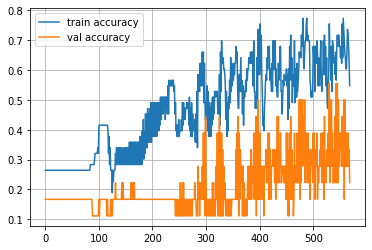

Epoch 569
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


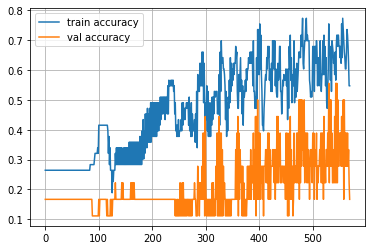

Epoch 570
Train accuracy: 0.5283018867924528
Val accuracy: 0.3333333333333333


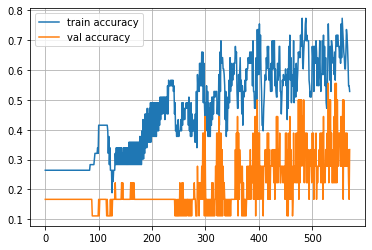

Epoch 571
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


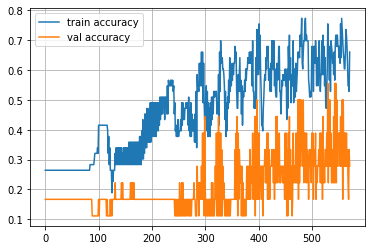

Epoch 572
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


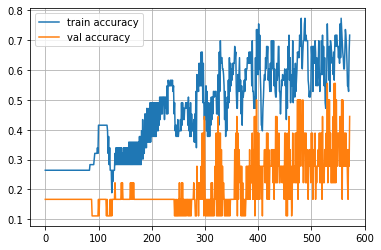

Epoch 573
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


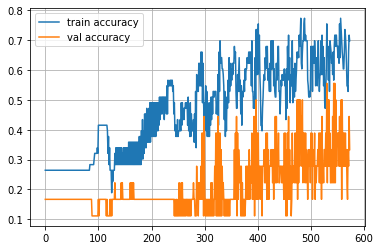

Epoch 574
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


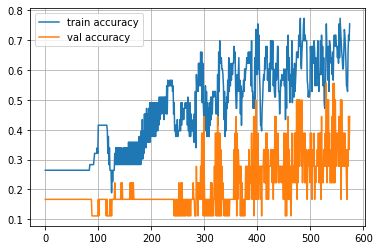

Epoch 575
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


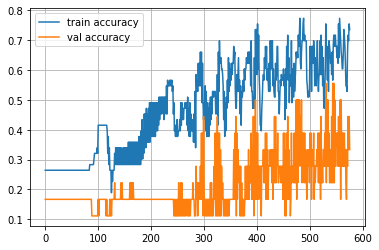

Epoch 576
Train accuracy: 0.7169811320754716
Val accuracy: 0.3333333333333333


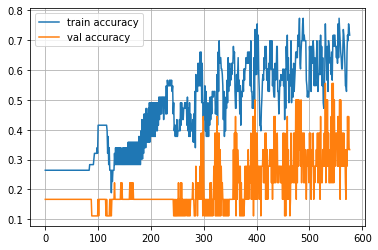

Epoch 577
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


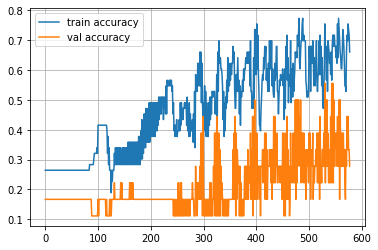

Epoch 578
Train accuracy: 0.6226415094339622
Val accuracy: 0.3888888888888889


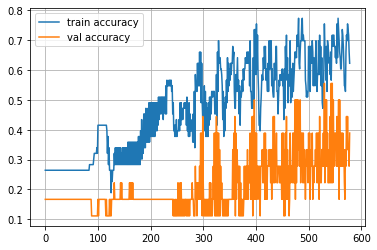

Epoch 579
Train accuracy: 0.6037735849056604
Val accuracy: 0.2777777777777778


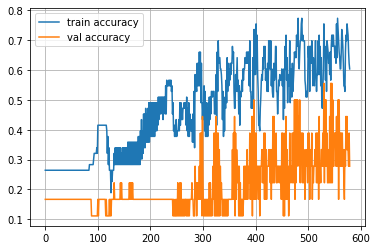

Epoch 580
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


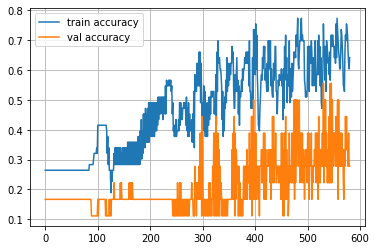

Epoch 581
Train accuracy: 0.6037735849056604
Val accuracy: 0.3333333333333333


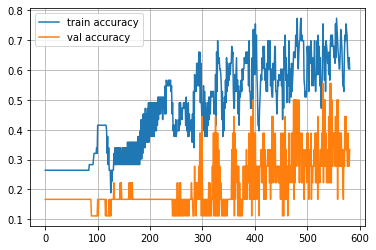

Epoch 582
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


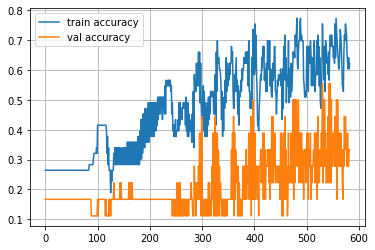

Epoch 583
Train accuracy: 0.6226415094339622
Val accuracy: 0.3888888888888889


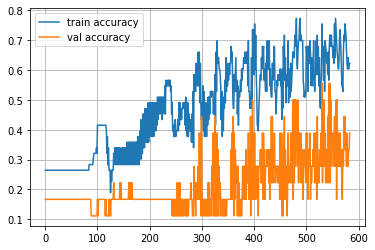

Epoch 584
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


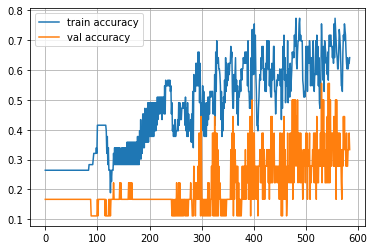

Epoch 585
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


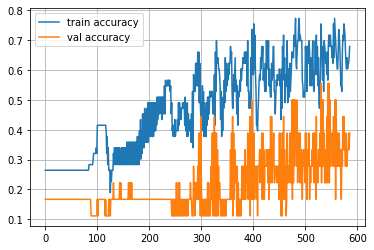

Epoch 586
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


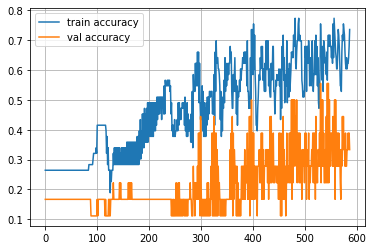

Epoch 587
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


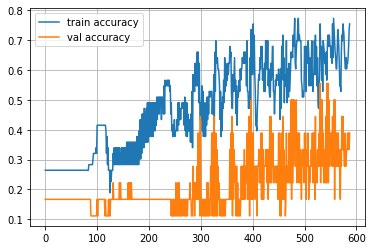

Epoch 588
Train accuracy: 0.7358490566037735
Val accuracy: 0.2222222222222222


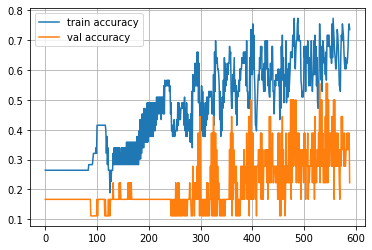

Epoch 589
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


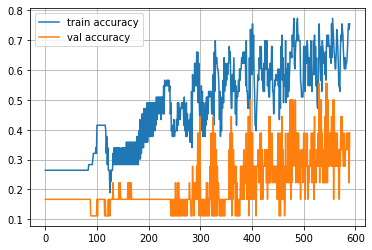

Epoch 590
Train accuracy: 0.7547169811320755
Val accuracy: 0.2777777777777778


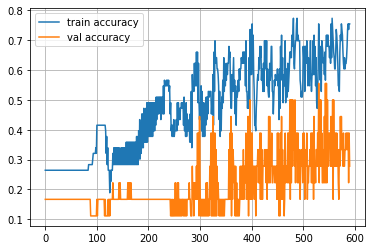

Epoch 591
Train accuracy: 0.7735849056603774
Val accuracy: 0.5


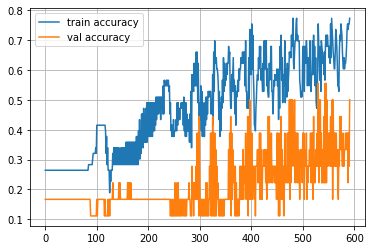

Epoch 592
Train accuracy: 0.7547169811320755
Val accuracy: 0.2777777777777778


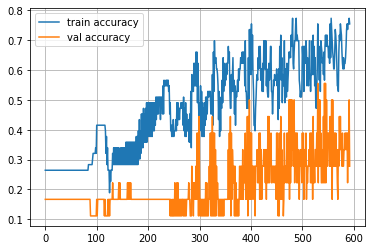

Epoch 593
Train accuracy: 0.7547169811320755
Val accuracy: 0.5


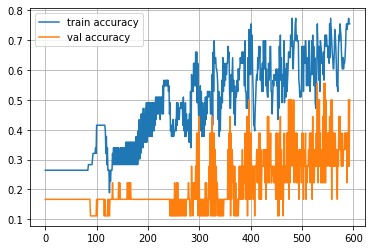

Epoch 594
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


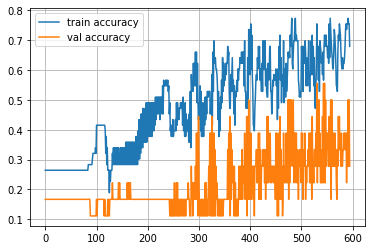

Epoch 595
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


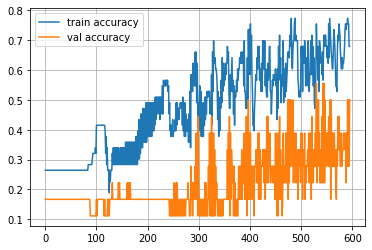

Epoch 596
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


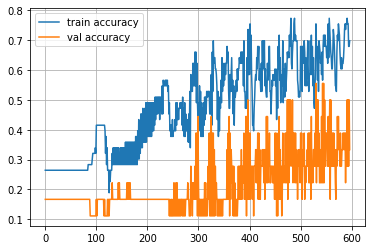

Epoch 597
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


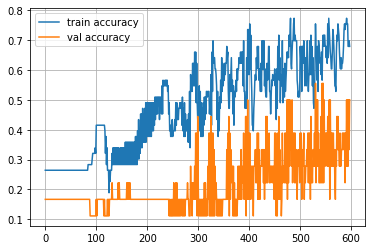

Epoch 598
Train accuracy: 0.660377358490566
Val accuracy: 0.3333333333333333


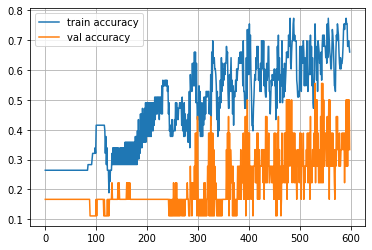

Epoch 599
Train accuracy: 0.5660377358490566
Val accuracy: 0.4444444444444444


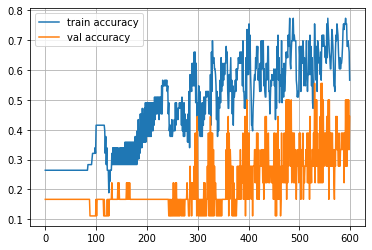

Epoch 600
Train accuracy: 0.6037735849056604
Val accuracy: 0.16666666666666666


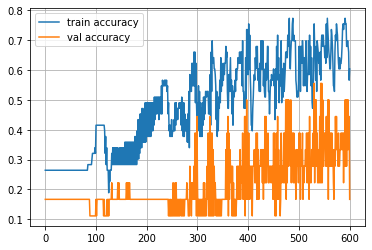

Epoch 601
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


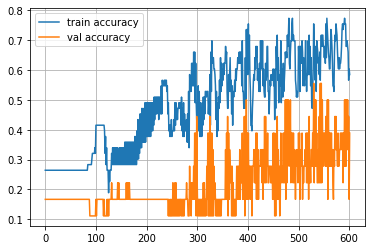

Epoch 602
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


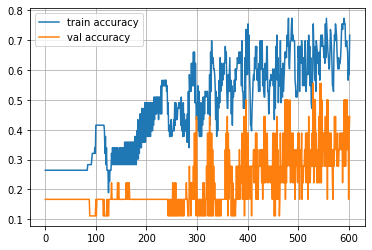

Epoch 603
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


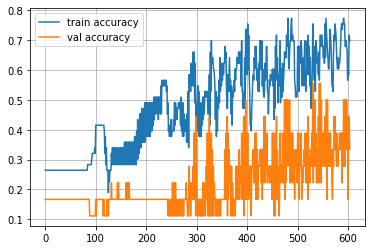

Epoch 604
Train accuracy: 0.660377358490566
Val accuracy: 0.3333333333333333


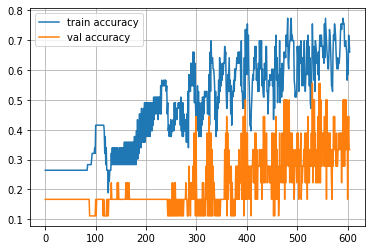

Epoch 605
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


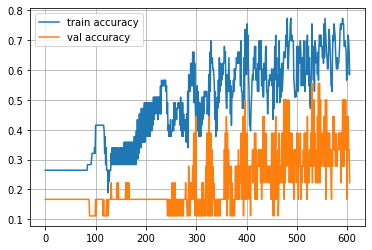

Epoch 606
Train accuracy: 0.5660377358490566
Val accuracy: 0.5


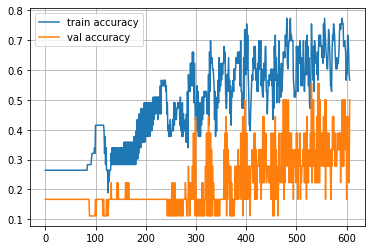

Epoch 607
Train accuracy: 0.6226415094339622
Val accuracy: 0.2222222222222222


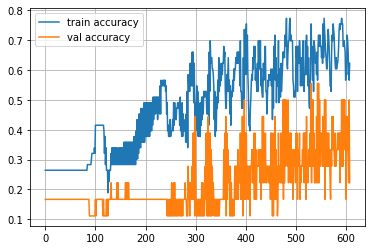

Epoch 608
Train accuracy: 0.6981132075471698
Val accuracy: 0.5555555555555556


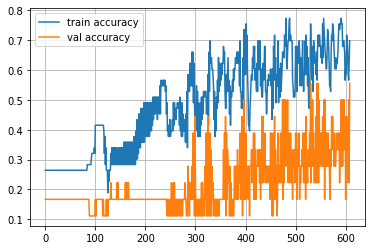

Epoch 609
Train accuracy: 0.6981132075471698
Val accuracy: 0.2222222222222222


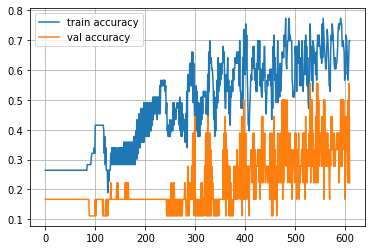

Epoch 610
Train accuracy: 0.7358490566037735
Val accuracy: 0.2222222222222222


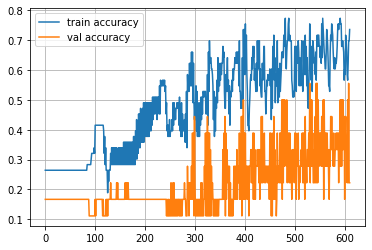

Epoch 611
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


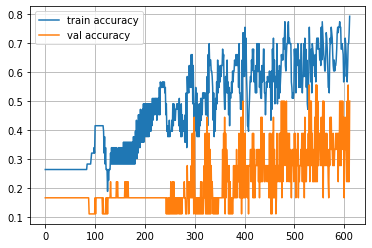

Epoch 612
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


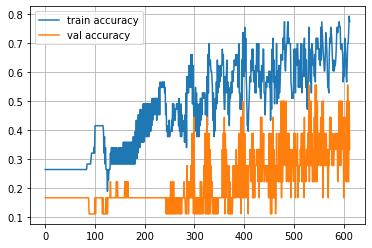

Epoch 613
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


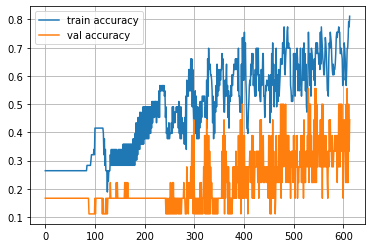

Epoch 614
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


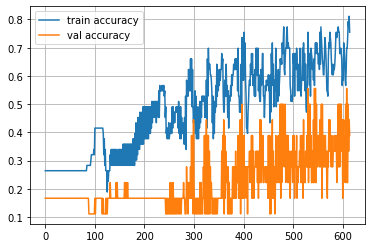

Epoch 615
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


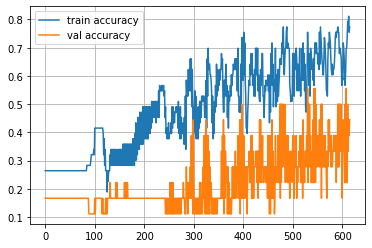

Epoch 616
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


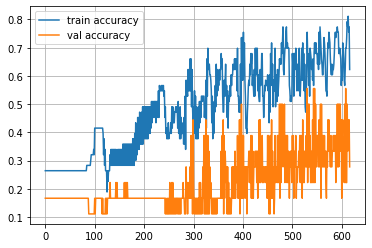

Epoch 617
Train accuracy: 0.4716981132075472
Val accuracy: 0.2222222222222222


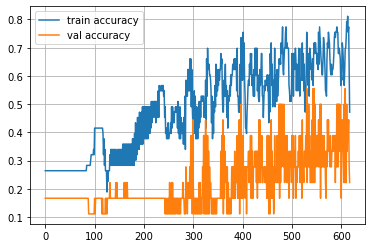

Epoch 618
Train accuracy: 0.4528301886792453
Val accuracy: 0.3888888888888889


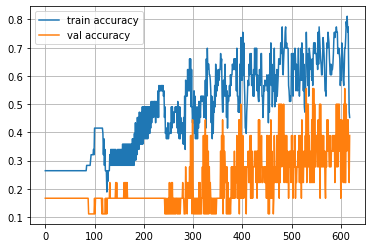

Epoch 619
Train accuracy: 0.5094339622641509
Val accuracy: 0.1111111111111111


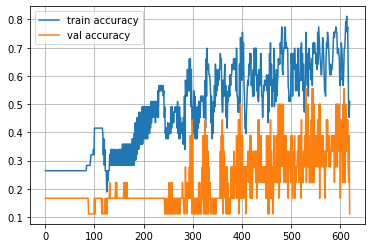

Epoch 620
Train accuracy: 0.660377358490566
Val accuracy: 0.5


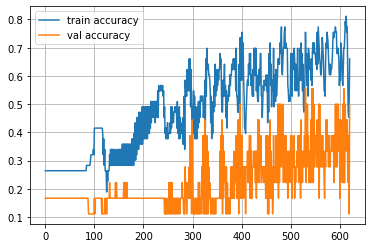

Epoch 621
Train accuracy: 0.49056603773584906
Val accuracy: 0.2777777777777778


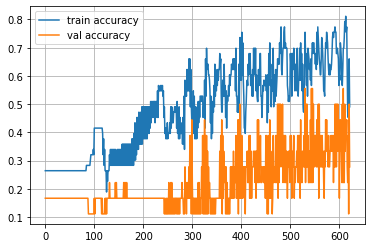

Epoch 622
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


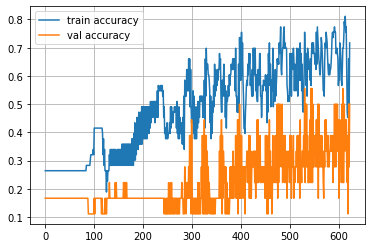

Epoch 623
Train accuracy: 0.660377358490566
Val accuracy: 0.16666666666666666


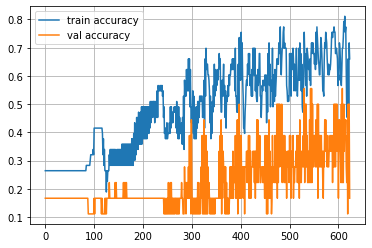

Epoch 624
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


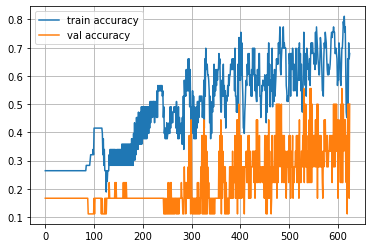

Epoch 625
Train accuracy: 0.5471698113207547
Val accuracy: 0.16666666666666666


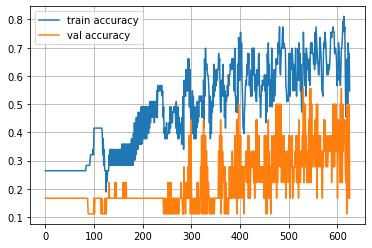

Epoch 626
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


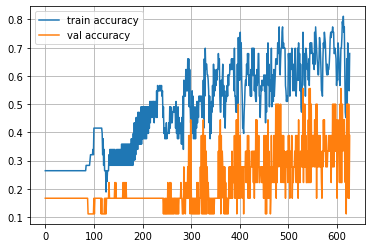

Epoch 627
Train accuracy: 0.6792452830188679
Val accuracy: 0.1111111111111111


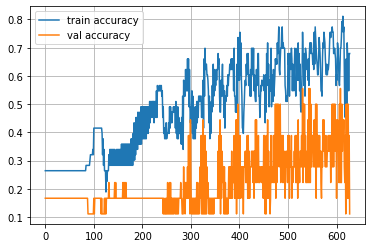

Epoch 628
Train accuracy: 0.6226415094339622
Val accuracy: 0.2222222222222222


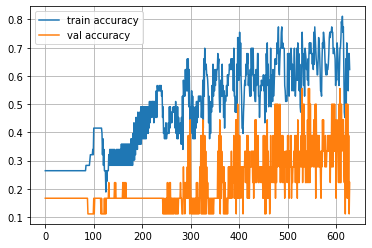

Epoch 629
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


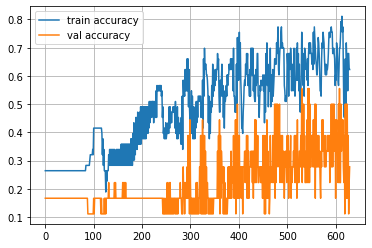

Epoch 630
Train accuracy: 0.6037735849056604
Val accuracy: 0.3888888888888889


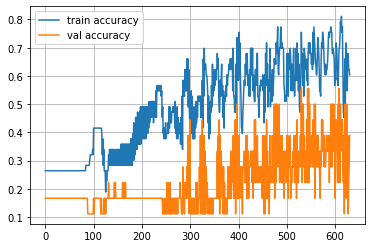

Epoch 631
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


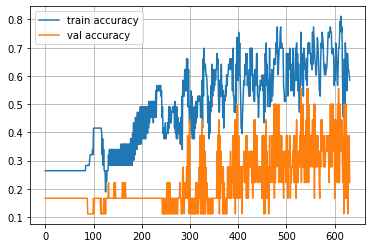

Epoch 632
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


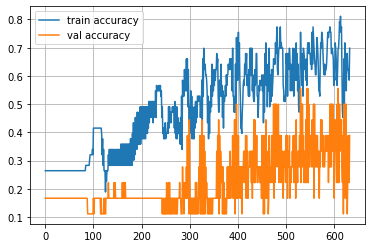

Epoch 633
Train accuracy: 0.7735849056603774
Val accuracy: 0.2777777777777778


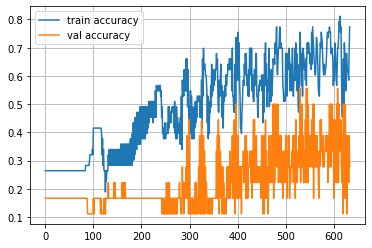

Epoch 634
Train accuracy: 0.7169811320754716
Val accuracy: 0.3888888888888889


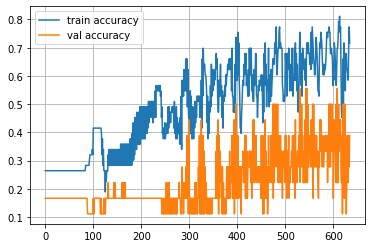

Epoch 635
Train accuracy: 0.7169811320754716
Val accuracy: 0.2222222222222222


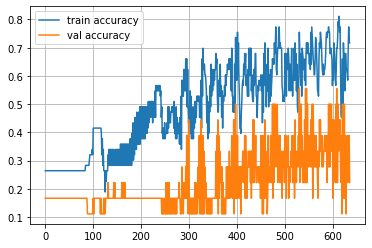

Epoch 636
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


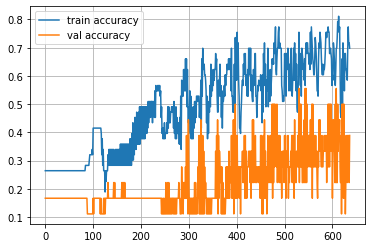

Epoch 637
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


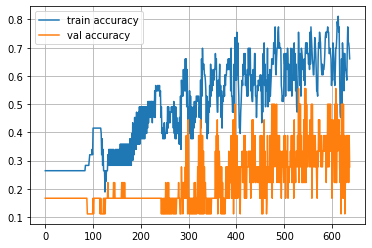

Epoch 638
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


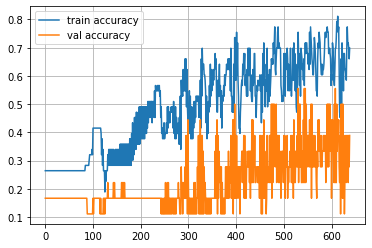

Epoch 639
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


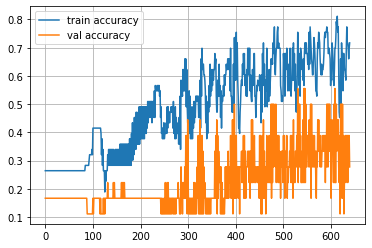

Epoch 640
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


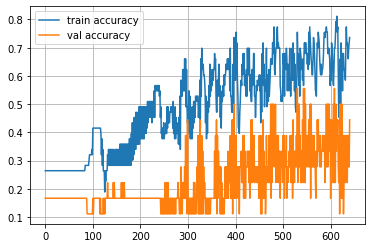

Epoch 641
Train accuracy: 0.7169811320754716
Val accuracy: 0.3333333333333333


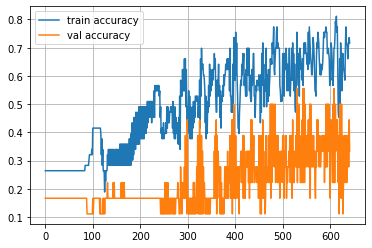

Epoch 642
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


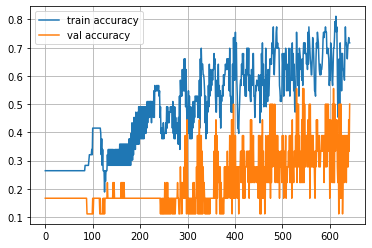

Epoch 643
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


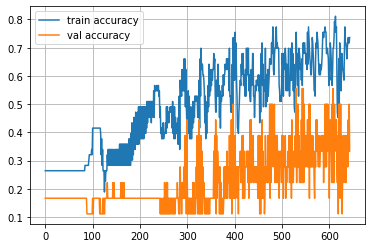

Epoch 644
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


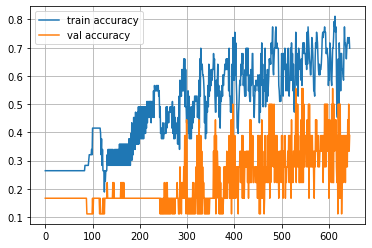

Epoch 645
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


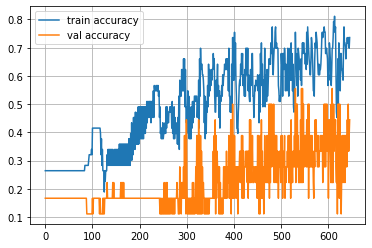

Epoch 646
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


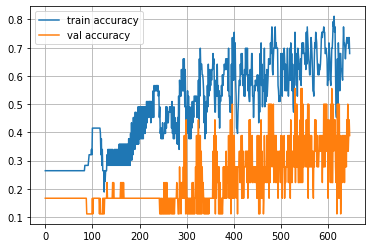

Epoch 647
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


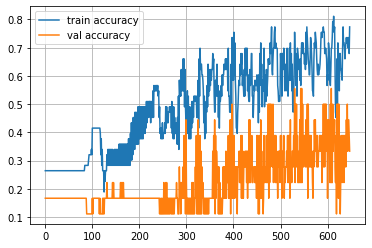

Epoch 648
Train accuracy: 0.7169811320754716
Val accuracy: 0.3888888888888889


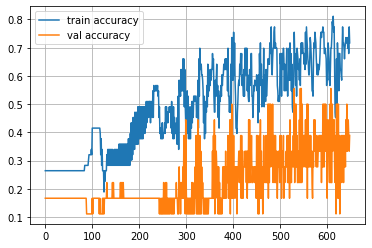

Epoch 649
Train accuracy: 0.7169811320754716
Val accuracy: 0.3333333333333333


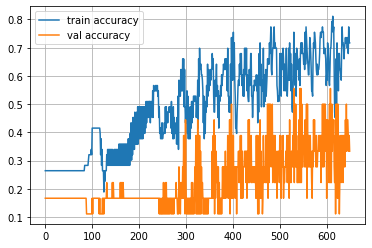

Epoch 650
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


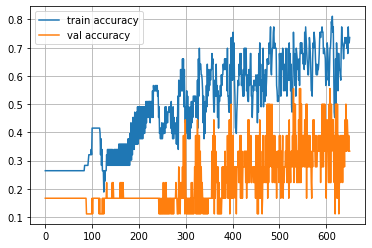

Epoch 651
Train accuracy: 0.6415094339622641
Val accuracy: 0.3888888888888889


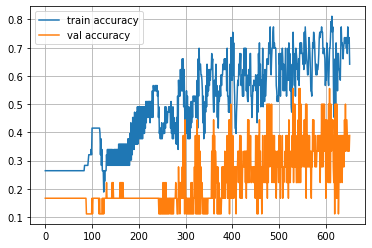

Epoch 652
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


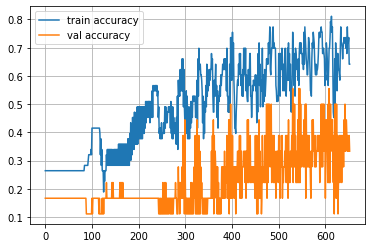

Epoch 653
Train accuracy: 0.5849056603773585
Val accuracy: 0.2777777777777778


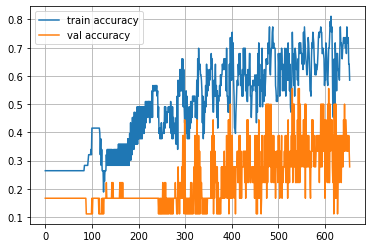

Epoch 654
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


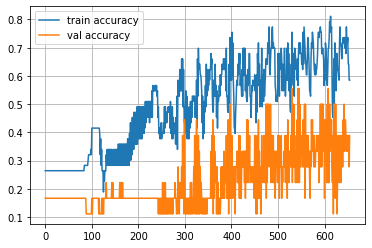

Epoch 655
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


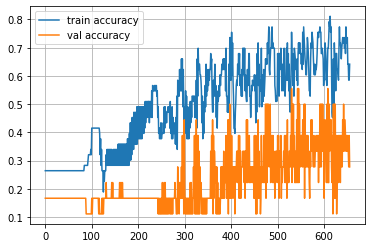

Epoch 656
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


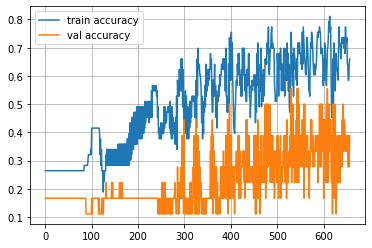

Epoch 657
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


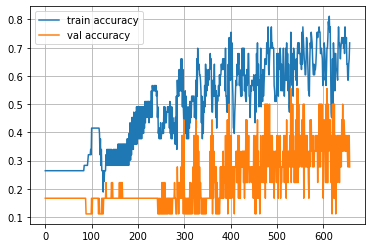

Epoch 658
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


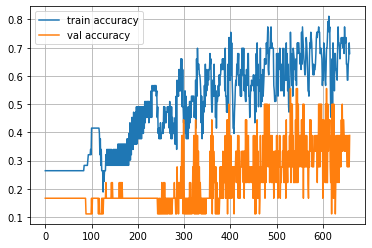

Epoch 659
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


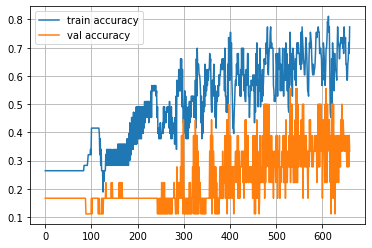

Epoch 660
Train accuracy: 0.7169811320754716
Val accuracy: 0.3888888888888889


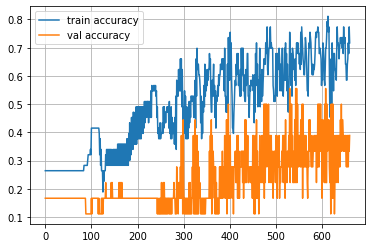

Epoch 661
Train accuracy: 0.7358490566037735
Val accuracy: 0.2222222222222222


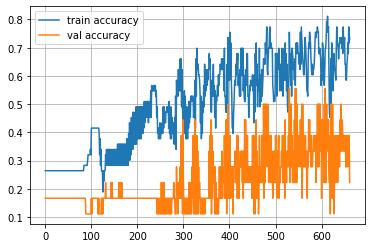

Epoch 662
Train accuracy: 0.7169811320754716
Val accuracy: 0.5555555555555556


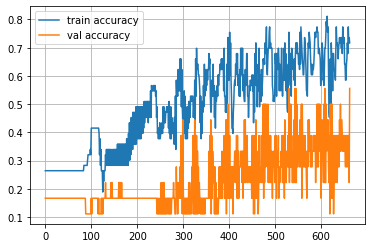

Epoch 663
Train accuracy: 0.6415094339622641
Val accuracy: 0.1111111111111111


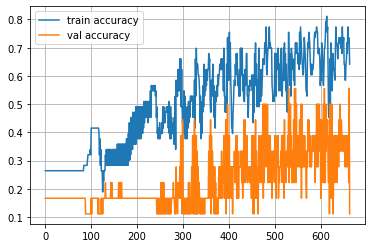

Epoch 664
Train accuracy: 0.660377358490566
Val accuracy: 0.5555555555555556


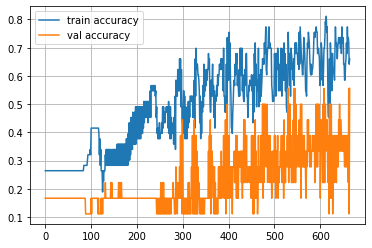

Epoch 665
Train accuracy: 0.6792452830188679
Val accuracy: 0.2222222222222222


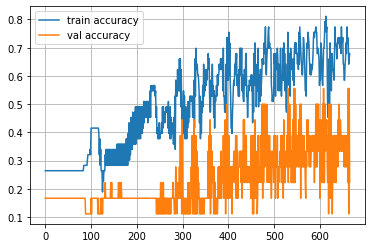

Epoch 666
Train accuracy: 0.7169811320754716
Val accuracy: 0.6111111111111112


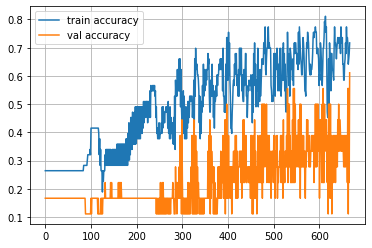

Epoch 667
Train accuracy: 0.7169811320754716
Val accuracy: 0.2222222222222222


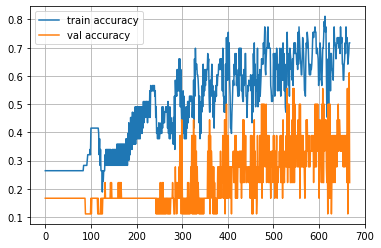

Epoch 668
Train accuracy: 0.6981132075471698
Val accuracy: 0.6111111111111112


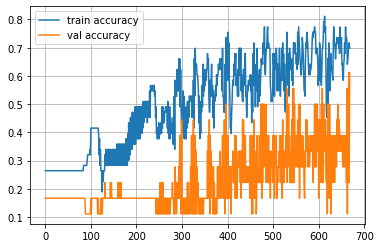

Epoch 669
Train accuracy: 0.7169811320754716
Val accuracy: 0.3333333333333333


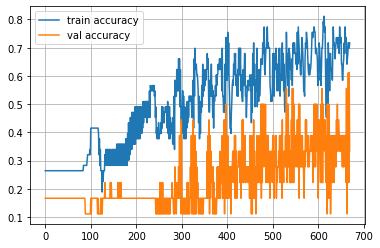

Epoch 670
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


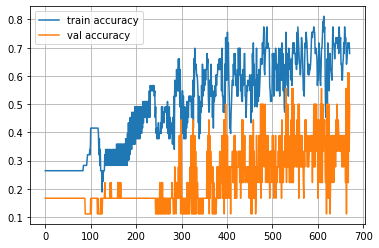

Epoch 671
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


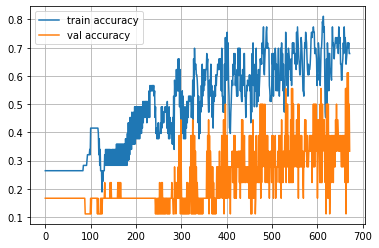

Epoch 672
Train accuracy: 0.6981132075471698
Val accuracy: 0.5


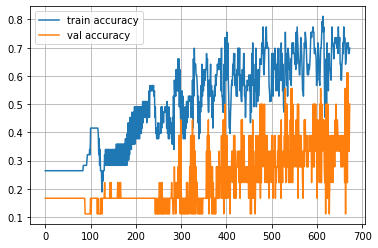

Epoch 673
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


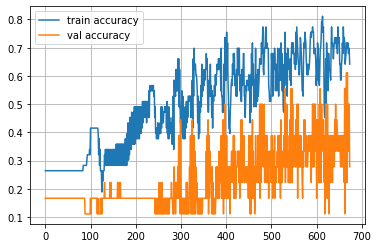

Epoch 674
Train accuracy: 0.6792452830188679
Val accuracy: 0.4444444444444444


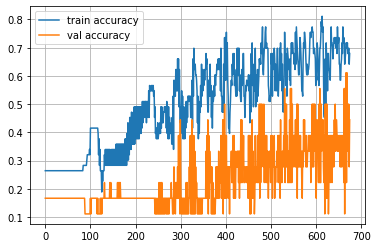

Epoch 675
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


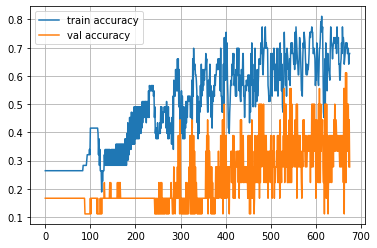

Epoch 676
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


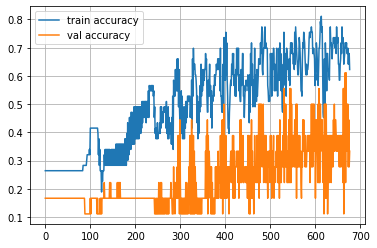

Epoch 677
Train accuracy: 0.6037735849056604
Val accuracy: 0.3888888888888889


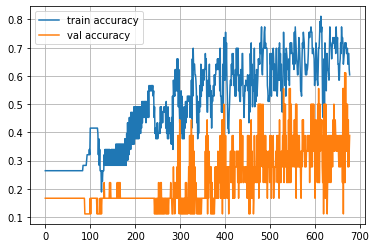

Epoch 678
Train accuracy: 0.5849056603773585
Val accuracy: 0.2777777777777778


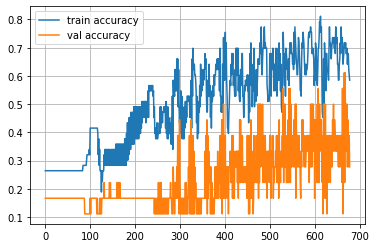

Epoch 679
Train accuracy: 0.5471698113207547
Val accuracy: 0.3888888888888889


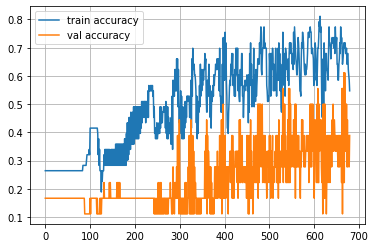

Epoch 680
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


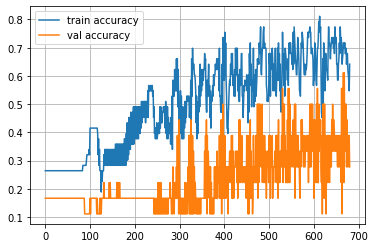

Epoch 681
Train accuracy: 0.6792452830188679
Val accuracy: 0.4444444444444444


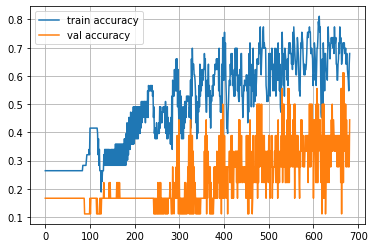

Epoch 682
Train accuracy: 0.6415094339622641
Val accuracy: 0.2222222222222222


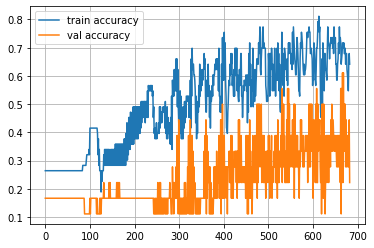

Epoch 683
Train accuracy: 0.7358490566037735
Val accuracy: 0.5555555555555556


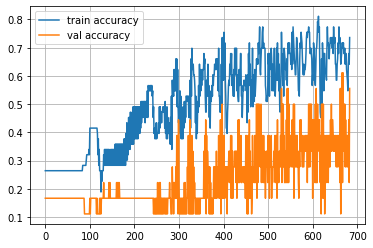

Epoch 684
Train accuracy: 0.7547169811320755
Val accuracy: 0.2777777777777778


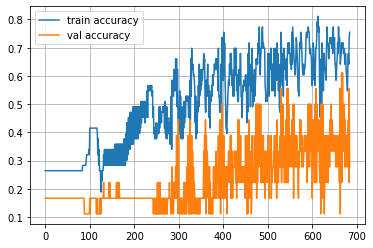

Epoch 685
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


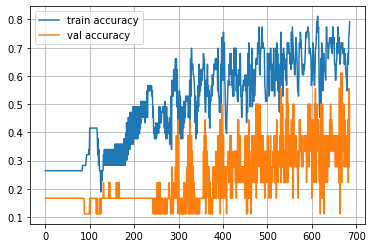

Epoch 686
Train accuracy: 0.7358490566037735
Val accuracy: 0.2777777777777778


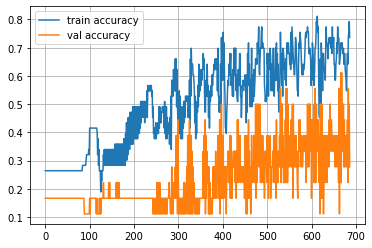

Epoch 687
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


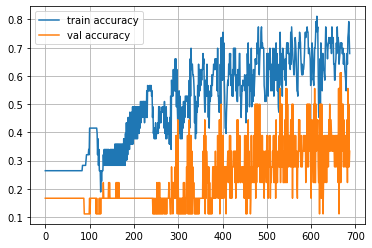

Epoch 688
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


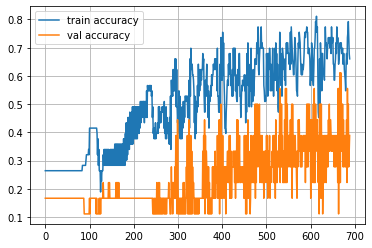

Epoch 689
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


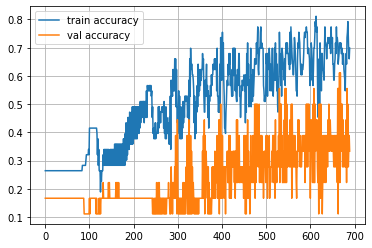

Epoch 690
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


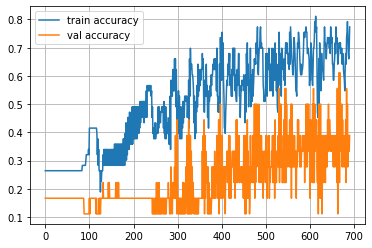

Epoch 691
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


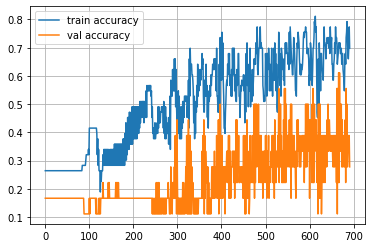

Epoch 692
Train accuracy: 0.660377358490566
Val accuracy: 0.3333333333333333


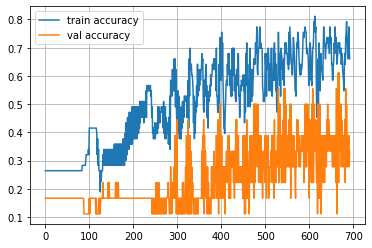

Epoch 693
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


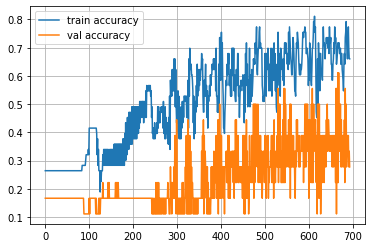

Epoch 694
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


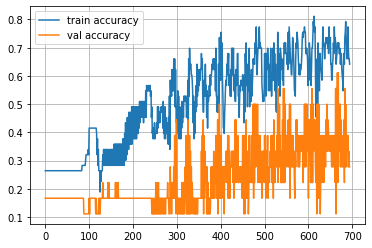

Epoch 695
Train accuracy: 0.6226415094339622
Val accuracy: 0.3888888888888889


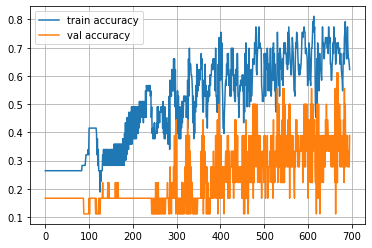

Epoch 696
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


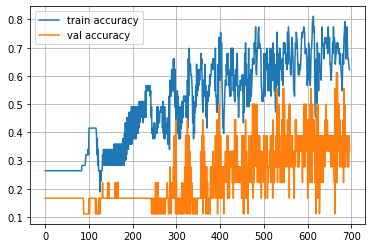

Epoch 697
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


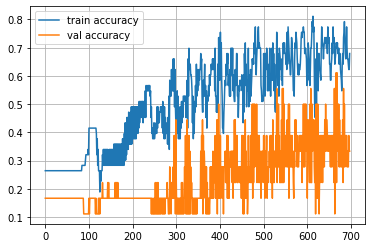

Epoch 698
Train accuracy: 0.6226415094339622
Val accuracy: 0.3888888888888889


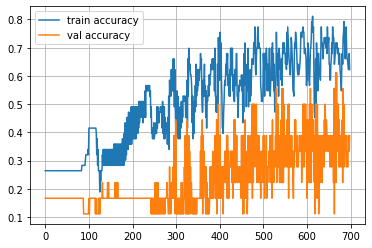

Epoch 699
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


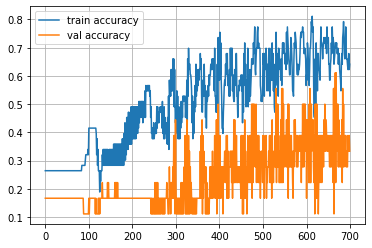

Epoch 700
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


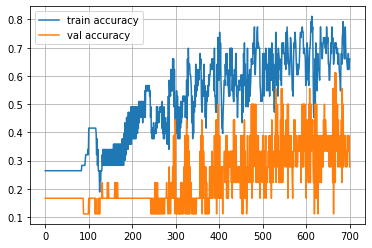

Epoch 701
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


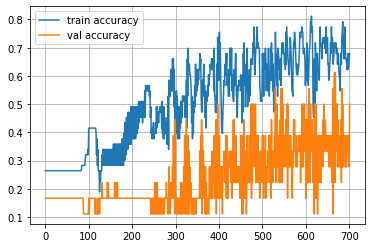

Epoch 702
Train accuracy: 0.7358490566037735
Val accuracy: 0.16666666666666666


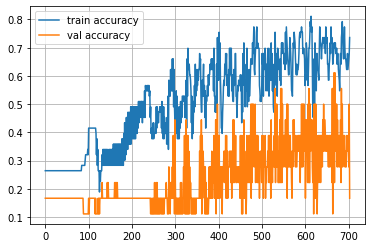

Epoch 703
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


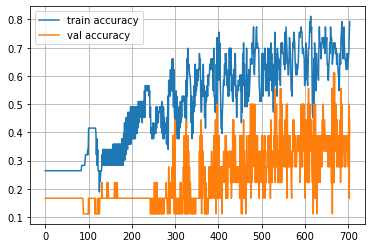

Epoch 704
Train accuracy: 0.6981132075471698
Val accuracy: 0.2222222222222222


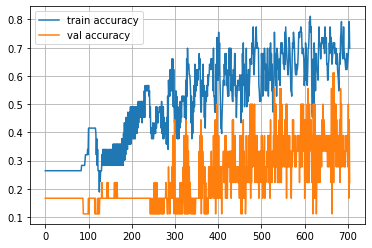

Epoch 705
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


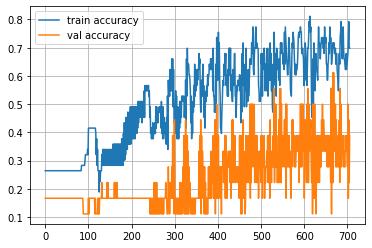

Epoch 706
Train accuracy: 0.5283018867924528
Val accuracy: 0.2777777777777778


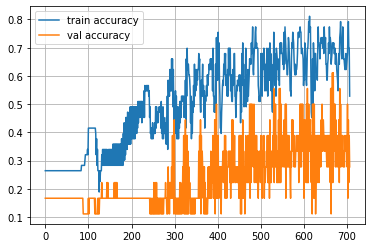

Epoch 707
Train accuracy: 0.5660377358490566
Val accuracy: 0.2777777777777778


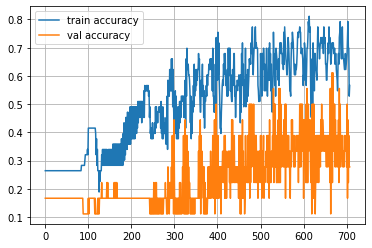

Epoch 708
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


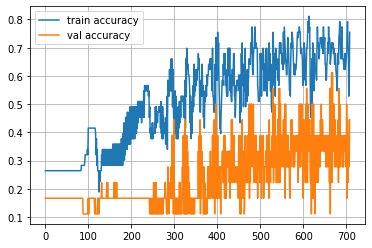

Epoch 709
Train accuracy: 0.6981132075471698
Val accuracy: 0.2222222222222222


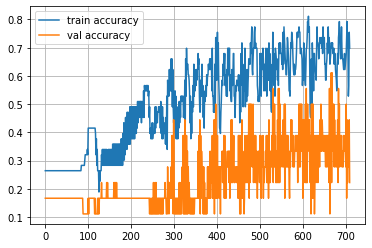

Epoch 710
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


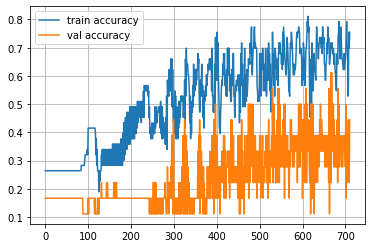

Epoch 711
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


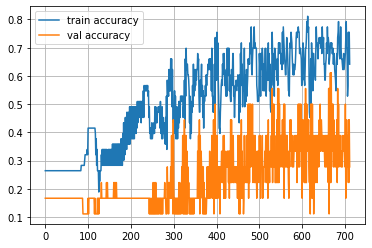

Epoch 712
Train accuracy: 0.5660377358490566
Val accuracy: 0.3888888888888889


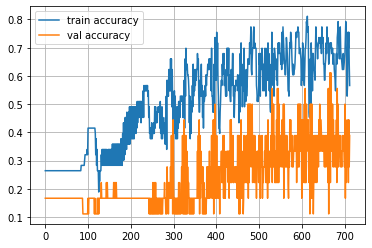

Epoch 713
Train accuracy: 0.5849056603773585
Val accuracy: 0.2222222222222222


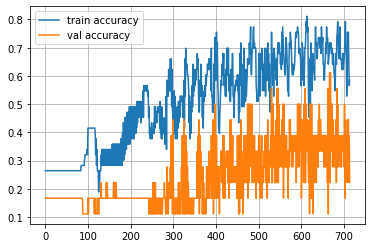

Epoch 714
Train accuracy: 0.5849056603773585
Val accuracy: 0.3888888888888889


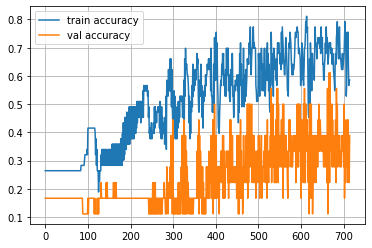

Epoch 715
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


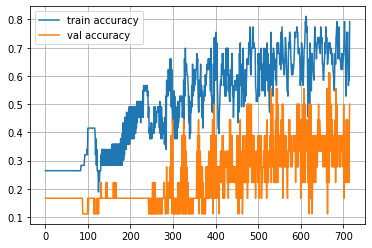

Epoch 716
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


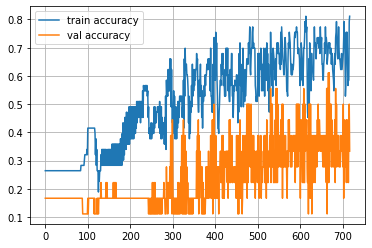

Epoch 717
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


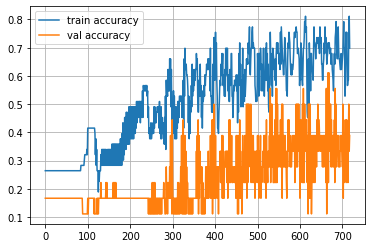

Epoch 718
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


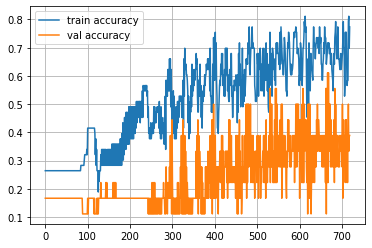

Epoch 719
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


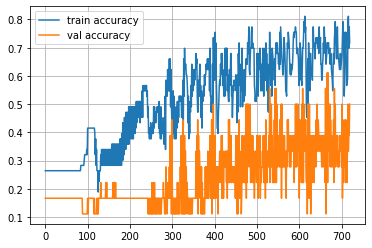

Epoch 720
Train accuracy: 0.660377358490566
Val accuracy: 0.3333333333333333


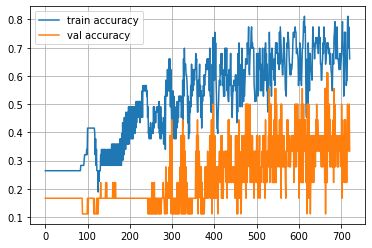

Epoch 721
Train accuracy: 0.6792452830188679
Val accuracy: 0.5


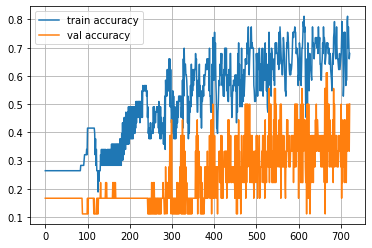

Epoch 722
Train accuracy: 0.660377358490566
Val accuracy: 0.2777777777777778


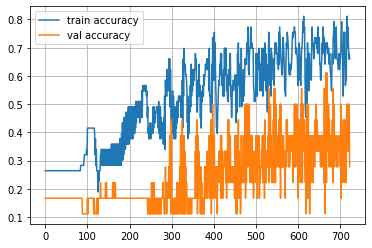

Epoch 723
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


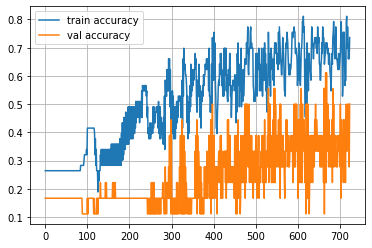

Epoch 724
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


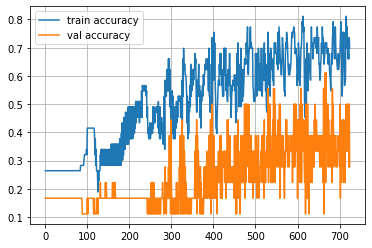

Epoch 725
Train accuracy: 0.7924528301886793
Val accuracy: 0.5555555555555556


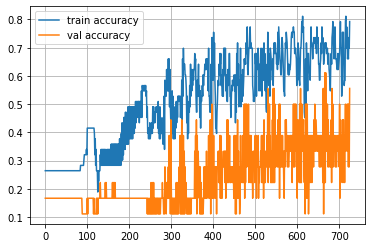

Epoch 726
Train accuracy: 0.7169811320754716
Val accuracy: 0.2222222222222222


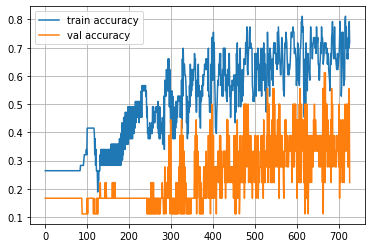

Epoch 727
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


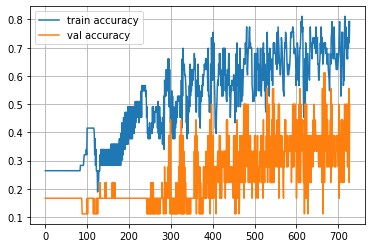

Epoch 728
Train accuracy: 0.7735849056603774
Val accuracy: 0.2777777777777778


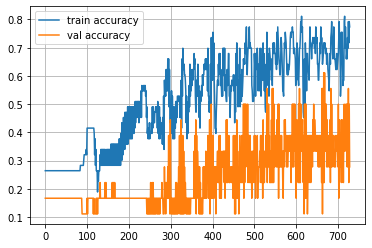

Epoch 729
Train accuracy: 0.7547169811320755
Val accuracy: 0.5


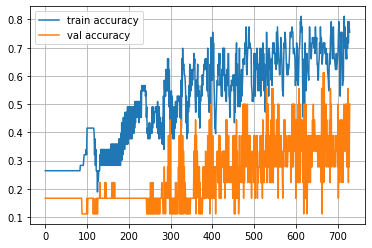

Epoch 730
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


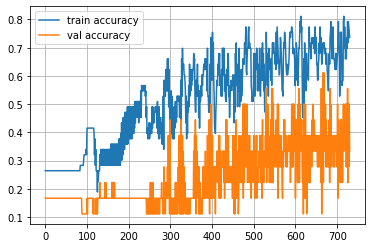

Epoch 731
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


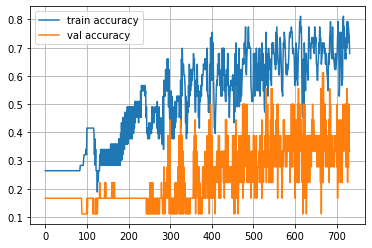

Epoch 732
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


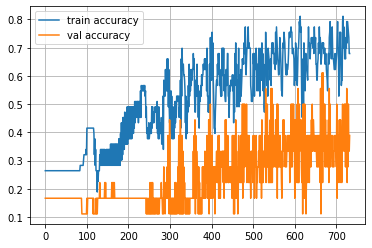

Epoch 733
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


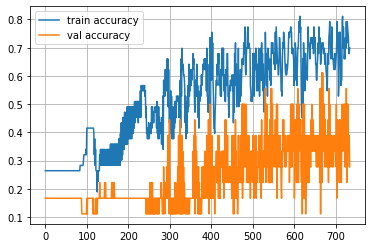

Epoch 734
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


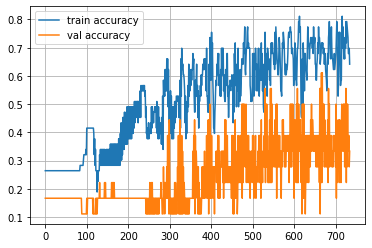

Epoch 735
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


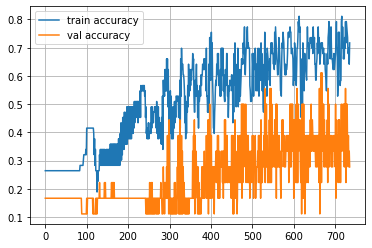

Epoch 736
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


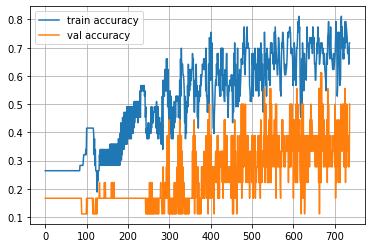

Epoch 737
Train accuracy: 0.7169811320754716
Val accuracy: 0.2222222222222222


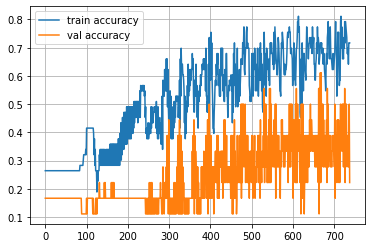

Epoch 738
Train accuracy: 0.7169811320754716
Val accuracy: 0.5555555555555556


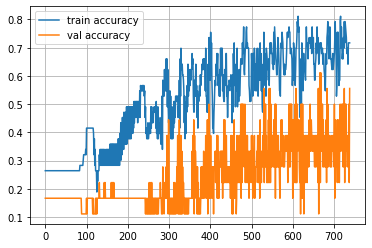

Epoch 739
Train accuracy: 0.660377358490566
Val accuracy: 0.1111111111111111


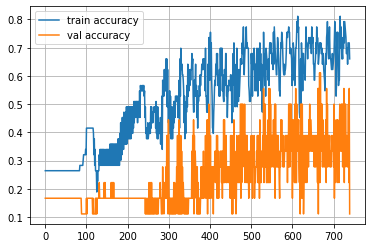

Epoch 740
Train accuracy: 0.660377358490566
Val accuracy: 0.5555555555555556


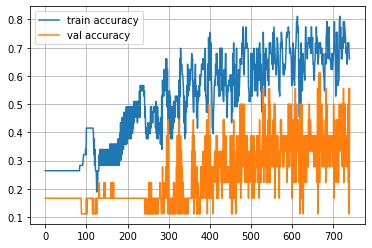

Epoch 741
Train accuracy: 0.660377358490566
Val accuracy: 0.1111111111111111


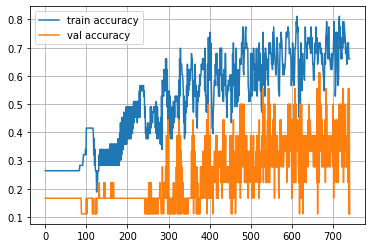

Epoch 742
Train accuracy: 0.7924528301886793
Val accuracy: 0.6111111111111112


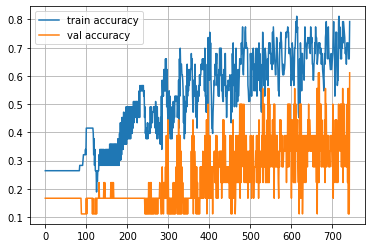

Epoch 743
Train accuracy: 0.7547169811320755
Val accuracy: 0.16666666666666666


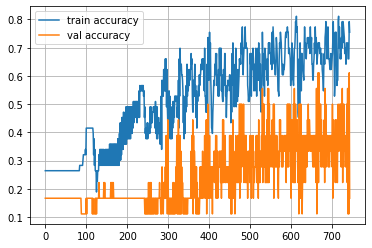

Epoch 744
Train accuracy: 0.8490566037735849
Val accuracy: 0.6111111111111112


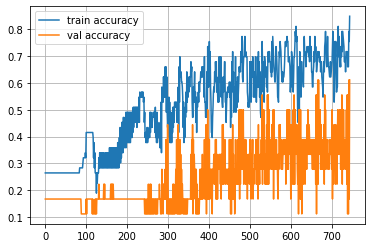

Epoch 745
Train accuracy: 0.7547169811320755
Val accuracy: 0.16666666666666666


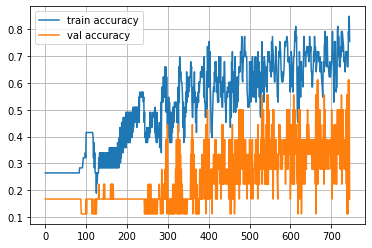

Epoch 746
Train accuracy: 0.8490566037735849
Val accuracy: 0.5555555555555556


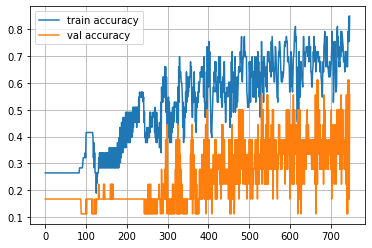

Epoch 747
Train accuracy: 0.7735849056603774
Val accuracy: 0.2222222222222222


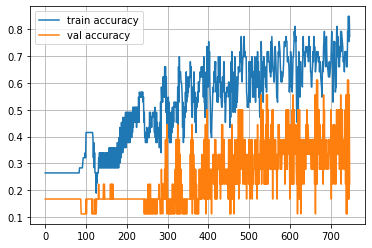

Epoch 748
Train accuracy: 0.8301886792452831
Val accuracy: 0.5555555555555556


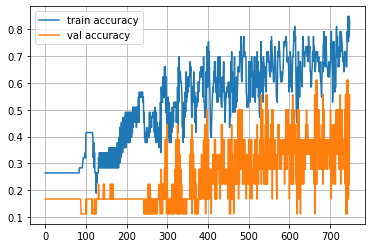

Epoch 749
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


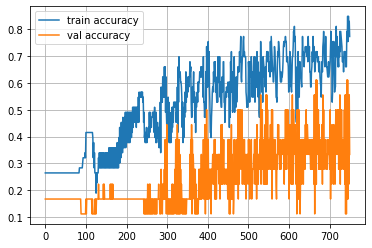

Epoch 750
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


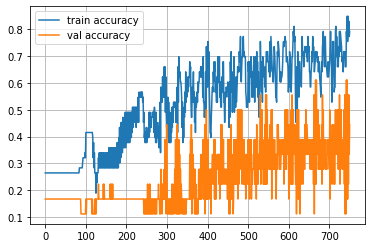

Epoch 751
Train accuracy: 0.7169811320754716
Val accuracy: 0.3333333333333333


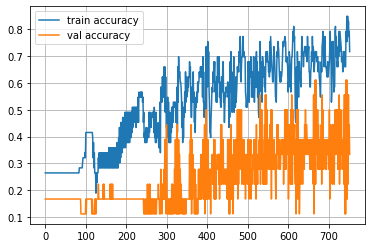

Epoch 752
Train accuracy: 0.7169811320754716
Val accuracy: 0.5


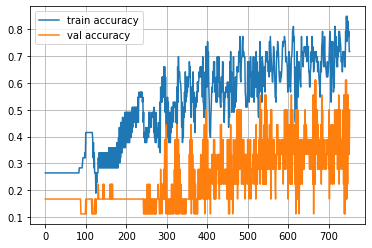

Epoch 753
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


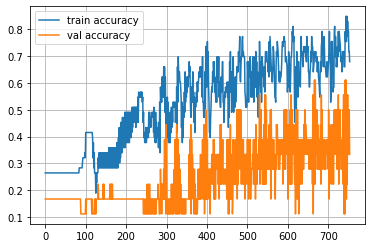

Epoch 754
Train accuracy: 0.6981132075471698
Val accuracy: 0.4444444444444444


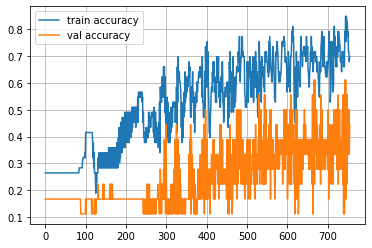

Epoch 755
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


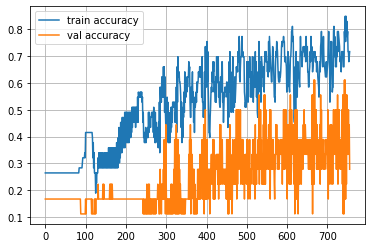

Epoch 756
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


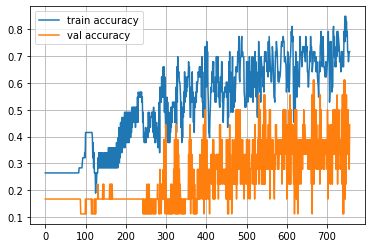

Epoch 757
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


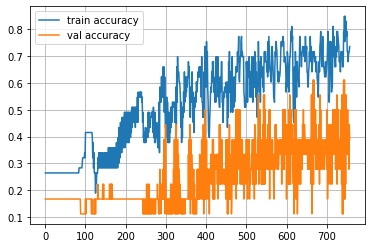

Epoch 758
Train accuracy: 0.6226415094339622
Val accuracy: 0.2777777777777778


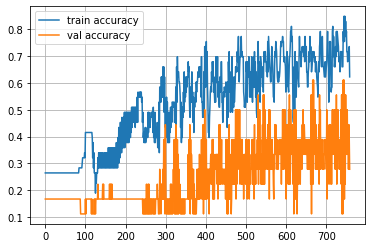

Epoch 759
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


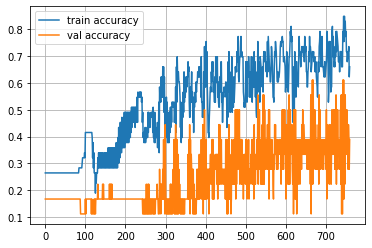

Epoch 760
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


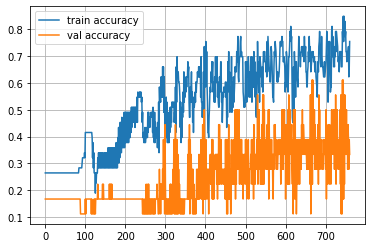

Epoch 761
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


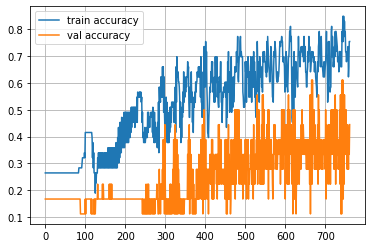

Epoch 762
Train accuracy: 0.8301886792452831
Val accuracy: 0.3333333333333333


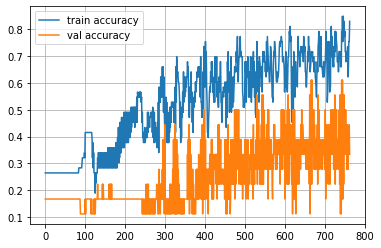

Epoch 763
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


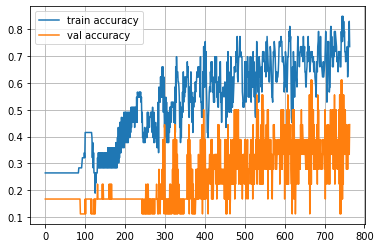

Epoch 764
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


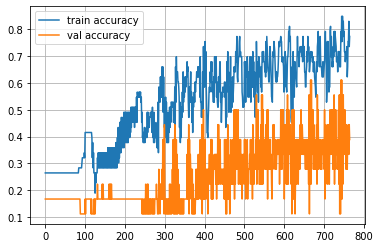

Epoch 765
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


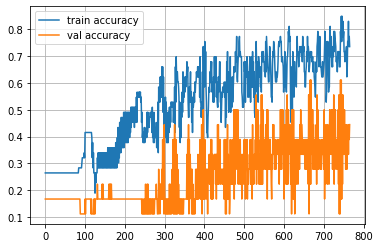

Epoch 766
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


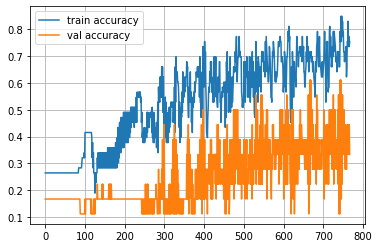

Epoch 767
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


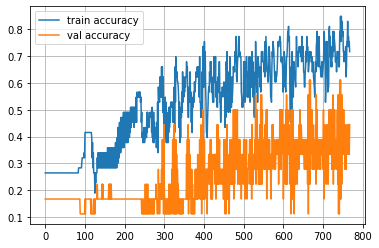

Epoch 768
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


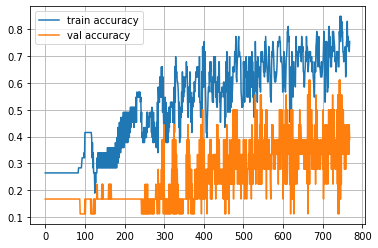

Epoch 769
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


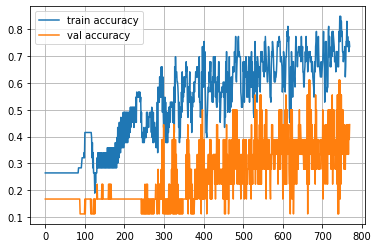

Epoch 770
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


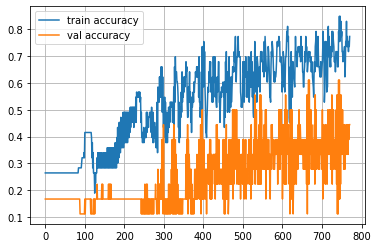

Epoch 771
Train accuracy: 0.7169811320754716
Val accuracy: 0.3888888888888889


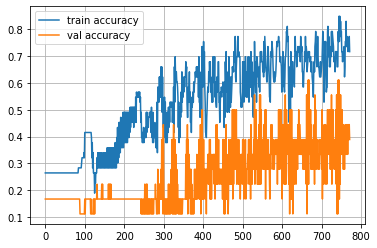

Epoch 772
Train accuracy: 0.8301886792452831
Val accuracy: 0.4444444444444444


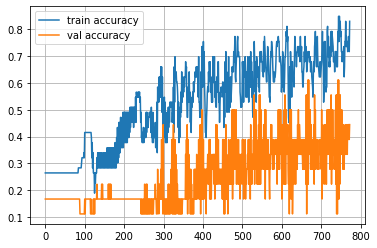

Epoch 773
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


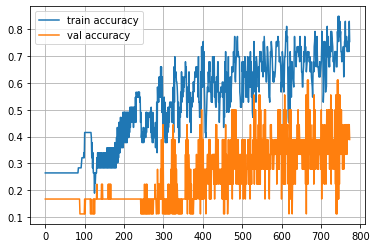

Epoch 774
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


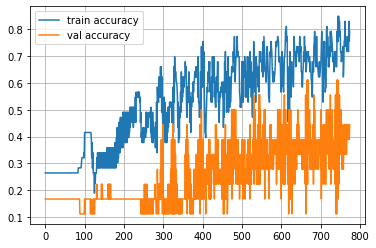

Epoch 775
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


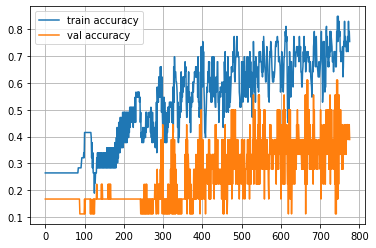

Epoch 776
Train accuracy: 0.6792452830188679
Val accuracy: 0.3888888888888889


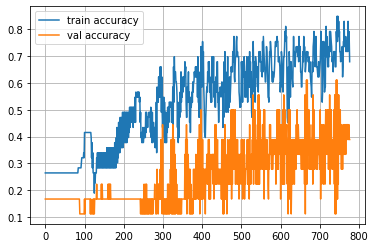

Epoch 777
Train accuracy: 0.6415094339622641
Val accuracy: 0.3888888888888889


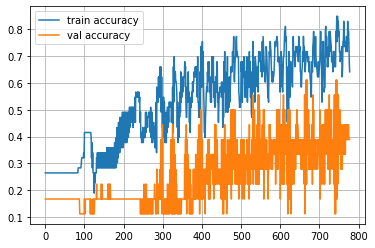

Epoch 778
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


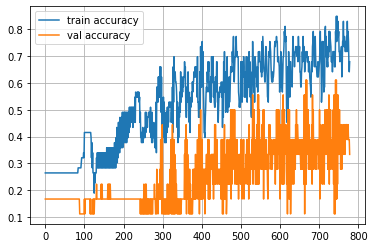

Epoch 779
Train accuracy: 0.6792452830188679
Val accuracy: 0.3333333333333333


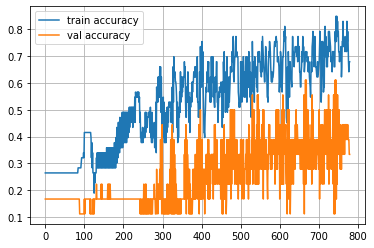

Epoch 780
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


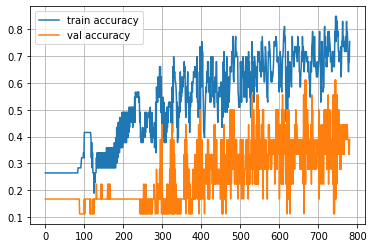

Epoch 781
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


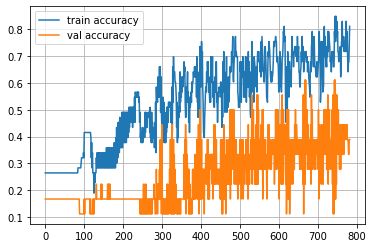

Epoch 782
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


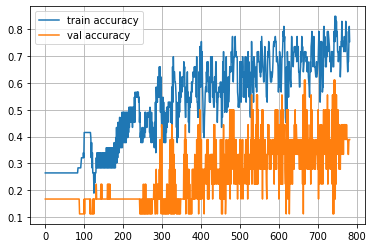

Epoch 783
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


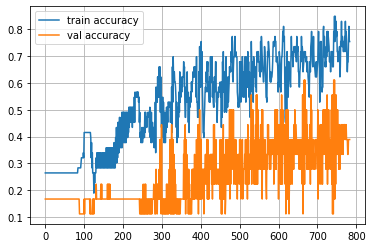

Epoch 784
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


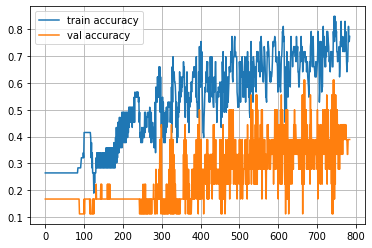

Epoch 785
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


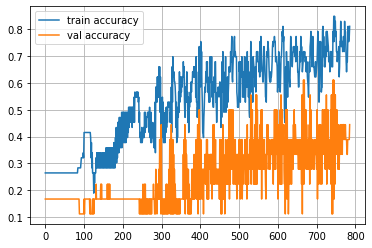

Epoch 786
Train accuracy: 0.7924528301886793
Val accuracy: 0.2777777777777778


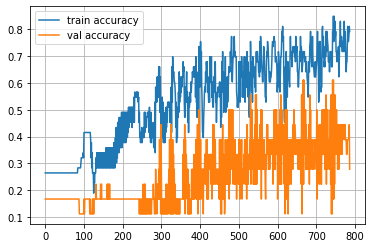

Epoch 787
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


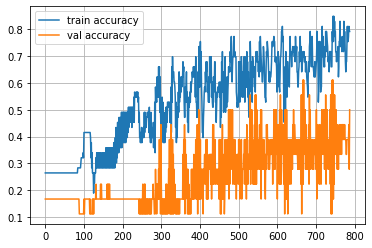

Epoch 788
Train accuracy: 0.7924528301886793
Val accuracy: 0.2777777777777778


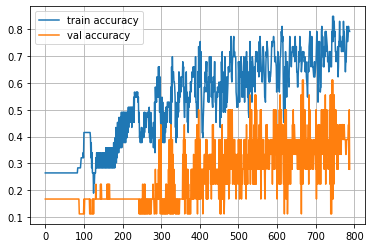

Epoch 789
Train accuracy: 0.7924528301886793
Val accuracy: 0.5555555555555556


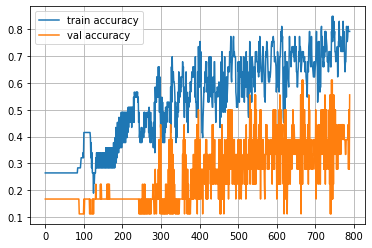

Epoch 790
Train accuracy: 0.7735849056603774
Val accuracy: 0.2777777777777778


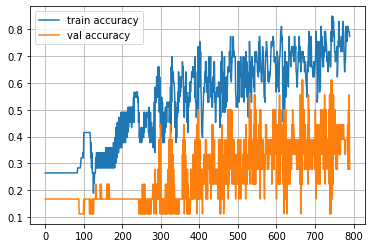

Epoch 791
Train accuracy: 0.7924528301886793
Val accuracy: 0.5555555555555556


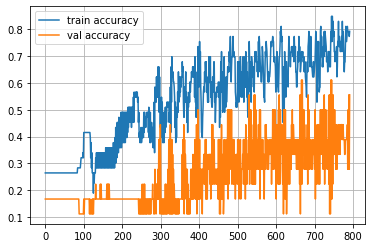

Epoch 792
Train accuracy: 0.6981132075471698
Val accuracy: 0.16666666666666666


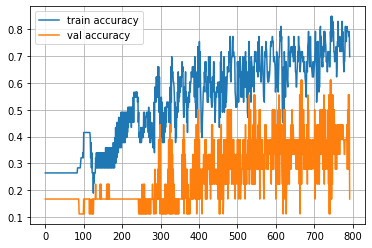

Epoch 793
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


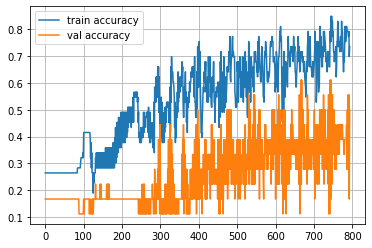

Epoch 794
Train accuracy: 0.660377358490566
Val accuracy: 0.16666666666666666


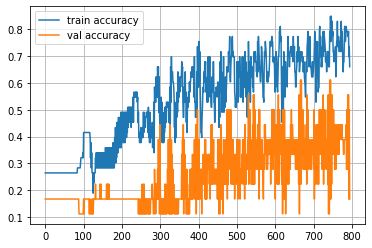

Epoch 795
Train accuracy: 0.7735849056603774
Val accuracy: 0.5555555555555556


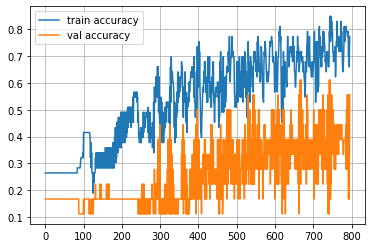

Epoch 796
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


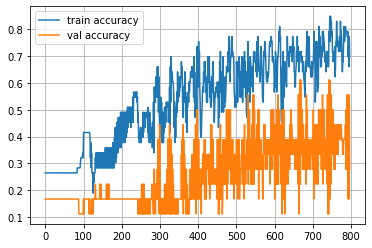

Epoch 797
Train accuracy: 0.7924528301886793
Val accuracy: 0.6111111111111112


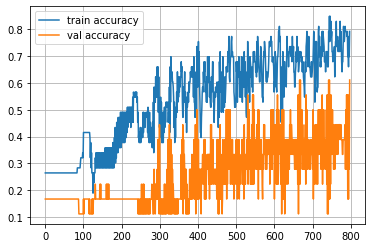

Epoch 798
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


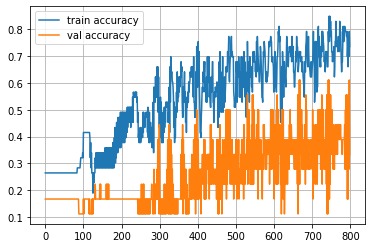

Epoch 799
Train accuracy: 0.7547169811320755
Val accuracy: 0.5555555555555556


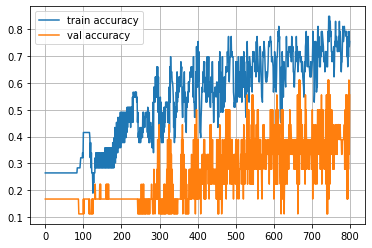

Epoch 800
Train accuracy: 0.660377358490566
Val accuracy: 0.3333333333333333


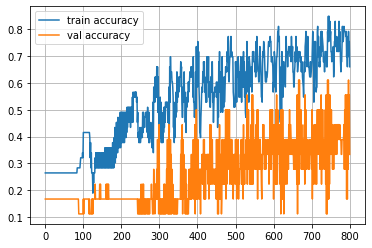

Epoch 801
Train accuracy: 0.6981132075471698
Val accuracy: 0.5


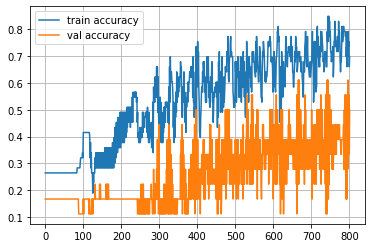

Epoch 802
Train accuracy: 0.6981132075471698
Val accuracy: 0.3333333333333333


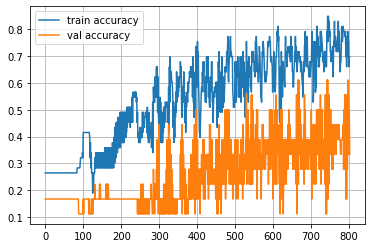

Epoch 803
Train accuracy: 0.6981132075471698
Val accuracy: 0.4444444444444444


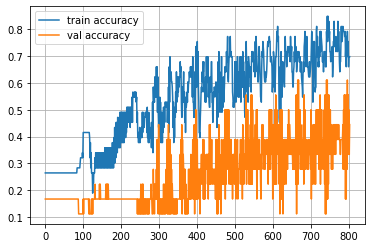

Epoch 804
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


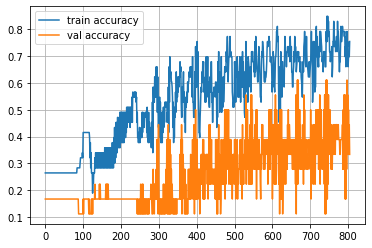

Epoch 805
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


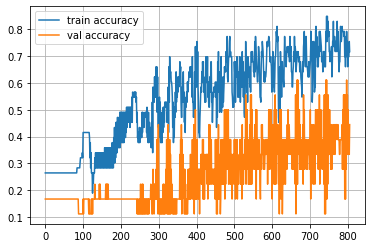

Epoch 806
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


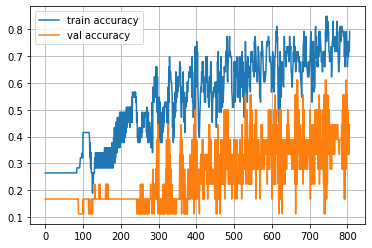

Epoch 807
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


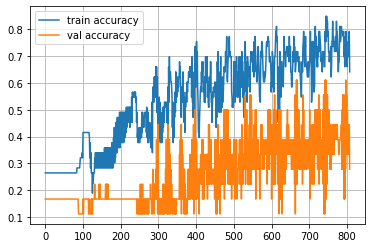

Epoch 808
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


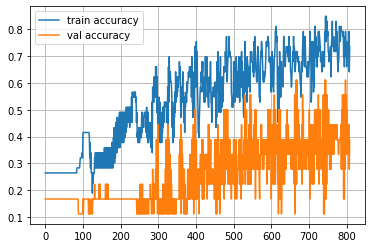

Epoch 809
Train accuracy: 0.6415094339622641
Val accuracy: 0.2777777777777778


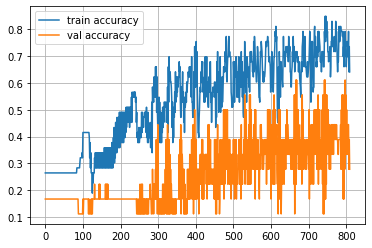

Epoch 810
Train accuracy: 0.6415094339622641
Val accuracy: 0.3333333333333333


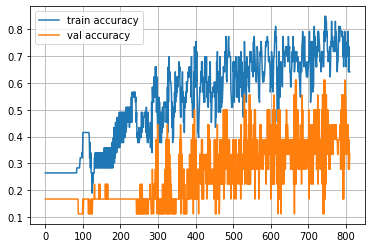

Epoch 811
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


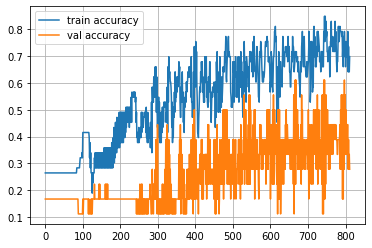

Epoch 812
Train accuracy: 0.6037735849056604
Val accuracy: 0.3333333333333333


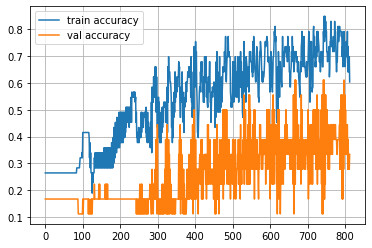

Epoch 813
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


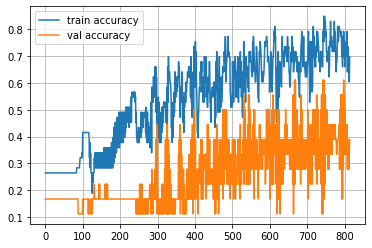

Epoch 814
Train accuracy: 0.6792452830188679
Val accuracy: 0.2777777777777778


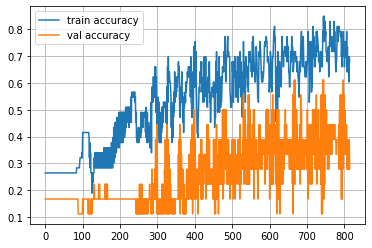

Epoch 815
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


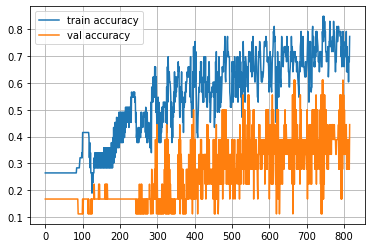

Epoch 816
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


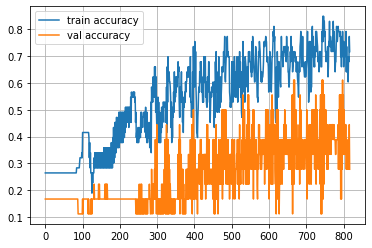

Epoch 817
Train accuracy: 0.8301886792452831
Val accuracy: 0.4444444444444444


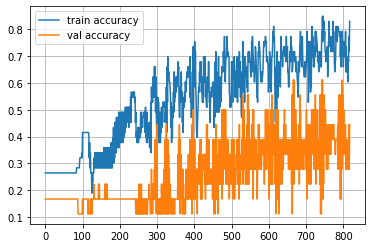

Epoch 818
Train accuracy: 0.7547169811320755
Val accuracy: 0.2777777777777778


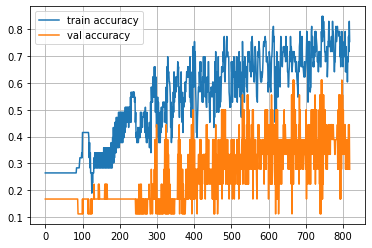

Epoch 819
Train accuracy: 0.7924528301886793
Val accuracy: 0.5555555555555556


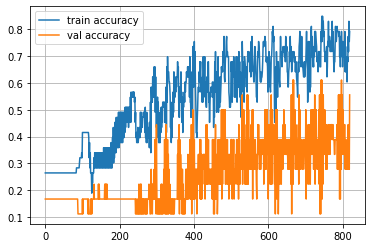

Epoch 820
Train accuracy: 0.7169811320754716
Val accuracy: 0.16666666666666666


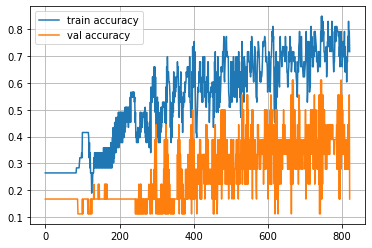

Epoch 821
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


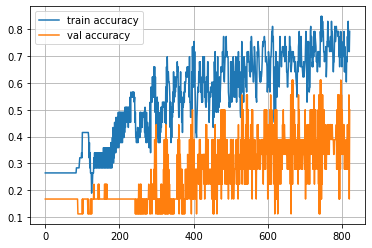

Epoch 822
Train accuracy: 0.7547169811320755
Val accuracy: 0.16666666666666666


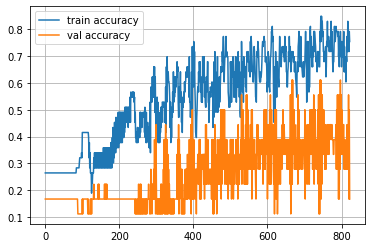

Epoch 823
Train accuracy: 0.660377358490566
Val accuracy: 0.3888888888888889


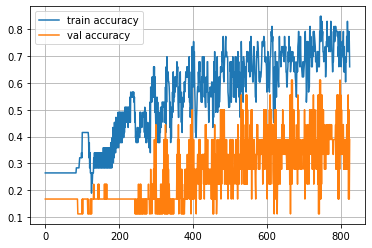

Epoch 824
Train accuracy: 0.8113207547169812
Val accuracy: 0.5


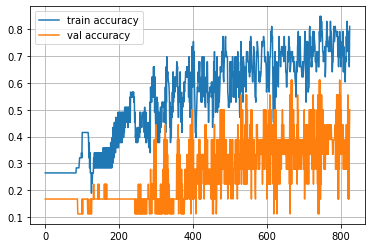

Epoch 825
Train accuracy: 0.8490566037735849
Val accuracy: 0.4444444444444444


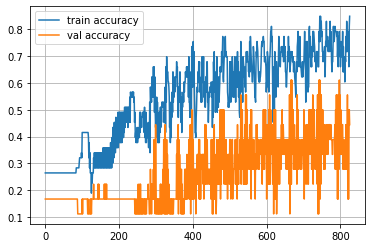

Epoch 826
Train accuracy: 0.7924528301886793
Val accuracy: 0.3888888888888889


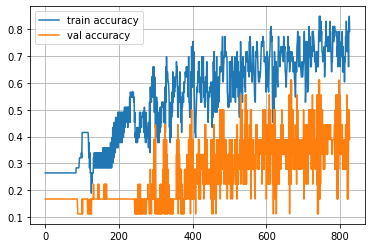

Epoch 827
Train accuracy: 0.8113207547169812
Val accuracy: 0.5


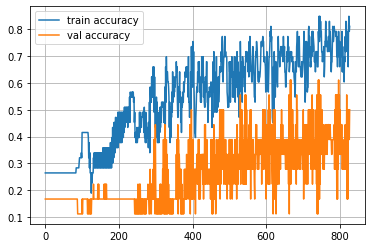

Epoch 828
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


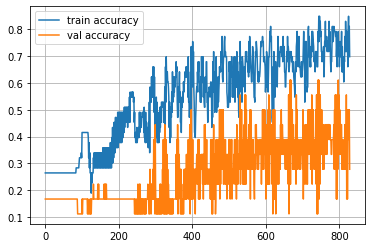

Epoch 829
Train accuracy: 0.6226415094339622
Val accuracy: 0.4444444444444444


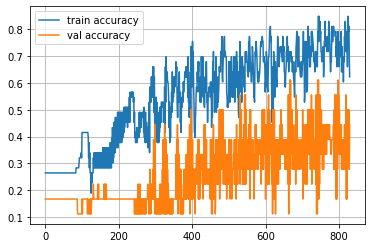

Epoch 830
Train accuracy: 0.6415094339622641
Val accuracy: 0.16666666666666666


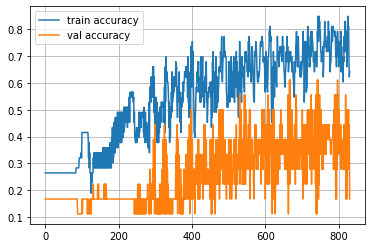

Epoch 831
Train accuracy: 0.7358490566037735
Val accuracy: 0.5555555555555556


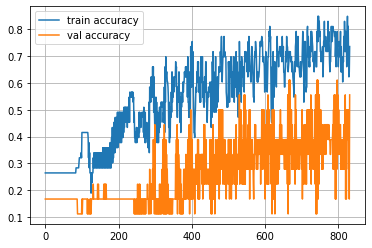

Epoch 832
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


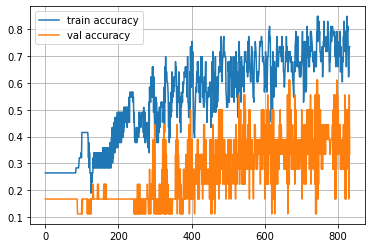

Epoch 833
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


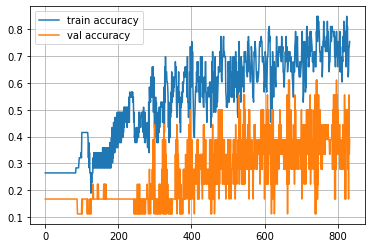

Epoch 834
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


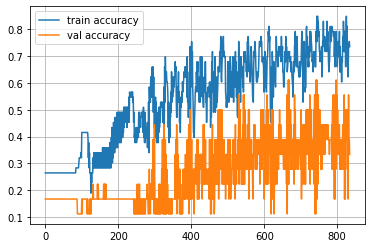

Epoch 835
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


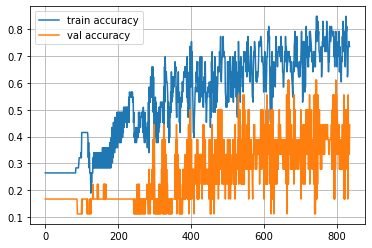

Epoch 836
Train accuracy: 0.7924528301886793
Val accuracy: 0.3333333333333333


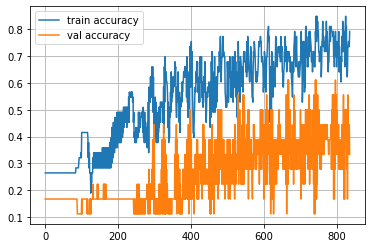

Epoch 837
Train accuracy: 0.7169811320754716
Val accuracy: 0.4444444444444444


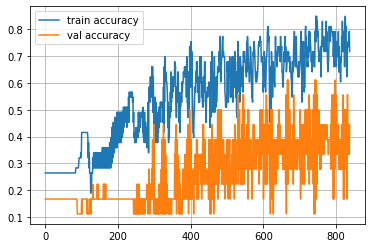

Epoch 838
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


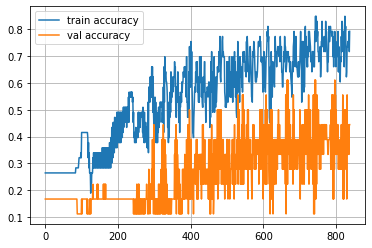

Epoch 839
Train accuracy: 0.6981132075471698
Val accuracy: 0.2777777777777778


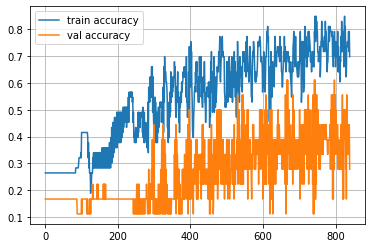

Epoch 840
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


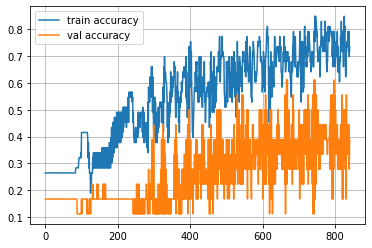

Epoch 841
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


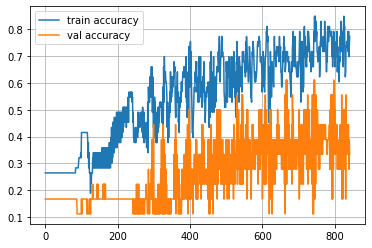

Epoch 842
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


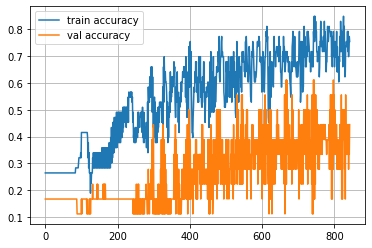

Epoch 843
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


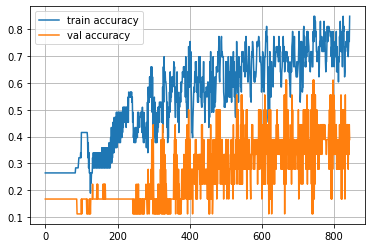

Epoch 844
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


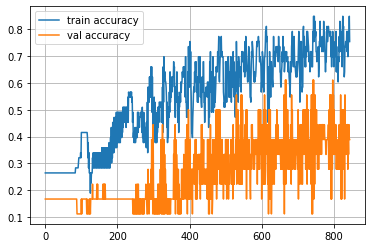

Epoch 845
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


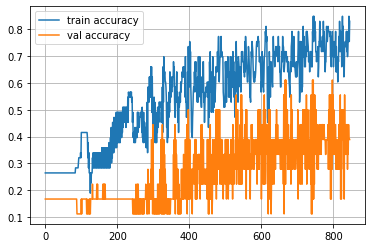

Epoch 846
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


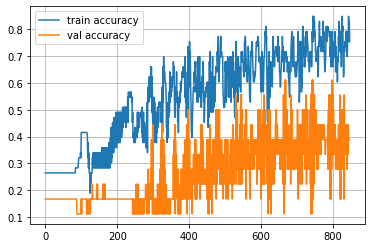

Epoch 847
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


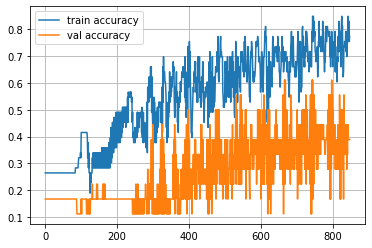

Epoch 848
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


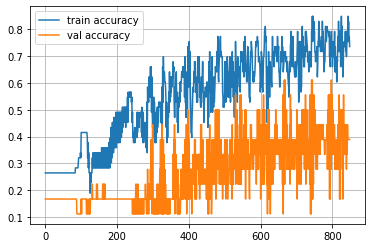

Epoch 849
Train accuracy: 0.7924528301886793
Val accuracy: 0.3888888888888889


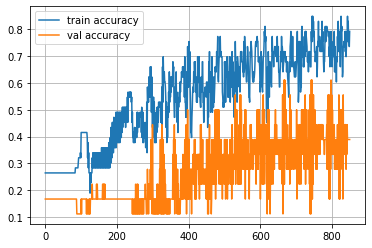

Epoch 850
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


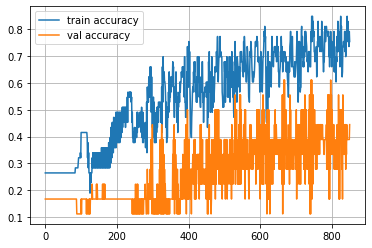

Epoch 851
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


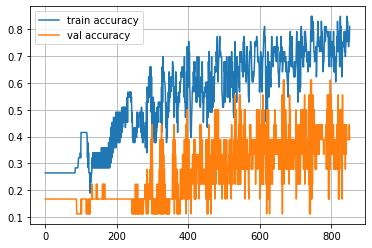

Epoch 852
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


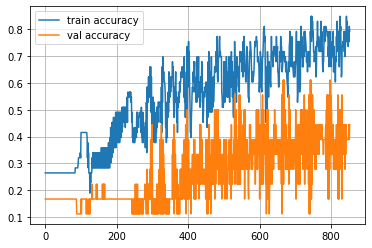

Epoch 853
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


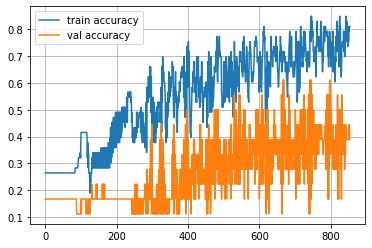

Epoch 854
Train accuracy: 0.8679245283018868
Val accuracy: 0.6111111111111112


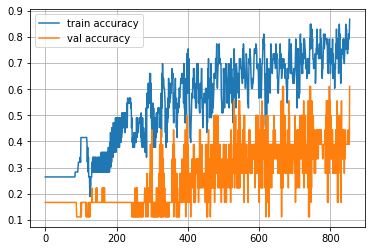

Epoch 855
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


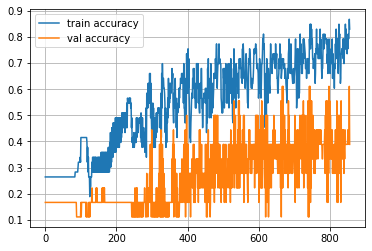

Epoch 856
Train accuracy: 0.8490566037735849
Val accuracy: 0.6111111111111112


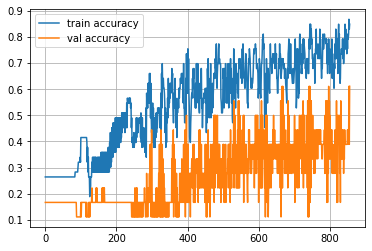

Epoch 857
Train accuracy: 0.8301886792452831
Val accuracy: 0.3333333333333333


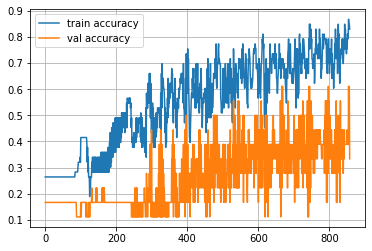

Epoch 858
Train accuracy: 0.8490566037735849
Val accuracy: 0.6111111111111112


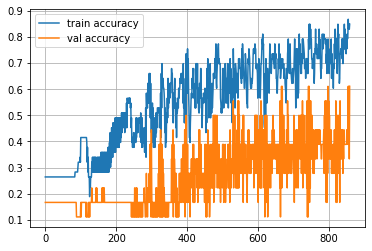

Epoch 859
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


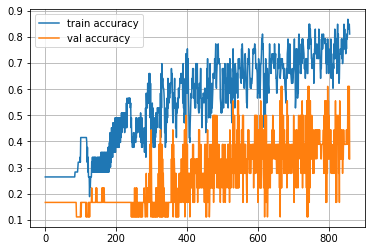

Epoch 860
Train accuracy: 0.7924528301886793
Val accuracy: 0.6111111111111112


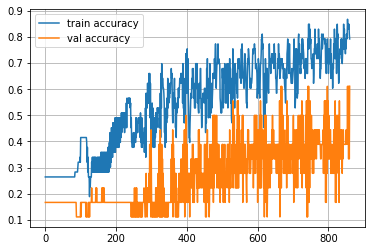

Epoch 861
Train accuracy: 0.7547169811320755
Val accuracy: 0.2777777777777778


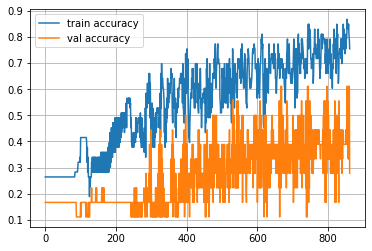

Epoch 862
Train accuracy: 0.7358490566037735
Val accuracy: 0.6111111111111112


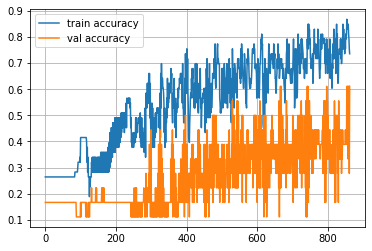

Epoch 863
Train accuracy: 0.7358490566037735
Val accuracy: 0.2777777777777778


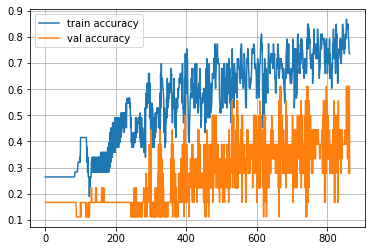

Epoch 864
Train accuracy: 0.7547169811320755
Val accuracy: 0.6111111111111112


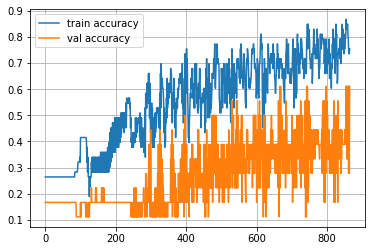

Epoch 865
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


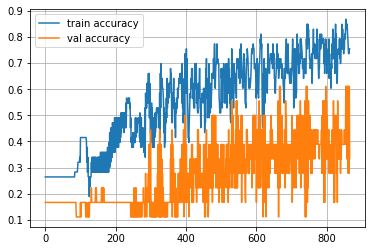

Epoch 866
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


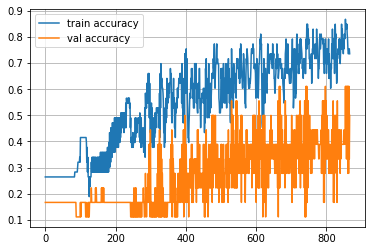

Epoch 867
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


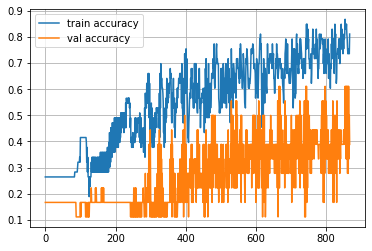

Epoch 868
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


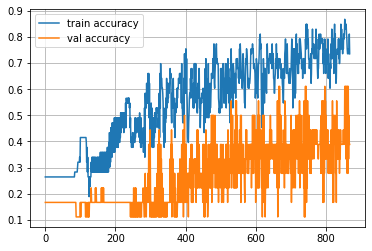

Epoch 869
Train accuracy: 0.6981132075471698
Val accuracy: 0.3888888888888889


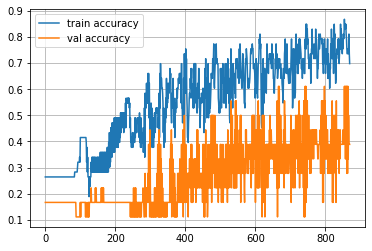

Epoch 870
Train accuracy: 0.6226415094339622
Val accuracy: 0.3333333333333333


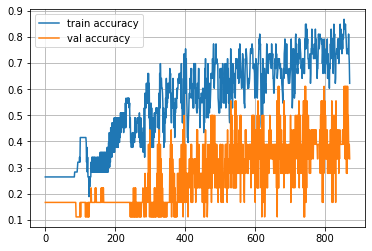

Epoch 871
Train accuracy: 0.7735849056603774
Val accuracy: 0.5


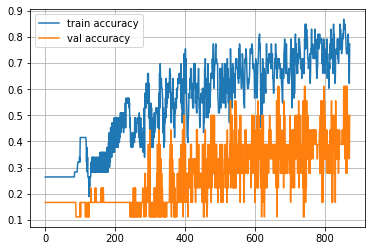

Epoch 872
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


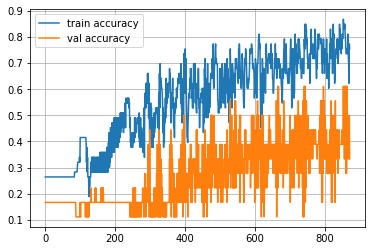

Epoch 873
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


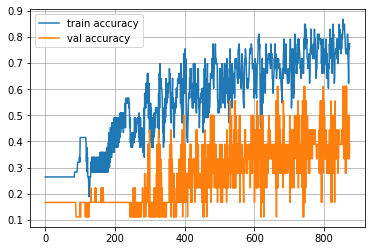

Epoch 874
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


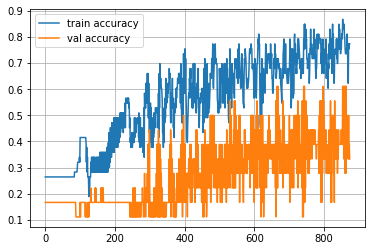

Epoch 875
Train accuracy: 0.7547169811320755
Val accuracy: 0.4444444444444444


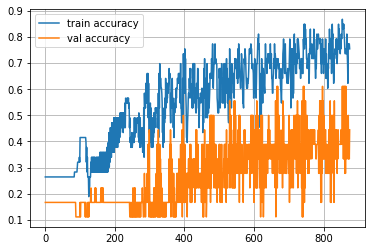

Epoch 876
Train accuracy: 0.6792452830188679
Val accuracy: 0.16666666666666666


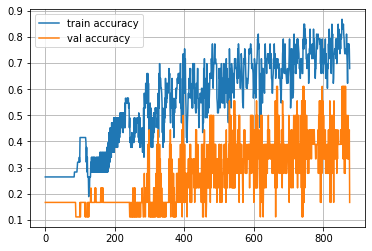

Epoch 877
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


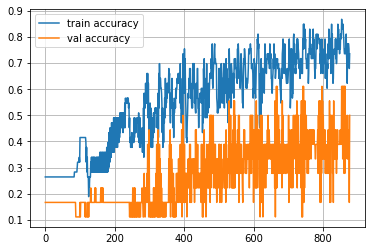

Epoch 878
Train accuracy: 0.6981132075471698
Val accuracy: 0.16666666666666666


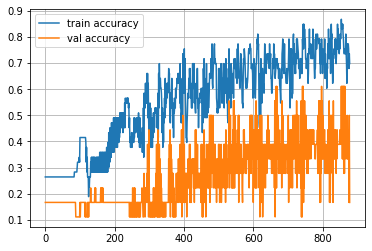

Epoch 879
Train accuracy: 0.8867924528301887
Val accuracy: 0.4444444444444444


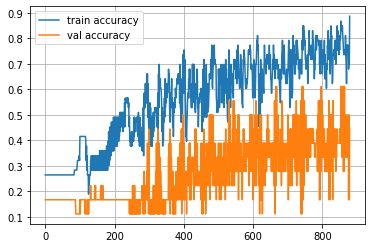

Epoch 880
Train accuracy: 0.8301886792452831
Val accuracy: 0.3333333333333333


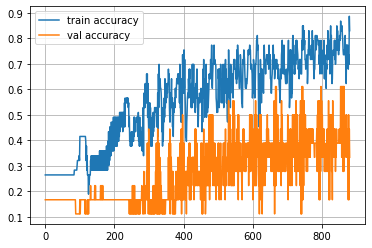

Epoch 881
Train accuracy: 0.7924528301886793
Val accuracy: 0.3888888888888889


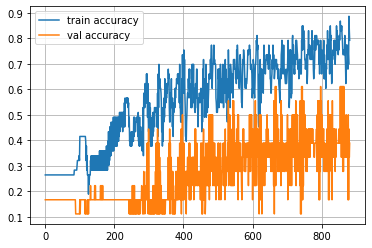

Epoch 882
Train accuracy: 0.7924528301886793
Val accuracy: 0.3888888888888889


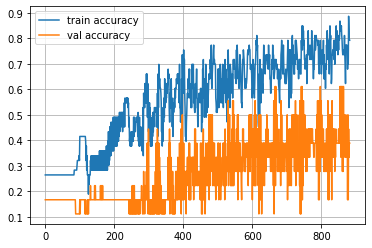

Epoch 883
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


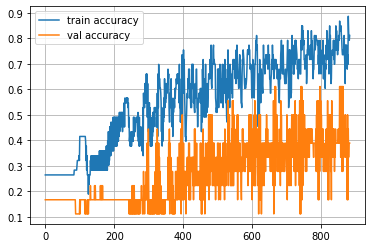

Epoch 884
Train accuracy: 0.7358490566037735
Val accuracy: 0.3333333333333333


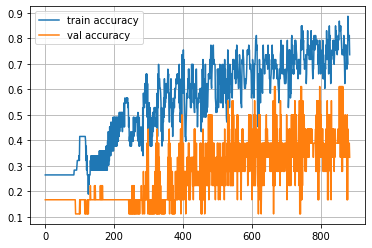

Epoch 885
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


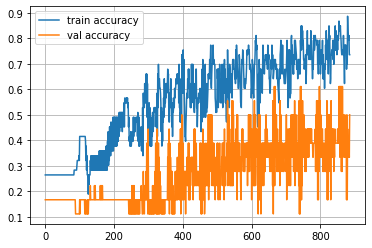

Epoch 886
Train accuracy: 0.7169811320754716
Val accuracy: 0.2777777777777778


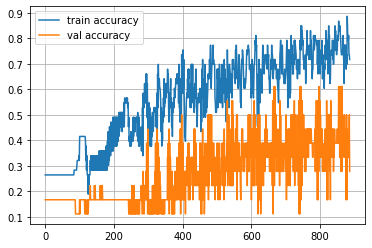

Epoch 887
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


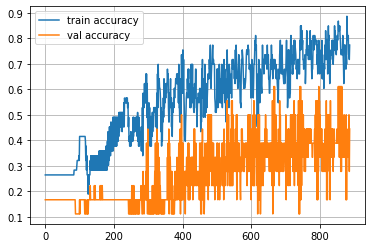

Epoch 888
Train accuracy: 0.8301886792452831
Val accuracy: 0.3333333333333333


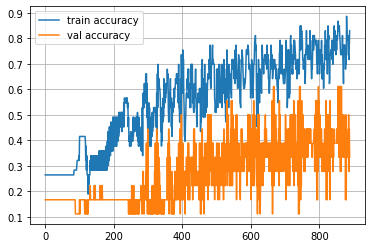

Epoch 889
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


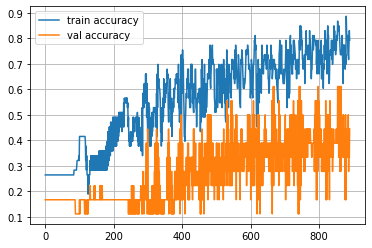

Epoch 890
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


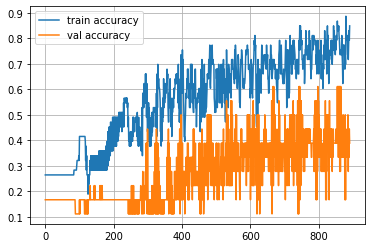

Epoch 891
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


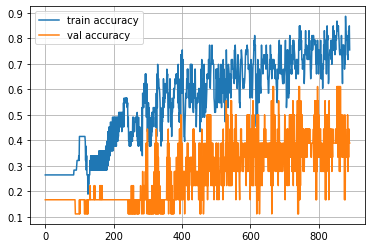

Epoch 892
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


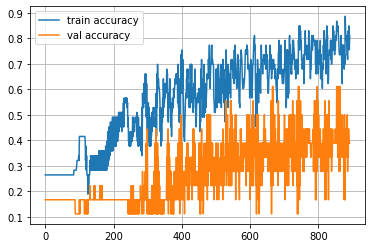

Epoch 893
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


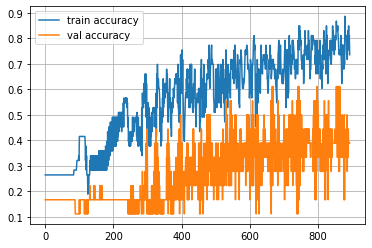

Epoch 894
Train accuracy: 0.7924528301886793
Val accuracy: 0.3333333333333333


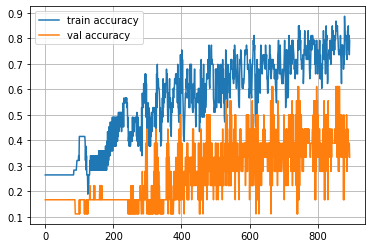

Epoch 895
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


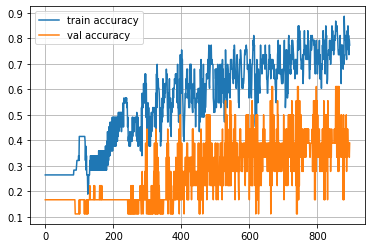

Epoch 896
Train accuracy: 0.8679245283018868
Val accuracy: 0.5


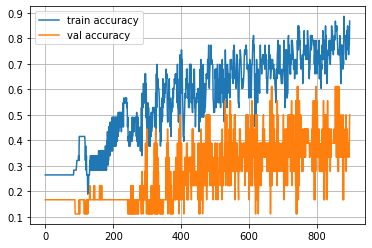

Epoch 897
Train accuracy: 0.7924528301886793
Val accuracy: 0.3888888888888889


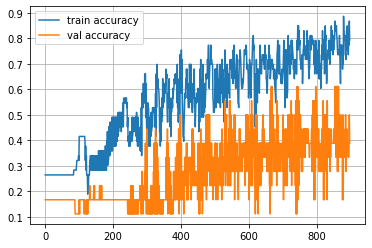

Epoch 898
Train accuracy: 0.9056603773584906
Val accuracy: 0.5


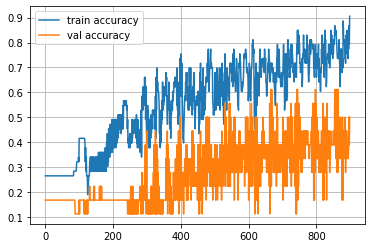

Epoch 899
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


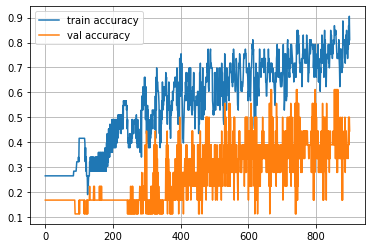

Epoch 900
Train accuracy: 0.8867924528301887
Val accuracy: 0.5


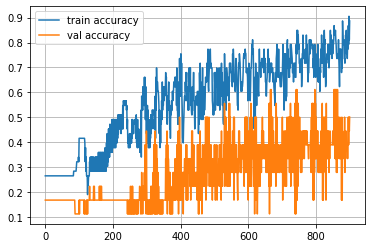

Epoch 901
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


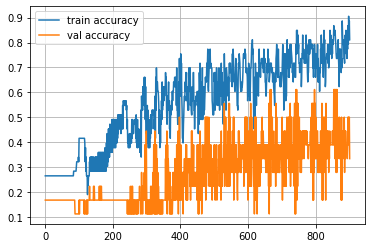

Epoch 902
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


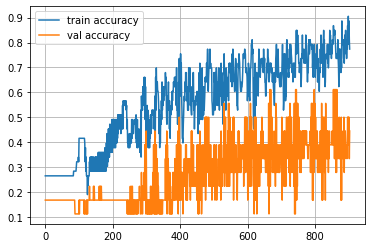

Epoch 903
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


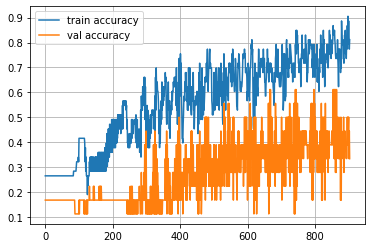

Epoch 904
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


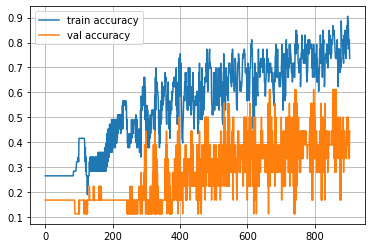

Epoch 905
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


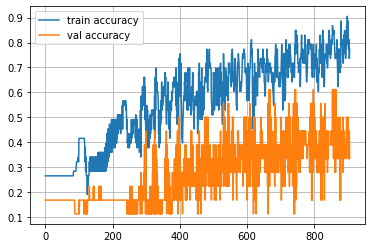

Epoch 906
Train accuracy: 0.7358490566037735
Val accuracy: 0.5555555555555556


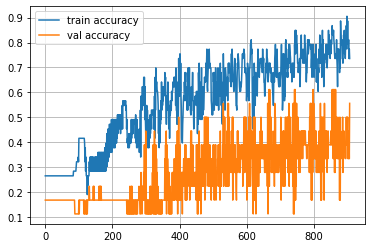

Epoch 907
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


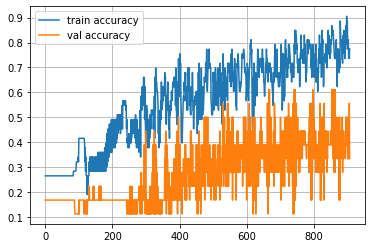

Epoch 908
Train accuracy: 0.7547169811320755
Val accuracy: 0.6111111111111112


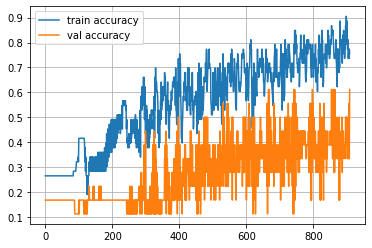

Epoch 909
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


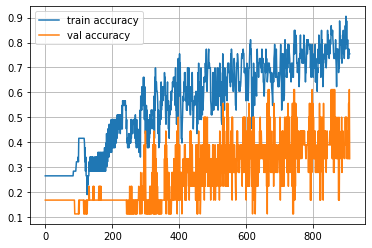

Epoch 910
Train accuracy: 0.7547169811320755
Val accuracy: 0.5555555555555556


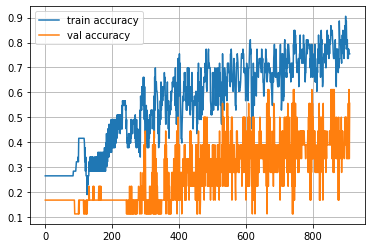

Epoch 911
Train accuracy: 0.7924528301886793
Val accuracy: 0.3333333333333333


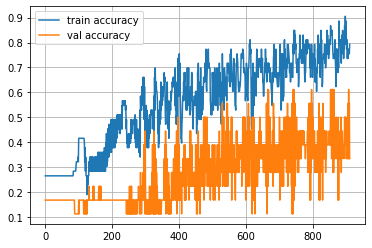

Epoch 912
Train accuracy: 0.8301886792452831
Val accuracy: 0.6666666666666666


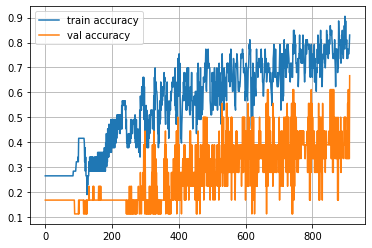

Epoch 913
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


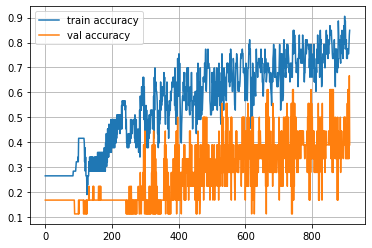

Epoch 914
Train accuracy: 0.9056603773584906
Val accuracy: 0.6111111111111112


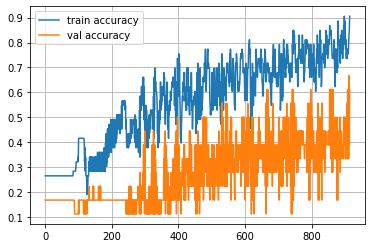

Epoch 915
Train accuracy: 0.8679245283018868
Val accuracy: 0.3888888888888889


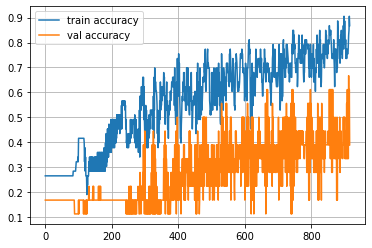

Epoch 916
Train accuracy: 0.8867924528301887
Val accuracy: 0.6111111111111112


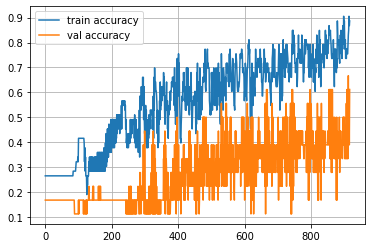

Epoch 917
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


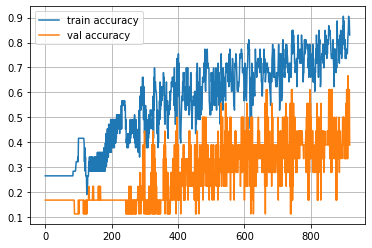

Epoch 918
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


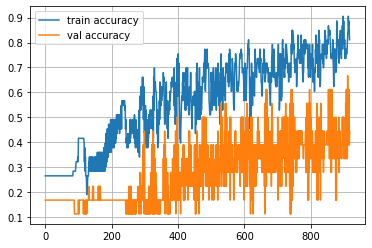

Epoch 919
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


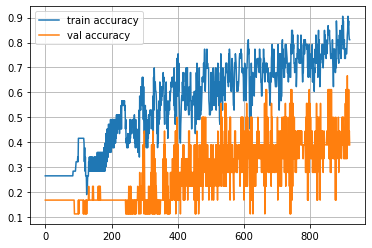

Epoch 920
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


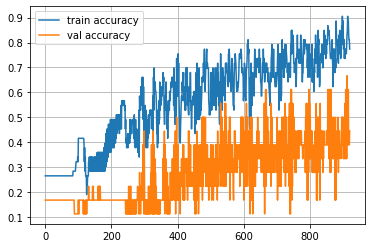

Epoch 921
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


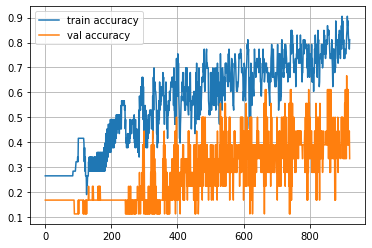

Epoch 922
Train accuracy: 0.7735849056603774
Val accuracy: 0.4444444444444444


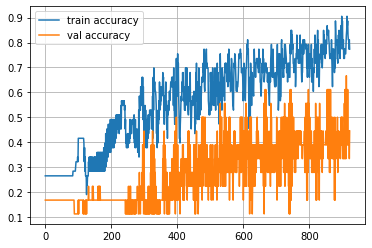

Epoch 923
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


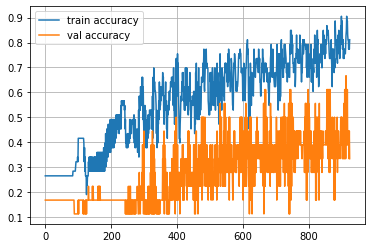

Epoch 924
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


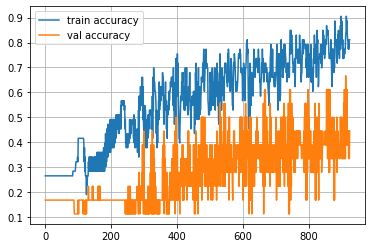

Epoch 925
Train accuracy: 0.8679245283018868
Val accuracy: 0.3888888888888889


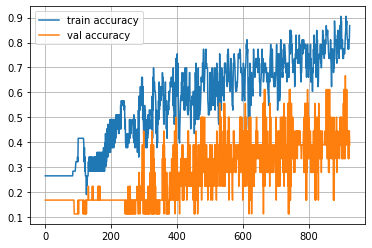

Epoch 926
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


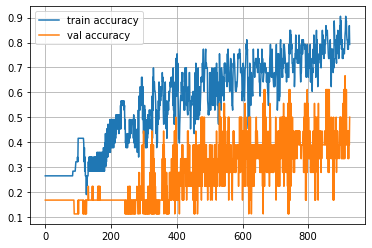

Epoch 927
Train accuracy: 0.8679245283018868
Val accuracy: 0.3888888888888889


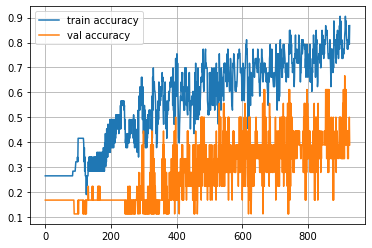

Epoch 928
Train accuracy: 0.8490566037735849
Val accuracy: 0.5


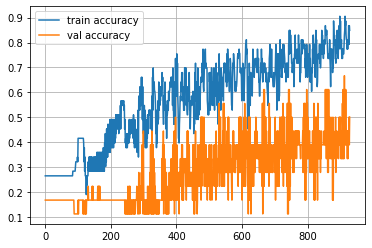

Epoch 929
Train accuracy: 0.9056603773584906
Val accuracy: 0.5


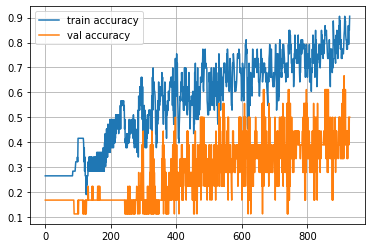

Epoch 930
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


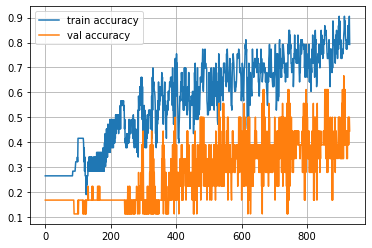

Epoch 931
Train accuracy: 0.8490566037735849
Val accuracy: 0.5


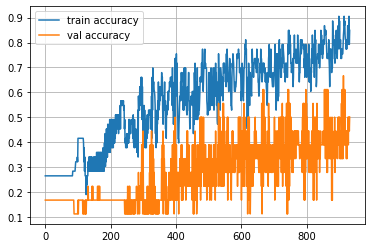

Epoch 932
Train accuracy: 0.7358490566037735
Val accuracy: 0.4444444444444444


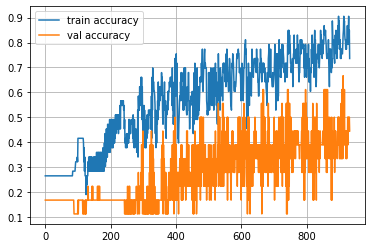

Epoch 933
Train accuracy: 0.8301886792452831
Val accuracy: 0.4444444444444444


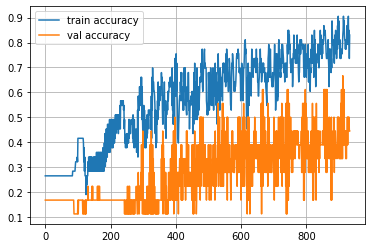

Epoch 934
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


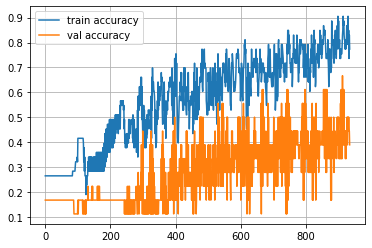

Epoch 935
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


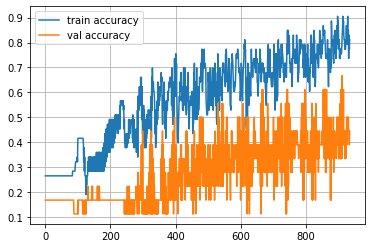

Epoch 936
Train accuracy: 0.8490566037735849
Val accuracy: 0.4444444444444444


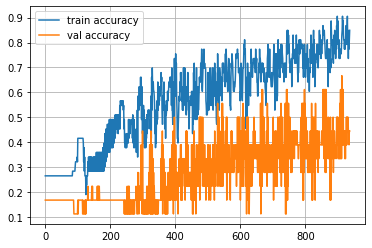

Epoch 937
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


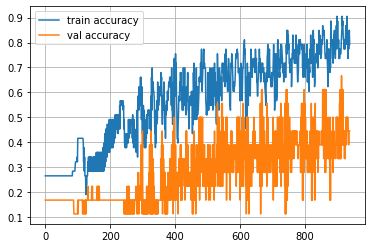

Epoch 938
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


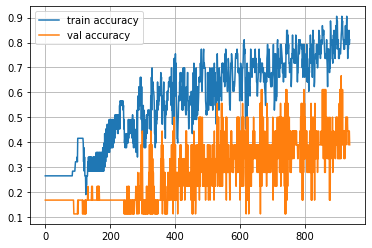

Epoch 939
Train accuracy: 0.7924528301886793
Val accuracy: 0.3888888888888889


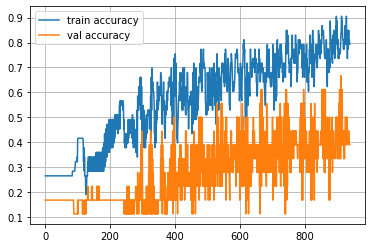

Epoch 940
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


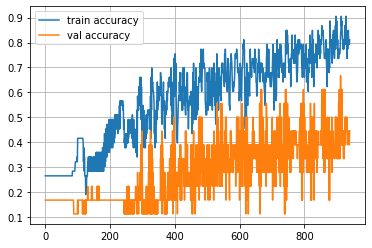

Epoch 941
Train accuracy: 0.7735849056603774
Val accuracy: 0.3888888888888889


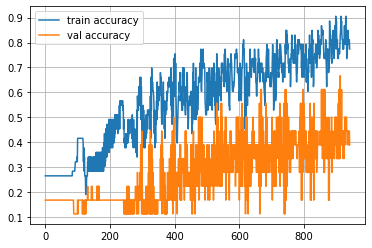

Epoch 942
Train accuracy: 0.7358490566037735
Val accuracy: 0.3888888888888889


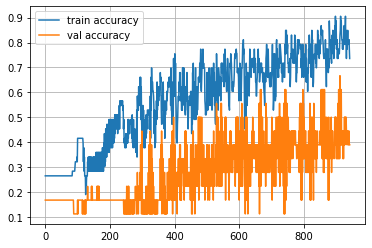

Epoch 943
Train accuracy: 0.7547169811320755
Val accuracy: 0.3888888888888889


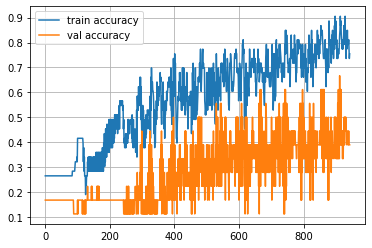

Epoch 944
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


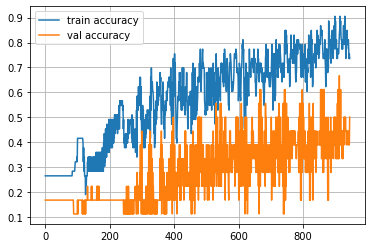

Epoch 945
Train accuracy: 0.8113207547169812
Val accuracy: 0.5


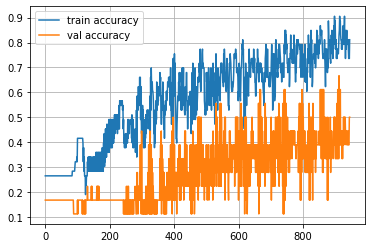

Epoch 946
Train accuracy: 0.7735849056603774
Val accuracy: 0.5


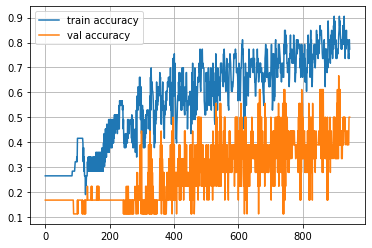

Epoch 947
Train accuracy: 0.7924528301886793
Val accuracy: 0.3333333333333333


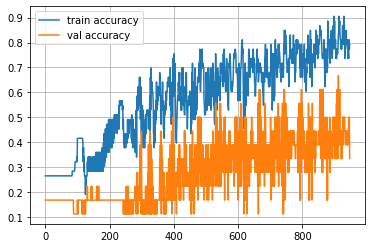

Epoch 948
Train accuracy: 0.8113207547169812
Val accuracy: 0.5555555555555556


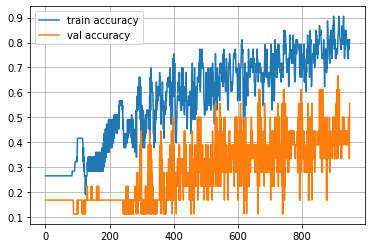

Epoch 949
Train accuracy: 0.7735849056603774
Val accuracy: 0.3333333333333333


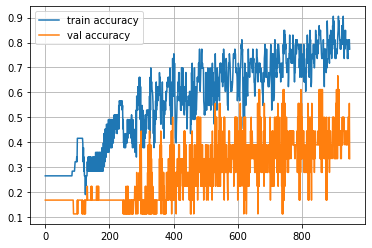

Epoch 950
Train accuracy: 0.7358490566037735
Val accuracy: 0.5


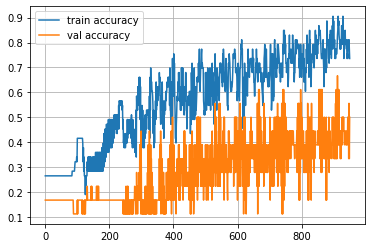

Epoch 951
Train accuracy: 0.7547169811320755
Val accuracy: 0.3333333333333333


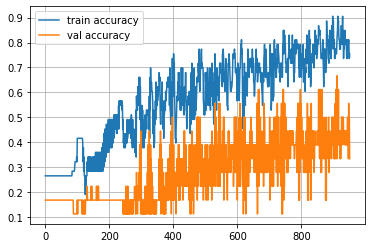

Epoch 952
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


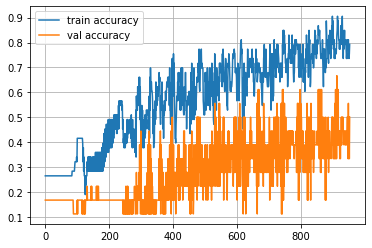

Epoch 953
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


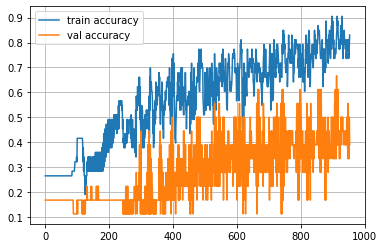

Epoch 954
Train accuracy: 0.8679245283018868
Val accuracy: 0.6111111111111112


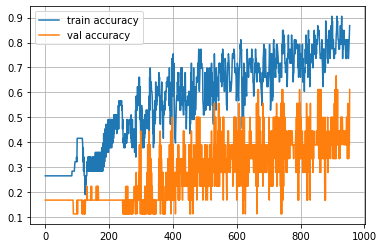

Epoch 955
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


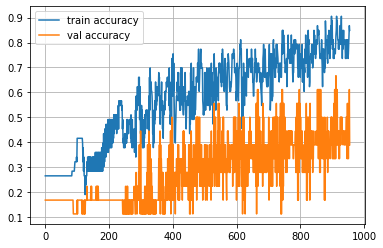

Epoch 956
Train accuracy: 0.8867924528301887
Val accuracy: 0.6111111111111112


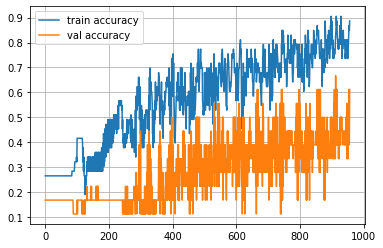

Epoch 957
Train accuracy: 0.8679245283018868
Val accuracy: 0.4444444444444444


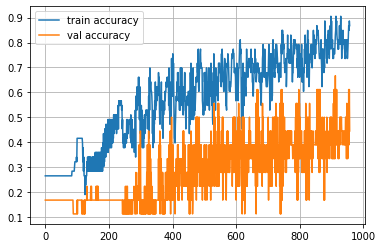

Epoch 958
Train accuracy: 0.8867924528301887
Val accuracy: 0.6111111111111112


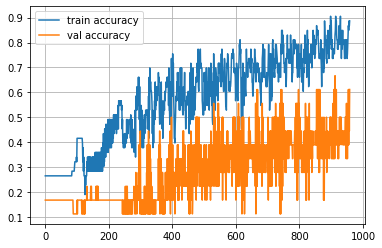

Epoch 959
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


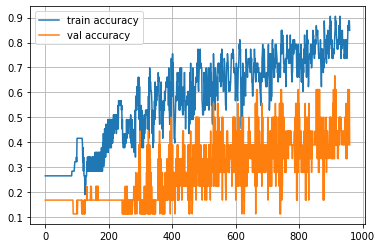

Epoch 960
Train accuracy: 0.8490566037735849
Val accuracy: 0.5


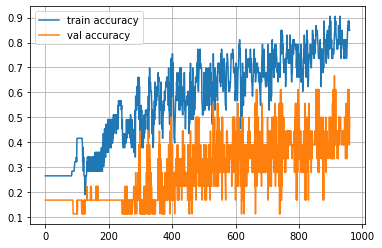

Epoch 961
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


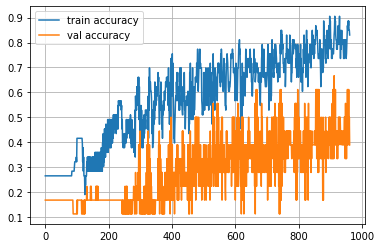

Epoch 962
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


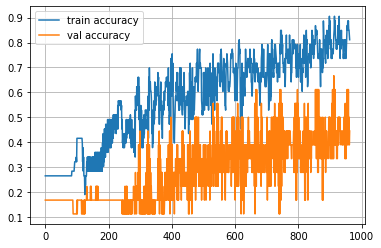

Epoch 963
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


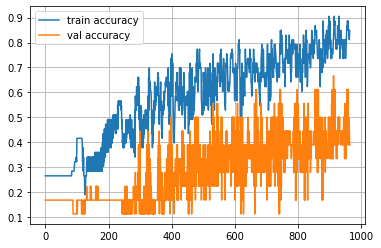

Epoch 964
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


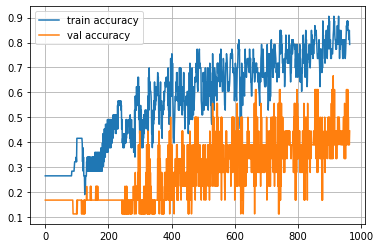

Epoch 965
Train accuracy: 0.8679245283018868
Val accuracy: 0.3333333333333333


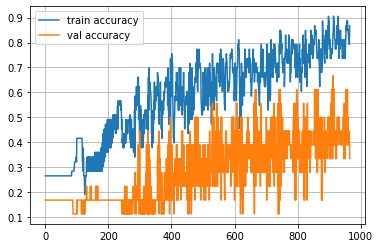

Epoch 966
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


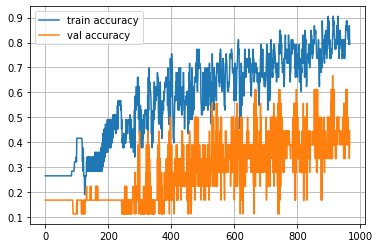

Epoch 967
Train accuracy: 0.8679245283018868
Val accuracy: 0.3333333333333333


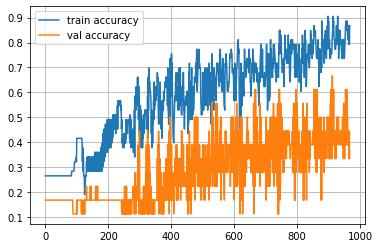

Epoch 968
Train accuracy: 0.8490566037735849
Val accuracy: 0.5


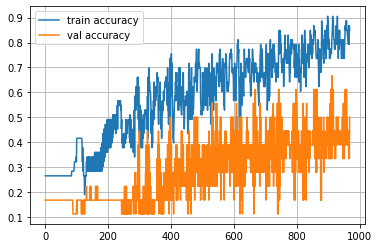

Epoch 969
Train accuracy: 0.8679245283018868
Val accuracy: 0.5


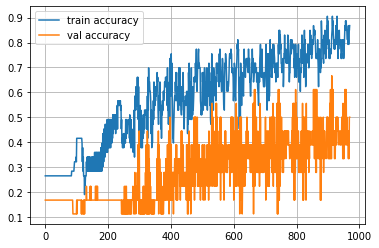

Epoch 970
Train accuracy: 0.7735849056603774
Val accuracy: 0.2777777777777778


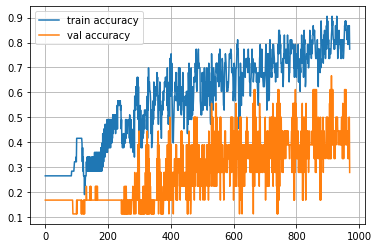

Epoch 971
Train accuracy: 0.8490566037735849
Val accuracy: 0.5


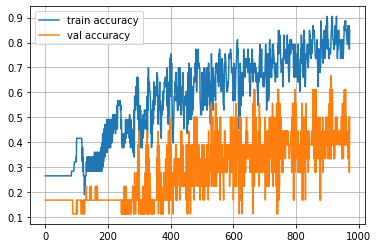

Epoch 972
Train accuracy: 0.7924528301886793
Val accuracy: 0.3333333333333333


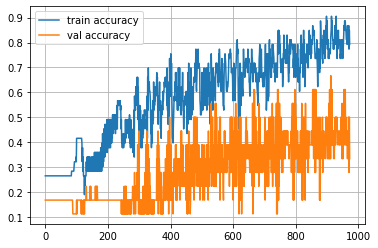

Epoch 973
Train accuracy: 0.8679245283018868
Val accuracy: 0.5


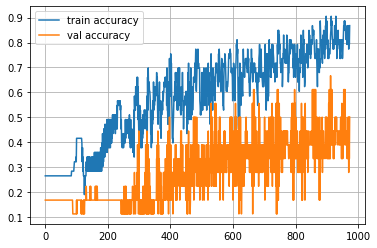

Epoch 974
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


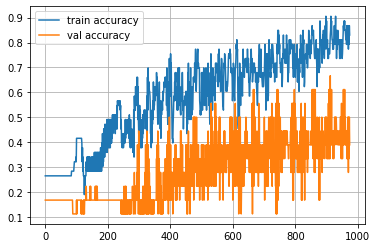

Epoch 975
Train accuracy: 0.9056603773584906
Val accuracy: 0.5


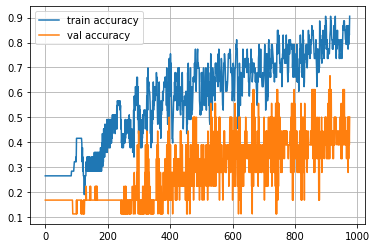

Epoch 976
Train accuracy: 0.8679245283018868
Val accuracy: 0.5


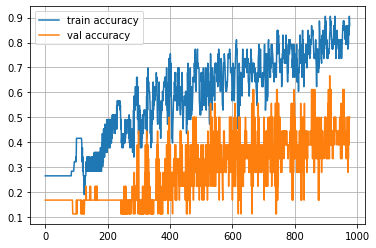

Epoch 977
Train accuracy: 0.8867924528301887
Val accuracy: 0.3888888888888889


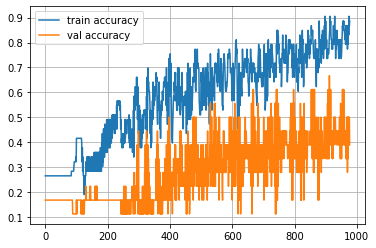

Epoch 978
Train accuracy: 0.7924528301886793
Val accuracy: 0.4444444444444444


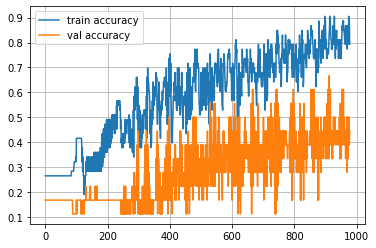

Epoch 979
Train accuracy: 0.8490566037735849
Val accuracy: 0.3333333333333333


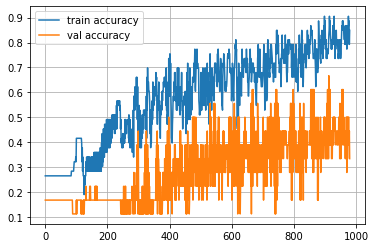

Epoch 980
Train accuracy: 0.7924528301886793
Val accuracy: 0.5


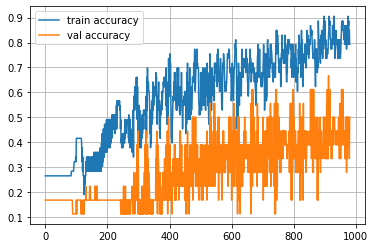

Epoch 981
Train accuracy: 0.8490566037735849
Val accuracy: 0.3888888888888889


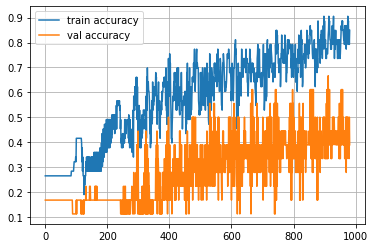

Epoch 982
Train accuracy: 0.8113207547169812
Val accuracy: 0.4444444444444444


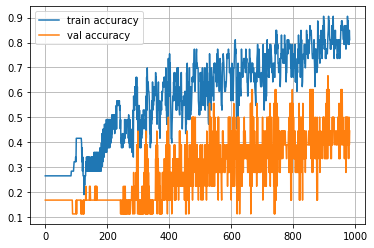

Epoch 983
Train accuracy: 0.8301886792452831
Val accuracy: 0.3888888888888889


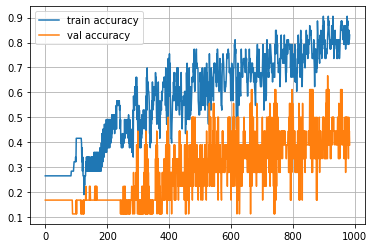

Epoch 984
Train accuracy: 0.8490566037735849
Val accuracy: 0.5555555555555556


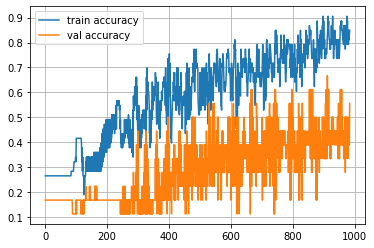

Epoch 985
Train accuracy: 0.8113207547169812
Val accuracy: 0.3888888888888889


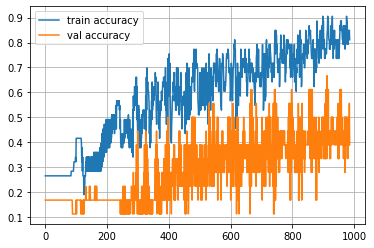

Epoch 986
Train accuracy: 0.8113207547169812
Val accuracy: 0.6111111111111112


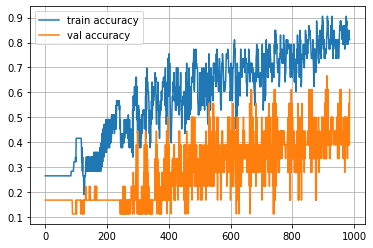

Epoch 987
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


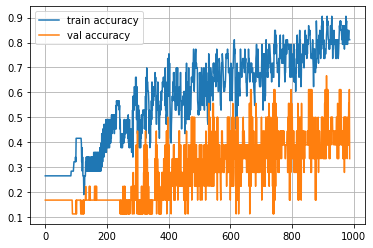

Epoch 988
Train accuracy: 0.7924528301886793
Val accuracy: 0.6111111111111112


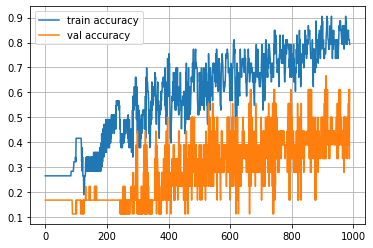

Epoch 989
Train accuracy: 0.7924528301886793
Val accuracy: 0.3333333333333333


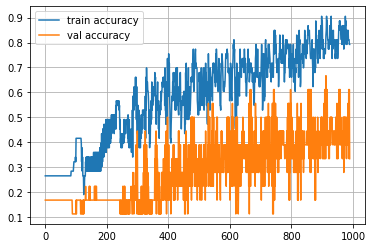

Epoch 990
Train accuracy: 0.7735849056603774
Val accuracy: 0.6111111111111112


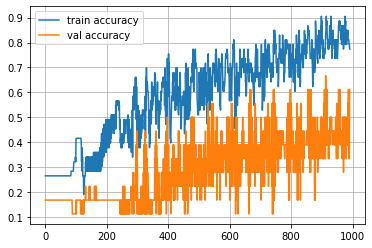

Epoch 991
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


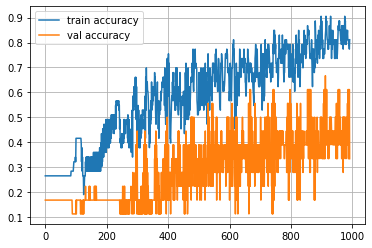

Epoch 992
Train accuracy: 0.7924528301886793
Val accuracy: 0.5555555555555556


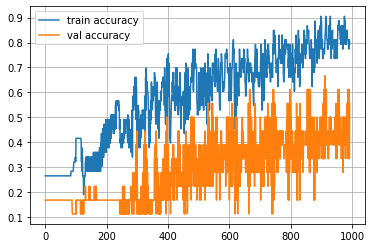

Epoch 993
Train accuracy: 0.8113207547169812
Val accuracy: 0.3333333333333333


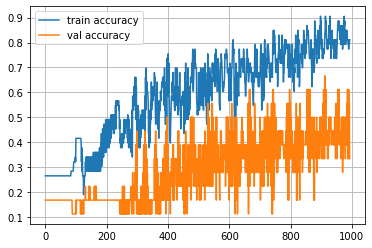

Epoch 994
Train accuracy: 0.8113207547169812
Val accuracy: 0.5


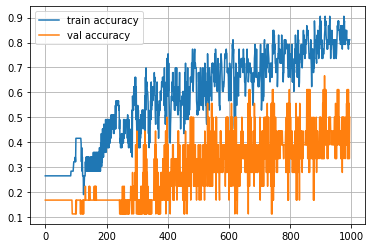

Epoch 995
Train accuracy: 0.8301886792452831
Val accuracy: 0.3333333333333333


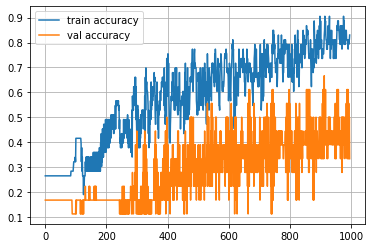

Epoch 996
Train accuracy: 0.8490566037735849
Val accuracy: 0.6111111111111112


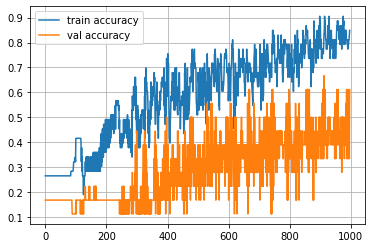

Epoch 997
Train accuracy: 0.8679245283018868
Val accuracy: 0.3888888888888889


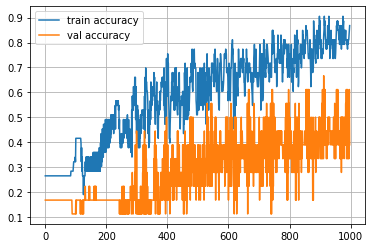

Epoch 998
Train accuracy: 0.8490566037735849
Val accuracy: 0.5555555555555556


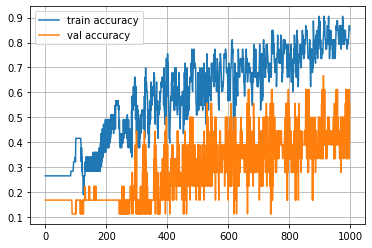

Epoch 999
Train accuracy: 0.9245283018867925
Val accuracy: 0.3888888888888889


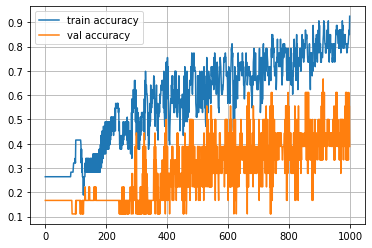

In [244]:
for epoch in range(1000):

    train(network,x_train_vec_sift,y_train)
    
    train_log.append(np.mean(predict(network,x_train_vec_sift)==y_train))
    val_log.append(np.mean(predict(network,x_test_vec_sift)==y_test))
    
    #clear_output()
    print("Epoch",epoch)
    print("Train accuracy:",train_log[-1])
    print("Val accuracy:",val_log[-1])
    plt.plot(train_log,label='train accuracy')
    
    plt.plot(val_log,label='val accuracy')
    plt.legend(loc='best')
    plt.grid()
    plt.show()
    